<a href="https://colab.research.google.com/github/Kinds-of-Intelligence-CFI/measurement-layout-tutorial/blob/main/tutorial-notebooks%20/5_LearningTheCapabilitiesOfLLMs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Learning the Capabilities of LLMs to Perform Addition

Here, we construct a measurement layout for the Addition dataset (not yet public).

The dataset includes the instance-level performance on simple addition tasks of 10 LLMs: `GPT-3 Ada`, `GPT-3 Babbage`, `GPT-3 Curie`, `GPT-3 Davinci`, `text-davinci-001`, `text-davinci-002`, `text-davinci-003`, `GPT-3.5-turbo`, `GPT-4-0314`, and `GPT-4-0613`.

The dataset contains the following columns:

- `instance_id`: ID of an instance.
- `template_id`: ID of a prompt template. Each addition prompt was phrased in 8 different ways.
- `llm`: The large language model tested.
- `prompt`: The actual prompt.
- `response`: The LLM's response.
- `summand1`: The first number to be added.
- `summand2`: The second number to be added.
- `target`: The correct sum of the two summands.
- `digits1`: The number of digits in the first summand.
- `digits2`: The number of digits in the second summand.
- `min_digits`: $min(digits_1, digits_2)$, i.e., the number of digits in the smaller summand.
- `harm_mean`: $2 / (1/digits_1 + 1/digits_2)$, i.e., the harmonic mean of the number of digits in the two summands.
- `art_mean`: $(digits_1 + digits_2) / 2$, i.e., the arithmetic mean of the number of digits in the two summands.
- `max_digits`: $max(digits_1, digits_2)$, i.e., the number of digits in the larger summand.
- `carry`: The number of carrying operations required to add the two numbers.
- `success`: Indicates whether the response is correct (1) or incorrect (0).

In [2]:
! pip install 'pymc>5.9' --quiet
! pip install 'numpyro' --quiet

In [3]:
! python --version

Python 3.10.12


In [4]:
import warnings

# Filter warnings for the specific library you want to suppress
warnings.filterwarnings("ignore", category=FutureWarning, module="sklearn")
warnings.filterwarnings("ignore", category=FutureWarning, module="seaborn")

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle
import pymc as pm
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, brier_score_loss, average_precision_score, f1_score
from xgboost import XGBClassifier
import xgboost as xgb
from sklearn.model_selection import train_test_split
from google.colab import files

print(f"Running on PyMC v{pm.__version__}")

Running on PyMC v5.10.4


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Define utility functions

In [8]:
# logistic function with standard parameters
def logistic(x, x0=0, c=0, k=1):
    """
    Generalized logistic function allowing to specify the center of the curve and the steepness.
    See at https://en.wikipedia.org/wiki/Generalised_logistic_function

    One can also include other parameters:
    :math:`y(x) = \frac{K}{(1+e^{-Bx})^{1/\nu}}`
    where K can be set so that the maximum value is 1 even if the domain of the parameter is bounded and
    $\nu$ dictates close to which asymptot maximum growth occurs. For now we keep them both fixed at 1

    :param x: The x value
    :param x0: The function is centred on x0 (where the probability is 0.5)
    :parm c: asymptotic minimum of the logistic function
    :param k: The slope (steepness) is k

    """
    # notice that you cannot use scipy advanced math here as this will be used by pymc. This may not be the most
    # efficient implementation
    return c + ((1 - c) / (1 + np.exp(-k * (x-x0))))

def logistic999(x, min, max):    # This logistic function ensures that if x is at -(max-min), we get prob 0.001, and if x is at (max-min), we get prob 0.999
  x = x - min
  max = max - min
  x = 6.90675478 * x / max
  return 1 / (1 + np.exp(-x))

# the margin is just the subtraction, assuming ability and demand are *in the same scale*
def margin(ability, demand):
    return ability - demand


def brierDecomp(preds, outs):
    brier = 1 / len(preds) * sum((preds - outs) ** 2)
    ## bin predictions
    bins = np.linspace(0, 1, 11)
    binCenters = (bins[:-1] + bins[1:]) / 2
    binPredInds = np.digitize(preds, binCenters)
    binnedPreds = bins[binPredInds]

    binTrueFreqs = np.zeros(10)
    binPredFreqs = np.zeros(10)
    binCounts = np.zeros(10)

    for i in range(10):
        idx = (preds >= bins[i]) & (preds < bins[i + 1])

        binTrueFreqs[i] = np.sum(outs[idx]) / np.sum(idx) if np.sum(idx) > 0 else 0
        binPredFreqs[i] = np.mean(preds[idx]) if np.sum(idx) > 0 else 0
        binCounts[i] = np.sum(idx)

    calibration = np.sum(binCounts * (binTrueFreqs - binPredFreqs) ** 2) / np.sum(binCounts) if np.sum(
        binCounts) > 0 else 0
    refinement = np.sum(binCounts * (binTrueFreqs * (1 - binTrueFreqs))) / np.sum(binCounts) if np.sum(
        binCounts) > 0 else 0
    return brier, calibration, refinement


# define generic function to evaluate a predictive method (such as LogisticRegression)
def evaluate_predictive_method(df_train, df_test, features_cols, response_col, predictive_method=LogisticRegression,
                               return_trained_method=False, compute_accuracy=False, trained_method=None, **kwargs):
    if len(features_cols) == 1 and type(df_train[features_cols[0]].iloc[0]) == np.ndarray:
        # if the features are already a numpy array, then don't convert to numpy array
        features_train = np.array(list(df_train[features_cols[0]].values))
        features_test = np.array(list(df_test[features_cols[0]].values))
    else:
        # traditional one
        features_train = df_train[features_cols].to_numpy()
        features_test = df_test[features_cols].to_numpy()

    if response_col in features_cols:
        raise ValueError("response_col must not be in features_cols")

    if trained_method is not None:
        method_instance = trained_method
    else:
        # fit logistic regression using training features and the agent col as response
        method_instance = predictive_method(**kwargs)
        method_instance.fit(features_train, df_train[response_col])

        #if predictive_method.__name__ == 'LogisticRegression':
        #  print(method_instance.coef_, method_instance.intercept_)

    # evaluate on the test set
    y_pred = method_instance.predict_proba(features_test)[:, 1]

    BrierScore, Calibration, Refinement = brierDecomp(y_pred, df_test[response_col])

    # compute the ROCAUC and PR-AUC
    if not (sum(df_test[response_col]) == 0 or sum(df_test[response_col]) == len(df_test)):
        roc_auc = roc_auc_score(df_test[response_col], y_pred)
    else:
        roc_auc = np.nan

    if compute_accuracy:
        # compute accuracy by thresholding at 0.5
        y_pred_binary = y_pred > 0.5
        accuracy = np.mean(y_pred_binary == df_test[response_col])

    return_list = [BrierScore, Calibration, Refinement, roc_auc]
    if compute_accuracy:
        return_list.append(accuracy)
    if return_trained_method:
        return_list.append(method_instance)
    return return_list

sns.set(style="whitegrid")

## Load and explore the Addition dataset

In [11]:
addition_data = pd.read_pickle('/content/drive/MyDrive/Colab Notebooks/Addition_data/addition_data_30.pkl')

In [12]:
addition_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32960 entries, 2 to 471014
Data columns (total 16 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   instance_id  32960 non-null  int64  
 1   template_id  32960 non-null  int64  
 2   llm          32960 non-null  object 
 3   prompt       32960 non-null  object 
 4   response     32960 non-null  object 
 5   summand1     32960 non-null  object 
 6   summand2     32960 non-null  object 
 7   target       32960 non-null  object 
 8   digits1      32960 non-null  int64  
 9   digits2      32960 non-null  int64  
 10  min_digits   32960 non-null  int64  
 11  harm_mean    32960 non-null  float64
 12  art_mean     32960 non-null  float64
 13  max_digits   32960 non-null  int64  
 14  carry        32960 non-null  float64
 15  success      32960 non-null  int64  
dtypes: float64(3), int64(7), object(6)
memory usage: 4.3+ MB


In [8]:
addition_data['llm'].unique()

array(['GPT-3 Ada', 'GPT-3 Babbage', 'GPT-3 Curie', 'GPT-3 Davinci',
       'text-davinci-001', 'text-davinci-002', 'text-davinci-003',
       'GPT-4-0314', 'GPT-3.5-turbo', 'GPT-4-0613'], dtype=object)

In [9]:
addition_data.groupby(['llm'])['success'].value_counts().unstack(fill_value=0)

success,0,1
llm,,
GPT-3 Ada,3286,10
GPT-3 Babbage,3272,24
GPT-3 Curie,3263,33
GPT-3 Davinci,3228,68
GPT-3.5-turbo,1989,1307
GPT-4-0314,2214,1082
GPT-4-0613,2117,1179
text-davinci-001,3139,157
text-davinci-002,2850,446


In [13]:
addition_data.describe()

,instance_id,template_id,digits1,digits2,min_digits,harm_mean,art_mean,max_digits,carry,success
count,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000
mean,1439.637621,8.500000,15.359223,16.148058,11.140777,13.401380,15.753641,20.366505,5.740291,0.144478
std,833.347137,4.153375,8.384815,8.696461,7.338968,7.473540,6.314904,7.058748,4.209165,0.351579
min,1.000000,3.000000,1.000000,1.000000,1.000000,1.333333,1.500000,2.000000,0.000000,0.000000
25%,750.000000,5.500000,8.000000,8.000000,5.000000,6.896552,11.000000,15.000000,2.000000,0.000000
50%,1392.000000,7.500000,16.000000,17.000000,10.000000,12.733251,16.000000,22.000000,5.000000,0.000000
75%,2141.000000,11.750000,22.000000,23.250000,17.000000,20.000000,21.000000,26.000000,9.000000,0.000000
max,3123.000000,15.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,20.000000,1.000000


In [14]:
addition_data.describe(include='object')

,llm,prompt,response,summand1,summand2,target
count,32960,32960,32960,32960,32960,32960
unique,10,3296,26575,389,380,412
top,GPT-3 Ada,The sum of 656050998910983832047 and 4871137 is,not even close to the sum of the sum of the s...,7020740700789054161494,2,656050998910988703184
freq,3296,10,93,240,400,80


In [15]:
for indx, prompt in enumerate(addition_data['prompt'][:8], start = 1):
  print(f'Template {indx}: {prompt}')

Template 1: The sum of 656050998910983832047 and 4871137 is
Template 2: Add: 656050998910983832047 + 4871137 =
Template 3: Make the addition of 656050998910983832047 and 4871137.
Template 4: By adding 656050998910983832047 and 4871137, the result is
Template 5: If you add 656050998910983832047 and 4871137, you get
Template 6: If you have 656050998910983832047 and 4871137, and you add them up, you get
Template 7: Find the value of x + y when x=656050998910983832047 and y=4871137.
Template 8: Imagine you have two numbers, 656050998910983832047 and 4871137, and you added them together. What number would you get?


### Plot aggregate accuracy

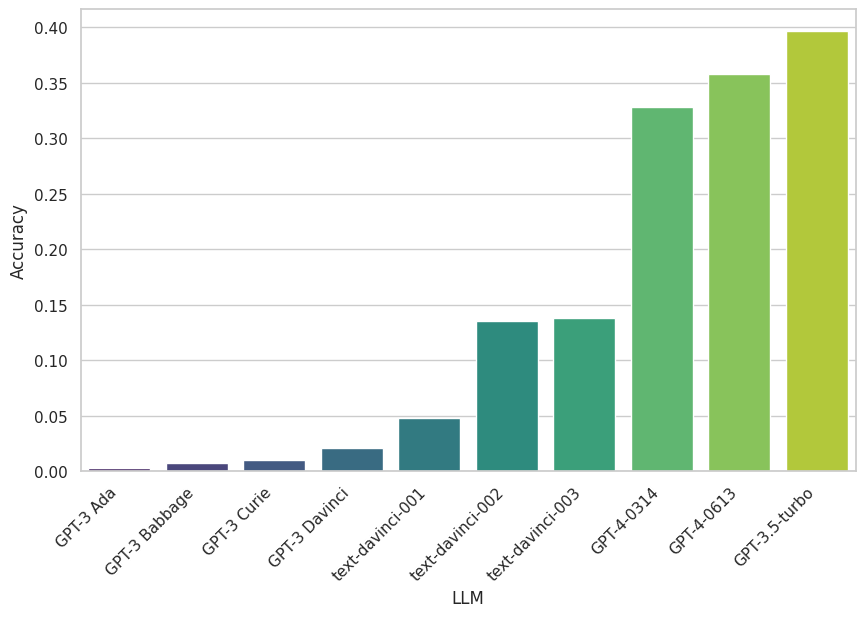

In [16]:
accuracy_data = addition_data.groupby('llm')['success'].mean().reset_index()

accuracy_data.rename(columns={'llm': 'LLM', 'success': 'Accuracy'}, inplace=True)
accuracy_data_sorted = accuracy_data.sort_values(by='Accuracy', ascending=True)

plt.figure(figsize=(10,6))
ax = sns.barplot(x='LLM', y='Accuracy', hue='LLM', data=accuracy_data_sorted, palette='viridis', legend=False)
plt.xticks(rotation=45, ha="right")
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/aggregate_accuracy.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

In [32]:
accuracy_data_sorted

,LLM,Accuracy
0,GPT-3 Ada,0.003034
1,GPT-3 Babbage,0.007282
2,GPT-3 Curie,0.010012
3,GPT-3 Davinci,0.020631
7,text-davinci-001,0.047633
8,text-davinci-002,0.135316
9,text-davinci-003,0.138350
5,GPT-4-0314,0.328277
6,GPT-4-0613,0.357706
4,GPT-3.5-turbo,0.396541


### Create new features

Here, we create new features. One feature calculates the standard deviation of the digits of each summand and sums them. The other feature takes the maximum of the two standard deviations. The motivation for introducing these features is that numbers with many repeating digits, such as 9999999 or 98989898, will most likely require carrying at each digit place, even though they may be very simple to add, especially if the other summand also has a low digit standard deviation, like 111111 or 13121312.

We also create new features by normalizing the number of carry operations with the harmonic mean, arithmetic mean, maximum digits, and minimum digits.

In [17]:
#Function to calculate the standard deviation of the digits in a summand
def num_sd(number:str):

  digits = [int(char) for char in number]

  return(np.std(digits))


In [18]:
# Calculate max and sum of digit standard deviations
addition_data['max_sd'] = addition_data.apply(lambda x: max(num_sd(x['summand1']), num_sd(x['summand2'])), axis=1)
addition_data['sum_sd'] = addition_data.apply(lambda x: num_sd(x['summand1']) + num_sd(x['summand2']), axis=1)

# Calculate ratio of carry and harmonic mean columns
addition_data['carry_harm_mean_ratio'] = addition_data['carry'] / addition_data['harm_mean']
addition_data['carry_art_mean_ratio'] = addition_data['carry'] / addition_data['art_mean']
addition_data['carry_to_length_longer'] = addition_data['carry'] / addition_data['max_digits']
addition_data['carry_to_length_shorter'] = addition_data['carry'] / addition_data['min_digits']


In [19]:
addition_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32960 entries, 2 to 471014
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   instance_id              32960 non-null  int64  
 1   template_id              32960 non-null  int64  
 2   llm                      32960 non-null  object 
 3   prompt                   32960 non-null  object 
 4   response                 32960 non-null  object 
 5   summand1                 32960 non-null  object 
 6   summand2                 32960 non-null  object 
 7   target                   32960 non-null  object 
 8   digits1                  32960 non-null  int64  
 9   digits2                  32960 non-null  int64  
 10  min_digits               32960 non-null  int64  
 11  harm_mean                32960 non-null  float64
 12  art_mean                 32960 non-null  float64
 13  max_digits               32960 non-null  int64  
 14  carry                

In [17]:
addition_data.describe()

,instance_id,template_id,digits1,digits2,min_digits,harm_mean,art_mean,max_digits,carry,success,max_sd,sum_sd,carry_harm_mean_ratio,carry_art_mean_ratio,carry_to_length_longer,carry_to_length_shorter
count,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000,32960.000000
mean,1439.637621,8.500000,15.359223,16.148058,11.140777,13.401380,15.753641,20.366505,5.740291,0.144478,2.917900,5.138604,0.393176,0.333707,0.276534,0.509817
std,833.347137,4.153375,8.384815,8.696461,7.338968,7.473540,6.314904,7.058748,4.209165,0.351579,0.367614,1.011162,0.181267,0.182761,0.177347,0.249742
min,1.000000,3.000000,1.000000,1.000000,1.000000,1.333333,1.500000,2.000000,0.000000,0.000000,0.816497,0.816497,0.000000,0.000000,0.000000,0.000000
25%,750.000000,5.500000,8.000000,8.000000,5.000000,6.896552,11.000000,15.000000,2.000000,0.000000,2.728743,4.785051,0.285189,0.200000,0.133333,0.400000
50%,1392.000000,7.500000,16.000000,17.000000,10.000000,12.733251,16.000000,22.000000,5.000000,0.000000,2.919854,5.385416,0.410256,0.333333,0.272727,0.500000
75%,2141.000000,11.750000,22.000000,23.250000,17.000000,20.000000,21.000000,26.000000,9.000000,0.000000,3.099899,5.806694,0.530303,0.465116,0.400000,0.666667
max,3123.000000,15.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,20.000000,1.000000,4.500000,7.362210,1.066667,0.800000,0.777778,2.000000


In [18]:
addition_data.describe(include='object')

,llm,prompt,response,summand1,summand2,target
count,32960,32960,32960,32960,32960,32960
unique,10,3296,26575,389,380,412
top,GPT-3 Ada,The sum of 656050998910983832047 and 4871137 is,not even close to the sum of the sum of the s...,7020740700789054161494,2,656050998910988703184
freq,3296,10,93,240,400,80


### Scale the data

We now scale the data using min-max normalization, which performs a linear transformation of the data to the $(0,1)$ range. This is generally a good practice when the features are on different scales. Later, when we build a measurement layout, this will allow us to have all the variables on the same scale and improve interpretation.

In [20]:
from sklearn.preprocessing import MinMaxScaler

columns_to_scale = ['min_digits','harm_mean', 'art_mean', 'max_digits', 'carry',
                    'max_sd', 'sum_sd', 'carry_art_mean_ratio', 'carry_harm_mean_ratio', 'carry_to_length_longer', 'carry_to_length_shorter']

scaler = MinMaxScaler()

# Apply MinMaxScaler to the selected columns and create new columns for the scaled data
scaled_columns = scaler.fit_transform(addition_data[columns_to_scale])

# Add the scaled columns to the DataFrame with new column names
for i, col in enumerate(columns_to_scale):
    addition_data[col + '_scaled'] = scaled_columns[:, i]


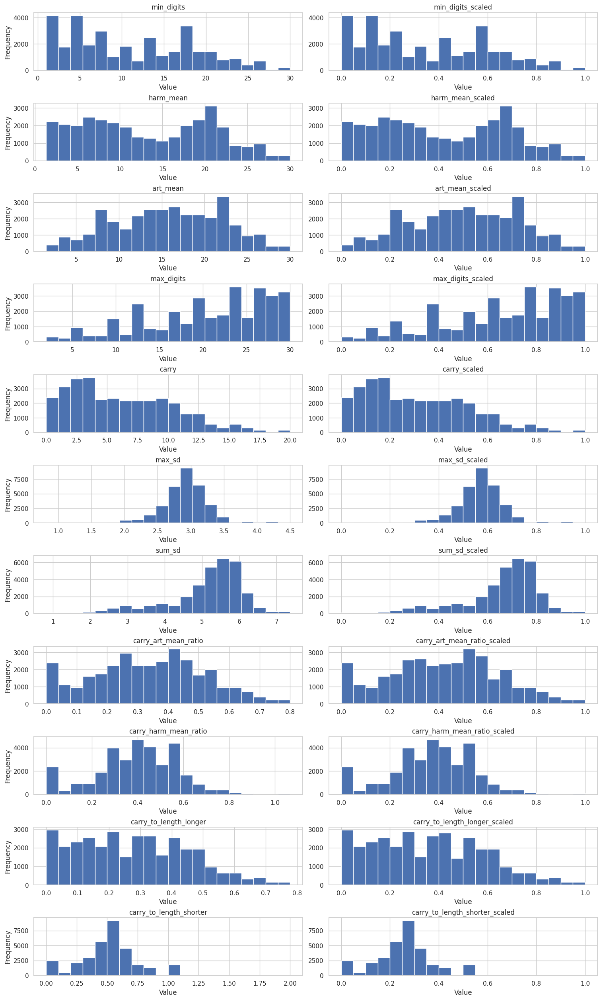

In [21]:
columns_to_plot_original = [
    'min_digits', 'harm_mean', 'art_mean', 'max_digits', 'carry',
    'max_sd', 'sum_sd', 'carry_art_mean_ratio', 'carry_harm_mean_ratio', 'carry_to_length_longer',
    'carry_to_length_shorter'
]

columns_to_plot_scaled = [col + '_scaled' for col in columns_to_plot_original]

# Adjusting the number of rows and columns for the subplot grid
n_rows = len(columns_to_plot_original)
n_cols = 2  # One for original and one for scaled

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 25),layout="constrained")

for i in range(n_rows):
    # Plot original data
    ax_orig = axes[i, 0]
    ax_orig.hist(addition_data[columns_to_plot_original[i]], bins=20)
    ax_orig.set_title(columns_to_plot_original[i])
    ax_orig.set_xlabel('Value')
    ax_orig.set_ylabel('Frequency')

    # Plot scaled data
    ax_scaled = axes[i, 1]
    ax_scaled.hist(addition_data[columns_to_plot_scaled[i]], bins=20)
    ax_scaled.set_title(columns_to_plot_scaled[i])
    ax_scaled.set_xlabel('Value')


plt.show()


### Correlations between the features and success on the task

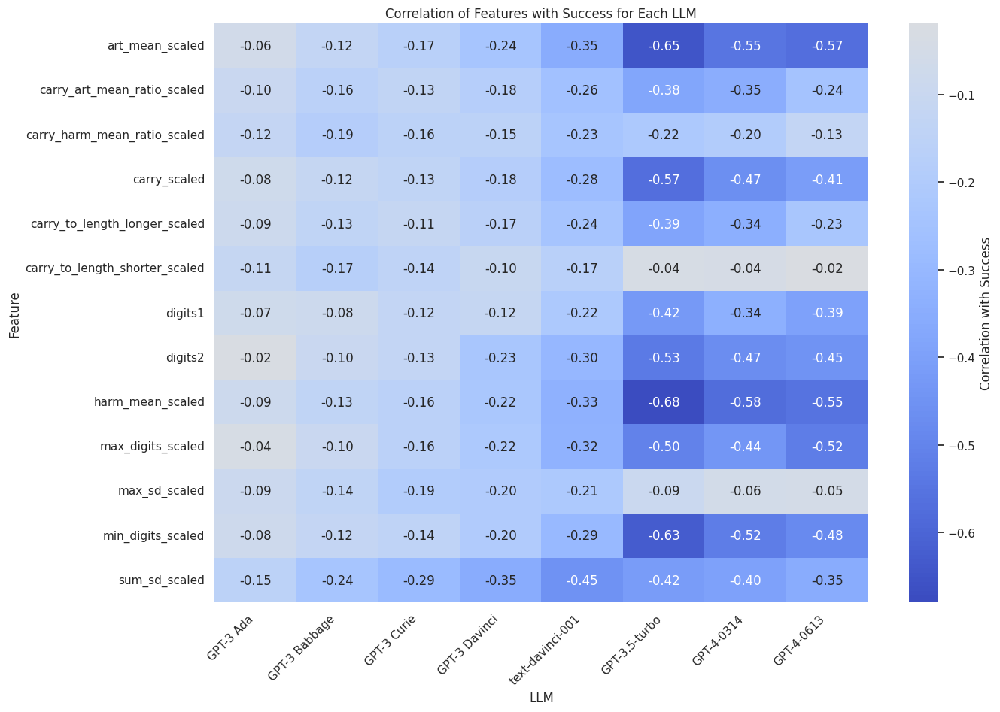

In [21]:
feats = ['digits1', 'digits2', 'min_digits_scaled', 'harm_mean_scaled', 'art_mean_scaled', 'max_digits_scaled', 'carry_scaled',\
          'max_sd_scaled','sum_sd_scaled','carry_art_mean_ratio_scaled','carry_harm_mean_ratio_scaled', 'carry_to_length_longer_scaled',\
          'carry_to_length_shorter_scaled']

correlations = []
llms = addition_data['llm'].unique()

for llm in llms:
    llm_data = addition_data[addition_data['llm'] == llm]
    for feat in feats:
        corr = llm_data[[feat, 'success']].corr().iloc[0, 1]  # Get correlation between feature and success
        correlations.append({'LLM': llm, 'Feature': feat, 'Correlation': corr})


corr_df = pd.DataFrame(correlations)

# Define the custom order for LLMs
llm_order = ['GPT-3 Ada', 'GPT-3 Babbage', 'GPT-3 Curie', 'GPT-3 Davinci',
             'text-davinci-001', 'text-davinci-002, text-davinci-003',
             'GPT-3.5-turbo', 'GPT-4-0314', 'GPT-4-0613']

# Convert the 'LLM' column to a categorical type with the specified order
corr_df['LLM'] = pd.Categorical(corr_df['LLM'], categories=llm_order, ordered=True)

pivot_df = corr_df.pivot_table(index="Feature", columns="LLM", values="Correlation")

plt.figure(figsize=(14, 10))
sns.heatmap(pivot_df, annot=True, fmt=".2f", cmap="coolwarm", center=0, cbar_kws={'label': 'Correlation with Success'})
plt.title('Correlation of Features with Success for Each LLM')
plt.xticks(rotation=45, ha="right")
plt.yticks(rotation=0)
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/correlations_success.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()


From the above, we observe that success is negatively correlated with all the features. This suggests that a higher value of a feature is associated with greater demands for a language model.

We find little correlation between the features and success from GPT-3 Ada, GPT-3 Babbage, GPT-3 Curie, and GPT-3 Davinci. However, we observe moderate to strong correlations between the features (especially `harm_mean_scaled`, `carry_scaled`, and `sd_sum_scaled`) and success for all other LLMs.

Below we plot correlations between all the features.

In [22]:
feats = ['digits1', 'digits2', 'min_digits_scaled', 'harm_mean_scaled', 'art_mean_scaled', 'max_digits_scaled', 'carry_scaled',\
          'max_sd_scaled','sum_sd_scaled','carry_art_mean_ratio_scaled','carry_harm_mean_ratio_scaled', 'carry_to_length_longer_scaled',\
          'carry_to_length_shorter_scaled','success']

llms = addition_data['llm'].unique()

# do this for each llm
correlation_df = pd.DataFrame()
all_corrs = {}
for llm in llms:
    corr = addition_data[addition_data['llm'] == llm][feats].corr()
    all_corrs[llm] = corr

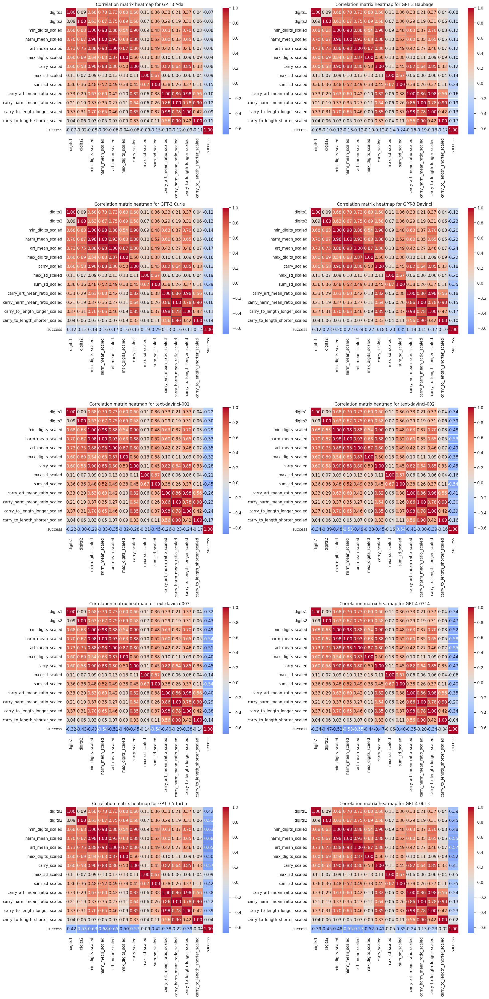

In [23]:
n_llms = len(llms)
ncols = 2
nrows = n_llms // ncols + (n_llms % ncols > 0)

global_min = min(all_corrs[llm].min().min() for llm in llms)
global_max = max(all_corrs[llm].max().max() for llm in llms)

plt.figure(figsize=(ncols * 10, nrows * 8))

# Loop through each LLM
for index, llm in enumerate(llms):
    plt.subplot(nrows, ncols, index + 1)

    # Create the heatmap
    sns.heatmap(all_corrs[llm], annot=True, fmt=".2f", cmap="coolwarm", center = 0, vmin=global_min, vmax=global_max,linewidths=0.5)
    plt.title(f"Correlation matrix heatmap for {llm}")

    if index == 0:  # Adjust this condition to target the figure you want to save
        plt.savefig(f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/correlations_all_{llm}.png", dpi=300,bbox_inches='tight')

plt.tight_layout()
plt.show()

Here we find that size-related features are correlated as are the carry-related ones. However, within each cluster, certain features show less correlation with those from another cluster, for example, `sum_sd_scaled`, `harm_mean_scaled`, `carry_art_mean_ratio_scaled`. Here we go for the normalized `carry_scaled` variable as `carry_scaled` itself is highly correlated with other size features.

Below we plot histograms of successes and failures for each meta-feature and for each LLM. These plots will provide us with information on the discriminative power of each feature with respect to success in the task.

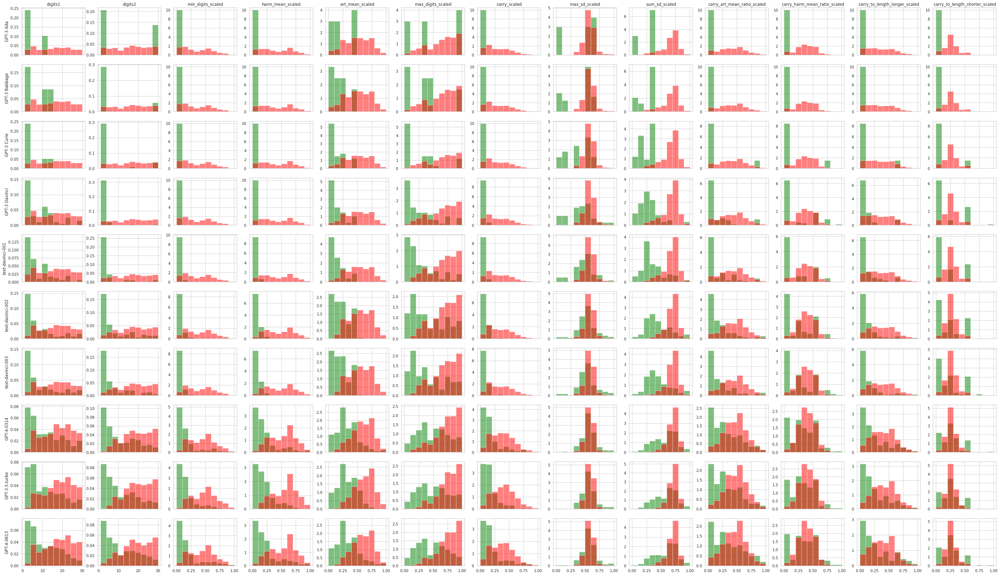

In [24]:
feats = ['digits1', 'digits2', 'min_digits_scaled', 'harm_mean_scaled', 'art_mean_scaled', 'max_digits_scaled', 'carry_scaled',\
          'max_sd_scaled','sum_sd_scaled','carry_art_mean_ratio_scaled','carry_harm_mean_ratio_scaled', 'carry_to_length_longer_scaled',\
          'carry_to_length_shorter_scaled']

fig, axes = plt.subplots(len(llms), len(feats), figsize=(4 * len(feats), 3 * len(llms)), sharex="col")

for i, llm in enumerate(llms):
    merged_df_success = addition_data[(addition_data['success'] == 1) & (addition_data['llm'] == llm)]
    merged_df_fail = addition_data[(addition_data['success'] == 0) & (addition_data['llm'] == llm)]
    for j, feat in enumerate(feats):
        bins = np.histogram(np.hstack((merged_df_success[feat], merged_df_fail[feat])), bins=10)[1]
        axes[i, j].hist(merged_df_success[feat], density=True, alpha=0.5, facecolor='green', label="Success", bins=bins)
        axes[i, j].hist(merged_df_fail[feat], density=True, alpha=0.5, facecolor='red', label="Fail", bins=bins)
        axes[0, j].set_title(feat)
    axes[i, 0].set_ylabel(llm)
plt.show()

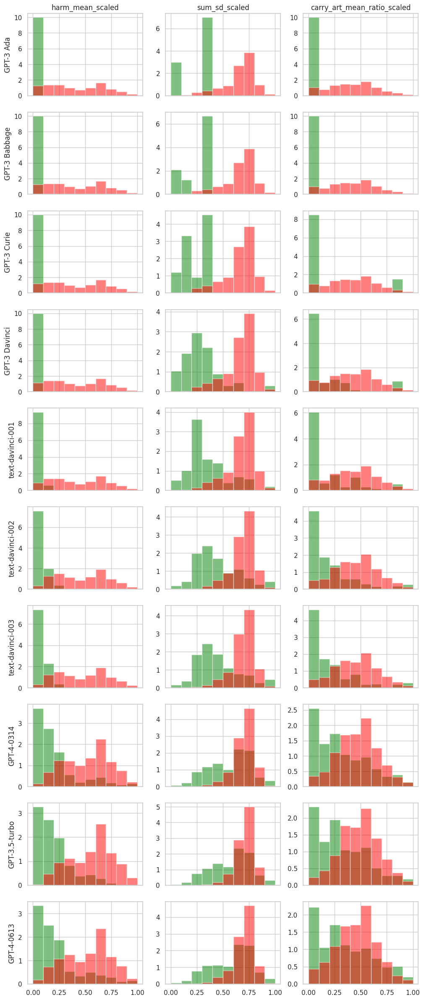

In [25]:
feats = ['harm_mean_scaled','sum_sd_scaled','carry_art_mean_ratio_scaled']

fig, axes = plt.subplots(len(llms), len(feats), figsize=(4 * len(feats), 3 * len(llms)), sharex="col")

for i, llm in enumerate(llms):
    merged_df_success = addition_data[(addition_data['success'] == 1) & (addition_data['llm'] == llm)]
    merged_df_fail = addition_data[(addition_data['success'] == 0) & (addition_data['llm'] == llm)]
    for j, feat in enumerate(feats):
        bins = np.histogram(np.hstack((merged_df_success[feat], merged_df_fail[feat])), bins=10)[1]
        axes[i, j].hist(merged_df_success[feat], density=True, alpha=0.5, facecolor='green', label="Success", bins=bins)
        axes[i, j].hist(merged_df_fail[feat], density=True, alpha=0.5, facecolor='red', label="Fail", bins=bins)
        axes[0, j].set_title(feat)
    axes[i, 0].set_ylabel(llm)
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/feat_disc_ability.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

Given the above, `harm_mean` (the harmonic mean of the number of digits in the two numbers), `carry_art_mean_ratio` (the ratio between the number of carry operations required to add the two numbers and the arithmetic mean of the number of digits in the two numbers), and `sd_sum` (the sum of the standard deviations of the digits in the two numbers) may be good choices for predicting success in the task.

Here, we choose `carry_art_mean_ratio` instead of `carry` (the number of carrying operations) since carry is highly correlated with the size-related features (which is expected) and `carry_art_mean_ratio` account for the number size.

## Common Predictive Models

In this section, we construct two commonly used predictive models—Logistic Regression and XGBoost—alongside several standard baseline models. These will be used to compare the predictive performance of the measurement layout.

First, we divide the dataset into two parts: a training set and a test set.

In [22]:
# Function to split data into train and test
def split_data(df, test_size=0.2):
    return train_test_split(df, test_size=test_size, random_state=42)

In [23]:
# Dictionaries to hold the training and test data
llms = addition_data['llm'].unique()
train_dict = {}
test_dict = {}

# Split data for each LLM
for llm in llms:
    # Filter data for the current LLM
    llm_data = addition_data[addition_data['llm'] == llm]

    # Split the data into training and test sets
    train, test = train_test_split(llm_data, test_size=0.2)  # Adjust test_size as needed

    # Store the split data in the dictionaries
    train_dict[llm] = train
    test_dict[llm] = test


Print the size of the training and test sets.

Note: As the dataset is imbalanced, it's important to print the value counts for the test set to ensure there are at least a few instances for each label, i.e., success (1) and failure (0). If any of the labels has no instances, we won't be able to calculate some metrics, such as AUROC.

In [24]:
for llm in llms:
    train_size = len(train_dict[llm])
    test_size = len(test_dict[llm])

    success_counts = test_dict[llm]['success'].value_counts().to_string()

    print(f"{llm}:")
    print(f"  Train size: {train_size}")
    print(f"  Test size: {test_size}")
    print(f"  Test set success counts:\n{success_counts}\n")

GPT-3 Ada:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    659
1      1

GPT-3 Babbage:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    656
1      4

GPT-3 Curie:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    652
1      8

GPT-3 Davinci:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    646
1     14

text-davinci-001:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    627
1     33

text-davinci-002:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    571
1     89

text-davinci-003:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    569
1     91

GPT-4-0314:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    450
1    210

GPT-3.5-turbo:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    389
1    271

GPT-4-0613:
  Train size: 2636
  Test size: 660
  Test set success counts:
0    421
1    239



### Refresher: Brier score, AUROC, PR-AUC
- **Brier score**: This is the mean squared error applied to probabilities. It calculates the squared difference between the probability of success for a task and whether the LLM actually succeeded on the tasks (represented as 1 for success and 0 for failure). It measures the accuracy of probabilistic predictions.
  - The Brier score can be decomposed into two components:
    - *Calibration score*: This measures the extent to which the observed frequency of success in a group of events, all assigned the same probability $p$, differs from that probability $p$.
    - *Refinement score*: This measures the uniformity of successes and failures within a group of events assigned the same probability $p$.
- **AUROC** (Area Under the Receiver Operating Characteristic curve): This metric is used to evaluate the performance of a binary classifier system as the classification threshold is varied. ROC curve plots the true positive rate against the false positive rate for each classification threshold. AUROC is the area under that curve.
 - It's the probability a randomly-chosen positive example is ranked more highly than a randomly chosen negative example. It's a measure of correct ordering of the classification.

 AUROC vs Brier score example (taken from [here](https://medium.com/@penggongting/understanding-roc-auc-pros-and-cons-why-is-bier-score-a-great-supplement-c7a0c976b679)):



 Assume a classifier predicts these probabilities \[0.5, 0.3, 0.8, 0.4, 0.2\] and the actual outcomes were \[0, 1, 1, 0, 0\]. Let's load this into a data frame.


In [37]:
df_example = pd.DataFrame({'Y_pred': [0.5, 0.3, 0.8, 0.4, 0.2], 'Y_actual':[0, 1, 1, 0, 0]})

#Let's sort the data by Y_pred
df_example.sort_values(by='Y_pred',ascending = False)

,Y_pred,Y_actual
2,0.8,1
0,0.5,0
3,0.4,0
1,0.3,1
4,0.2,0


What AUROC outputs is the probability that any of the randomly chosen 1's appears above a 0 in the above sorted data frame. There are 3 zeros and 2 ones = 6 pairs of 1s and 0s. In the above example the top 1 appears higher than all three 0s and the next 1 appears higher in rank than only one of the 0s. So AUROC is 4/6, i.e. 0.667.

Using the `roc_auc_score` function from `sklearn`  we get the same result:

In [38]:
example_roc_auc = roc_auc_score(df_example['Y_actual'], df_example['Y_pred'])
example_roc_auc

0.6666666666666667

In [39]:
#Let's also calculate the brier score
example_brier_score = brier_score_loss(df_example['Y_actual'], df_example['Y_pred'])
example_brier_score

0.196

Let's now change the prediction probabilities, but keep the order!

In [40]:
df_example_new = pd.DataFrame({'Y_pred': [0.97, 0.5, 0.99, 0.9, 0.01], 'Y_actual':[0, 1, 1, 0, 0]})

#Let's sort the data by Y_pred
df_example_new.sort_values(by='Y_pred',ascending = False)

,Y_pred,Y_actual
2,0.99,1
0,0.97,0
3,0.90,0
1,0.50,1
4,0.01,0


In [41]:
example_roc_auc_new = roc_auc_score(df_example_new['Y_actual'], df_example_new['Y_pred'])
example_roc_auc_new

0.6666666666666667

The AUROC is exactly the same! However, the Brier score is very different:

In [42]:
example_brier_score_new = brier_score_loss(df_example_new['Y_actual'], df_example_new['Y_pred'])
example_brier_score_new

0.40022000000000013

So in short, AUROC indicates how well the classifier has ranked the predictions. The Brier Score tells us how accurate those probabilistic predictions are.

### Train the assessors: logistic regression and XBGboost model and add baselines

In [29]:
list_features = ['harm_mean_scaled','sum_sd_scaled','carry_art_mean_ratio_scaled']

predictive_methods_df = pd.DataFrame()
for predictive_method in [LogisticRegression, XGBClassifier]:
    for llm in llms:
        print(f"{predictive_method.__name__} for {llm}")
        df_train = train_dict[llm]  # default training set
        df_test = test_dict[llm]  # default test set

        BrierScore, Calibration, Refinement, roc_auc, trained_method = evaluate_predictive_method(df_train, df_test,
                                                                                                  list_features,
                                                                                                  "success",
                                                                                                  predictive_method=predictive_method,
                                                                                                  return_trained_method=True,
                                                                                                  compute_accuracy=False)





        predictive_methods_df = pd.concat([predictive_methods_df, pd.DataFrame(
            {"predictive_method": predictive_method.__name__, "llm": llm, "BrierScore": BrierScore,
             "Calibration": Calibration, "Refinement": Refinement, "AUROC": roc_auc, "trained_method": trained_method},
            index=[0])])

        for baseline in ["always_1", "always_0", "average_success_on_train"]:
            if baseline == "always_1": #this baseline predicts success (1) with probability 1 for each instance
                predictions = np.ones(len(df_test))
            elif baseline == "always_0": #this baseline predicts success (1) with probability 0 for each instance
                predictions = np.zeros(len(df_test))
            elif baseline == "average_success_on_train": #this baseline predicts success (1) with the average probability of success on the training sets for each instance
                predictions = np.ones(len(df_test)) * df_train["success"].mean()
            else:
                raise ValueError("baseline not recognized")

            BrierScore, Calibration, Refinement = brierDecomp(predictions, df_test["success"])
            roc_auc = roc_auc_score(df_test["success"], predictions)
            predictive_methods_df = pd.concat([predictive_methods_df, pd.DataFrame(
                {"predictive_method": baseline, "llm": llm, "BrierScore": BrierScore, "Calibration": Calibration,
                  "Refinement": Refinement, "AUROC": roc_auc,}, index=[0])])

LogisticRegression for GPT-3 Ada
LogisticRegression for GPT-3 Babbage
LogisticRegression for GPT-3 Curie
LogisticRegression for GPT-3 Davinci
LogisticRegression for text-davinci-001
LogisticRegression for text-davinci-002
LogisticRegression for text-davinci-003
LogisticRegression for GPT-4-0314
LogisticRegression for GPT-3.5-turbo
LogisticRegression for GPT-4-0613
XGBClassifier for GPT-3 Ada
XGBClassifier for GPT-3 Babbage
XGBClassifier for GPT-3 Curie
XGBClassifier for GPT-3 Davinci
XGBClassifier for text-davinci-001
XGBClassifier for text-davinci-002
XGBClassifier for text-davinci-003
XGBClassifier for GPT-4-0314
XGBClassifier for GPT-3.5-turbo
XGBClassifier for GPT-4-0613


In [30]:
# Filter for rows where predictive_method is either XGBClassifier or LogisticRegression
filtered_df = predictive_methods_df[
    predictive_methods_df['predictive_method'].isin(['XGBClassifier', 'LogisticRegression'])
]

# Select specific columns and sort by BrierScore
result_df = filtered_df[['predictive_method', 'llm', 'AUROC', 'BrierScore', 'Calibration', 'Refinement']].sort_values(by="llm")
result_df

,predictive_method,llm,AUROC,BrierScore,Calibration,Refinement
0,LogisticRegression,GPT-3 Ada,0.979483,0.002960,3.096395e-10,0.003021
0,XGBClassifier,GPT-3 Ada,0.994681,0.002687,7.523117e-04,0.001818
0,LogisticRegression,GPT-3 Babbage,0.987995,0.005235,5.416921e-04,0.004839
0,XGBClassifier,GPT-3 Babbage,0.996380,0.004014,1.234538e-03,0.002778
0,LogisticRegression,GPT-3 Curie,0.980154,0.013342,1.154159e-03,0.013450
0,XGBClassifier,GPT-3 Curie,1.000000,0.005978,5.079901e-03,0.001010
0,LogisticRegression,GPT-3 Davinci,0.973020,0.018941,2.006170e-03,0.017507
0,XGBClassifier,GPT-3 Davinci,0.983162,0.016949,3.173966e-03,0.014126
0,LogisticRegression,GPT-3.5-turbo,0.914182,0.114500,6.302361e-03,0.108340
0,XGBClassifier,GPT-3.5-turbo,0.948334,0.089176,4.615177e-03,0.084350


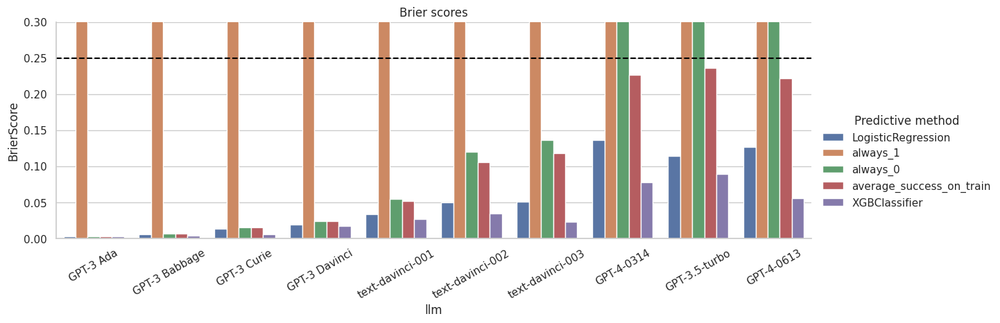

In [31]:
g = sns.catplot(x="llm", y="BrierScore", hue="predictive_method", data=predictive_methods_df, kind="bar", height=4, aspect=3, legend_out=True)
plt.ylim(0, .3)
plt.axhline(y=0.25, color='black', linestyle='--')
plt.title("Brier scores")
plt.xticks(rotation=30)
g._legend.set_title('Predictive method')
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/brier_scores_assessors.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

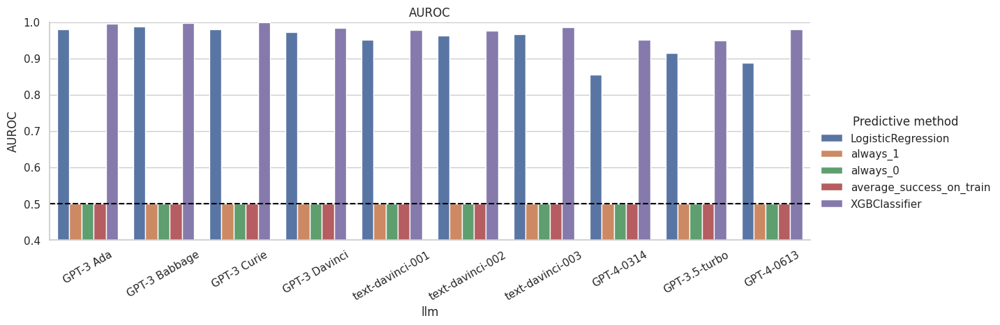

In [32]:
g = sns.catplot(x="llm", y="AUROC", hue="predictive_method", data=predictive_methods_df, kind="bar", height=4, aspect=3,legend_out=True)
plt.ylim(0.4, 1)
plt.axhline(y=0.5, color='black', linestyle='--')
plt.title("AUROC")
plt.xticks(rotation=30)
g._legend.set_title('Predictive method')
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/auroc_scores_assessors.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

## Measurment layout

In [25]:
def predict(m, trace, relevantData):
  with m:

    predictions = pm.sample_posterior_predictive(trace, var_names=["taskPerformance"], return_inferencedata=False,predictions=True,extend_inferencedata=False)
    predictionChainRuns = predictions["taskPerformance"][:,:,0:len(relevantData)]
    predictionsInstance = np.mean(predictionChainRuns, (0,1))

    return predictionsInstance

In [26]:
def process_predictive_data_and_plot_histogram(predictive_data, predictive_type:str,save = False):
    # Convert to DataFrames and calculate mean directly
    if predictive_type == 'prior':
        predictive_mean = predictive_data.prior_predictive["taskPerformance"].to_dataframe().groupby('draw').mean()
    elif predictive_type == 'posterior':
        predictive_mean = predictive_data.posterior_predictive["taskPerformance"].to_dataframe().groupby('draw').mean()
    else:
        raise ValueError("predictive_type must be 'prior' or 'posterior'")

    # Get observed
    observed = predictive_data.observed_data.to_dataframe().mean().values[0]

    # Get simulated mean
    simulated_mean = predictive_mean['taskPerformance'].mean()


    # Plotting
    plt.figure(figsize=(8, 6))
    # Histogram of predictive means
    sns.histplot(predictive_mean['taskPerformance'], kde=True, stat='density', edgecolor='black', bins=20) #color='skyblue'

    #Vertical line for observed data
    plt.axvline(x=observed, color='red', linestyle='--', linewidth=2, label='Observed')
    #Vertical line for the mean of simulated data
    plt.axvline(x=simulated_mean, color='blue', linestyle='-', linewidth=2, label='Simulated')


    plt.xlabel('Task Performance')
    plt.ylabel('Density')
    plt.title(f'{predictive_type.capitalize()} Predictive Task Performance Distribution: {LLM}')
    plt.legend()
    plt.xlim(0, 1)
    if save:
      filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/{predictive_type}_predictive_{LLM}.png"
      plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

Below we visualise the different logistics

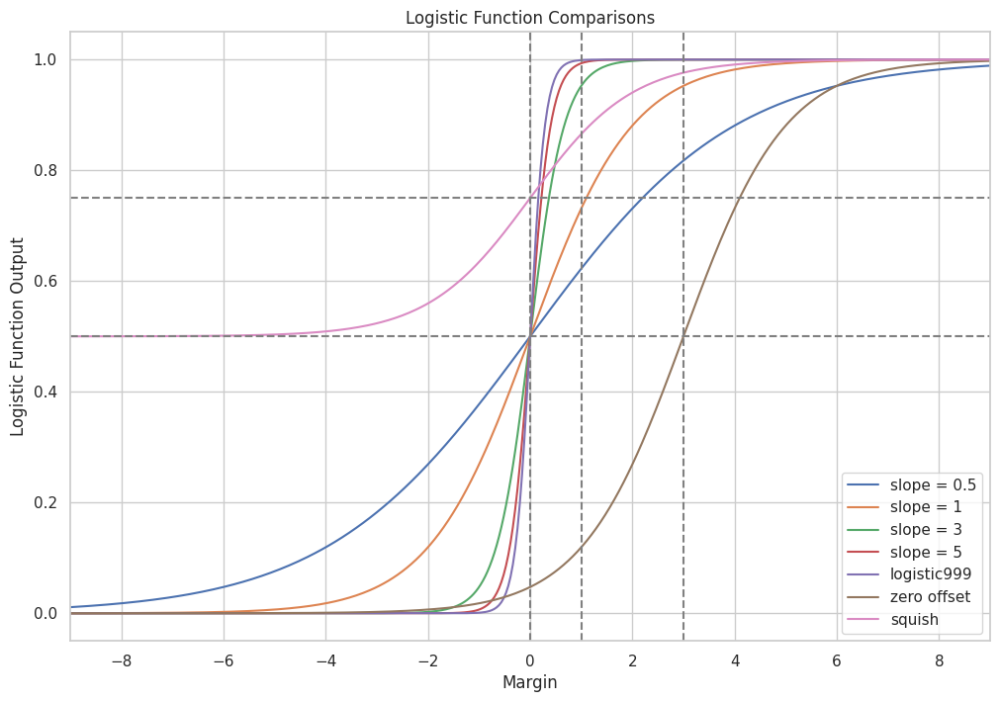

In [49]:
x_values = np.linspace(-9, 9, 400)
y_05 = logistic(x_values, k = 0.5)
y_1 = logistic(x_values, k = 1)
y_3 = logistic(x_values, k = 3)
y_5 = logistic(x_values, k = 5)
y_logistic999 = logistic999(x_values, min = 0, max = 1)
y_off_center = logistic(x_values, x0 = 3)
y_squish = logistic(x_values, c = 0.5)

plt.figure(figsize=(12, 8))
sns.lineplot(x=x_values, y=y_05, label='slope = 0.5')
sns.lineplot(x=x_values, y=y_1, label='slope = 1')
sns.lineplot(x=x_values, y=y_3, label='slope = 3')
sns.lineplot(x=x_values, y=y_5, label='slope = 5')
sns.lineplot(x=x_values, y=y_logistic999, label='logistic999')
sns.lineplot(x=x_values, y=y_off_center, label='zero offset')
sns.lineplot(x=x_values, y=y_squish, label='squish')

plt.xlim(-9, 9)
plt.axhline(0.5, color='gray', linestyle='--')  # Horizontal line at y=0.5
plt.axhline(0.75, color='gray', linestyle='--')
plt.axvline(0, color='gray', linestyle='--')
plt.axvline(1, color='gray', linestyle='--')
plt.axvline(3, color='gray', linestyle='--')

plt.title('Logistic Function Comparisons')
plt.xlabel('Margin')
plt.ylabel('Logistic Function Output')
plt.legend()
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/sigmoids.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

### Define the Bayesian model

In [31]:
def setupSumModel(data):

  m = pm.Model()
  with m:

    # Define abilities and their priors
    sizeAbility = pm.Beta("sizeAbility", 1,1)
    carryAbility = pm.Beta("carryAbility", 1,1)
    digitVarietyAbility = pm.Beta("digitVarietyAbility", 1,1)

    # Define environment variables as MutableData
    digitsMean = pm.MutableData("digitsMean", data['harm_mean_scaled'].values)
    ratioCarry = pm.MutableData("ratioCarry", data['carry_art_mean_ratio_scaled'].values)
    sumSD = pm.MutableData("sumSD", data['sum_sd_scaled'].values)

    # Margins / partial performance
    sizePerformance = pm.Deterministic("sizePerformance", logistic999(margin(sizeAbility,digitsMean), min = 0, max = 1))
    carryPerformance = pm.Deterministic("carryPerformance", logistic999(margin(carryAbility,ratioCarry), min = 0, max = 1))
    digitVarietyPerformance = pm.Deterministic("digitVarietyPerformance", logistic999(margin(digitVarietyAbility,sumSD), min=0, max=1))

    #Non-compensatory interaction
    perfList = [sizePerformance,carryPerformance,digitVarietyPerformance]
    finalPerformance =  np.prod(perfList)

    taskPerformance = pm.Bernoulli("taskPerformance", finalPerformance, observed = data['success'])

  return m

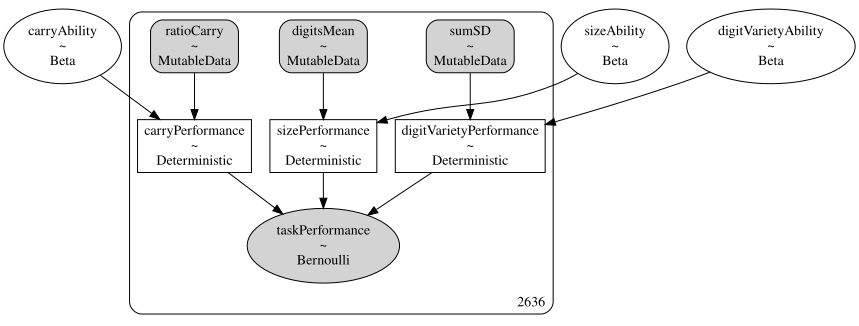

In [54]:
LLM = 'GPT-3.5-turbo'

model = setupSumModel(train_dict[LLM])
g = pm.model_to_graphviz(model)
g.render(filename='/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/mes_layout', format='png')
g

#### Prior predictive check

Given the priors we've chosen and the meta-features (demands), we generate the data : first we simulate the parameters according to the priors

$$θ^{sim} \sim p(θ),$$

then we simulate the data acording to the sampling distributions given the simulated parameters:

$$y^{sim} \sim p(y | \theta^{sim}).$$

In other words, given the prior distributions of the parameters (abilities) we simulate the data, i.e. `taskPerformance` (see more [here](https://mc-stan.org/docs/2_26/stan-users-guide/prior-predictive-checks.html)). This way we explore whether the simulated data covers the range of the observed data which can tell us which priors are consistent with the data and can help us decide which priors to choose.

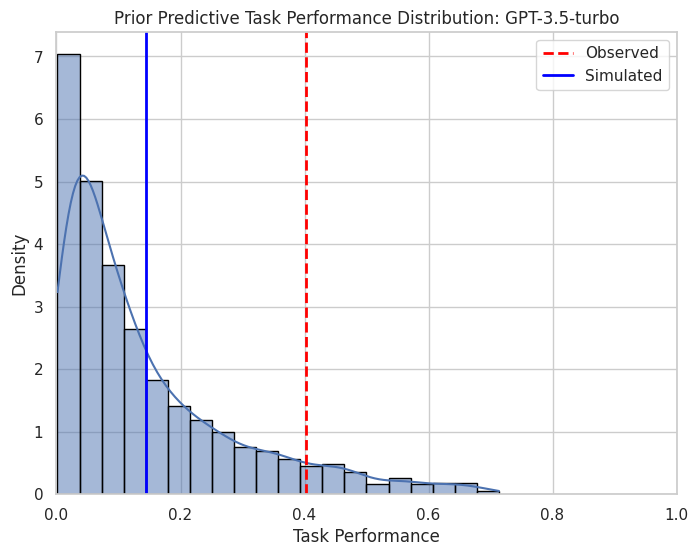

In [ ]:
with model:
    prior_predictive = pm.sample_prior_predictive(samples=2_000)

process_predictive_data_and_plot_histogram(prior_predictive,'prior',save=True)

#### Draw samples from the posterior

In [55]:
with model:
  trace = pm.sample(nuts_sampler="numpyro", draws = 10000, tune = 2000, target_accept=0.99, chains=4)

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

#### Posterior predictive check

Just like prior predictive checks, where data is simulated from the prior distributions, in this case, data is simulated from the posterior distributions. This tells us how well the model fits the observed data.

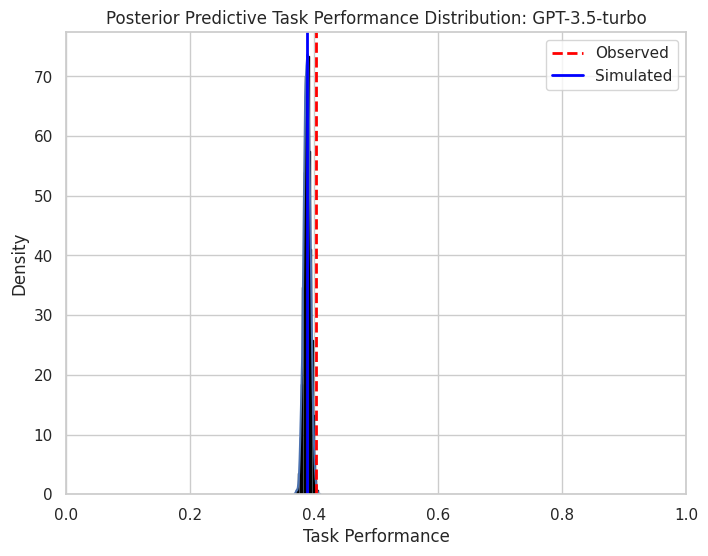

In [ ]:
with model:
  posterior_predictive = pm.sample_posterior_predictive(trace=trace)

process_predictive_data_and_plot_histogram(posterior_predictive,'posterior',save=True)

In [ ]:
#save trace to disk; to load the trace use idata = az.from_netcdf("filename.nc")
trace.to_netcdf(f"/content/drive/MyDrive/Addition_data/trace_{LLM}.nc")

'/content/drive/MyDrive/trace_gpt3_5_no_noise_no_slopes.nc'

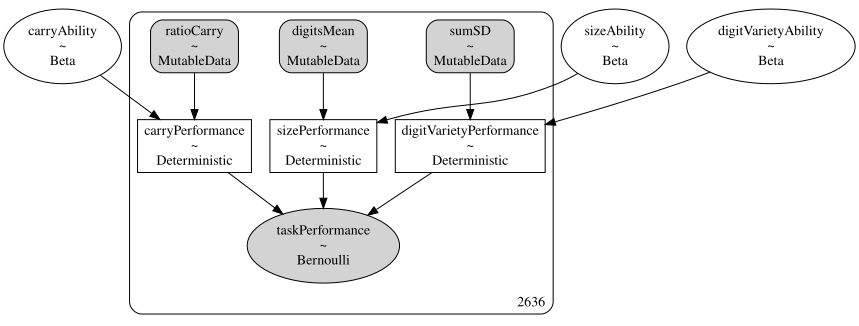

In [51]:
LLM = 'GPT-3 Ada'

model_ada = setupSumModel(train_dict[LLM])
pm.model_to_graphviz(model_ada)

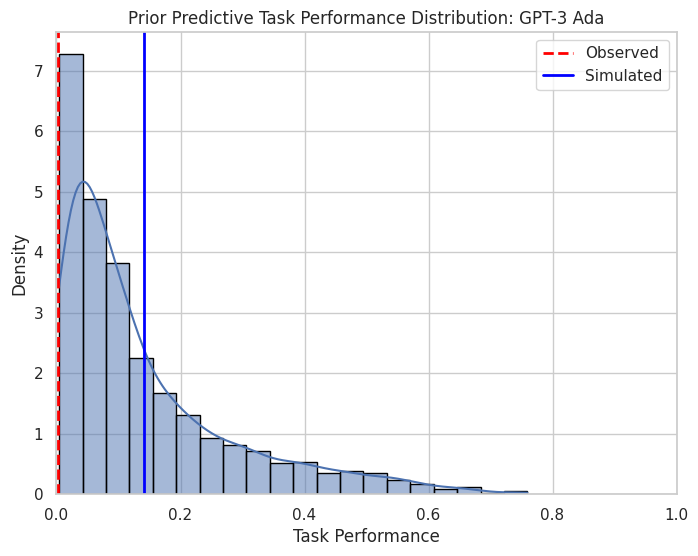

In [52]:
with model_ada:
    prior_predictive_ada = pm.sample_prior_predictive(samples=2_000)

process_predictive_data_and_plot_histogram(prior_predictive_ada,'prior',save=True)

In [53]:
with model_ada:
  trace_ada = pm.sample(nuts_sampler="numpyro", draws = 10000, tune = 2000, target_accept=0.99, chains=4)

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

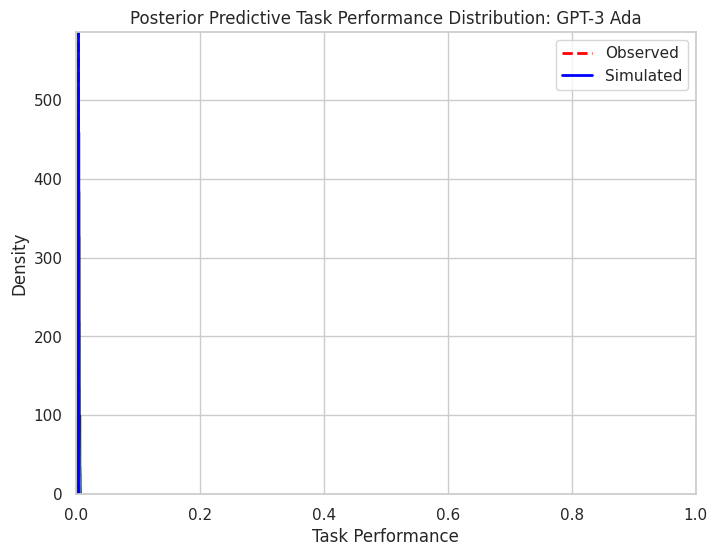

In [ ]:
with model_ada:
  posterior_predictive_ada = pm.sample_posterior_predictive(trace=trace_ada)

process_predictive_data_and_plot_histogram(posterior_predictive_ada,'posterior',save=True)

In [ ]:
#save trace to disk; to load the trace use idata = az.from_netcdf("filename.nc")
trace_ada.to_netcdf(f"/content/drive/MyDrive/Addition_data/trace_{LLM}.nc")

'/content/drive/MyDrive/trace_gpt3_5_noise_no_slopes.nc'

/usr/local/lib/python3.10/dist-packages/arviz/utils.py:184: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  numba_fn = numba.jit(**self.kwargs)(self.function)


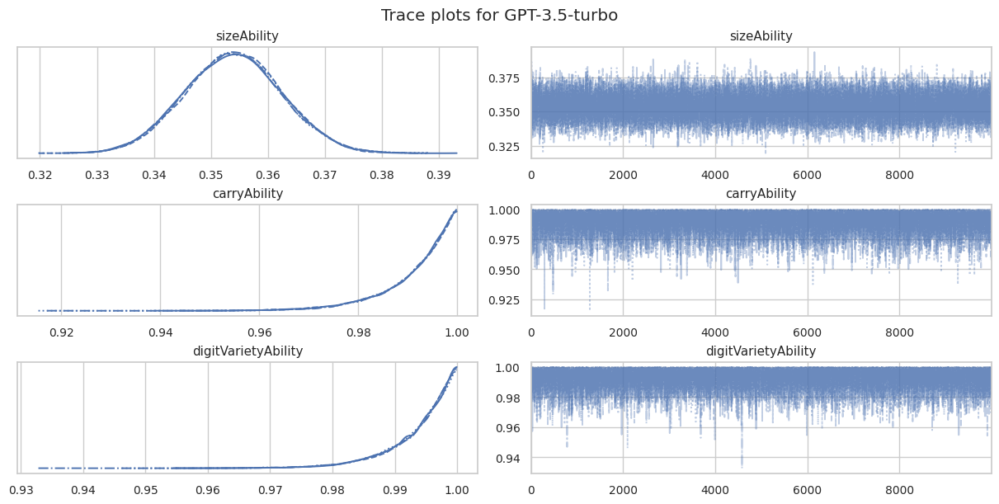

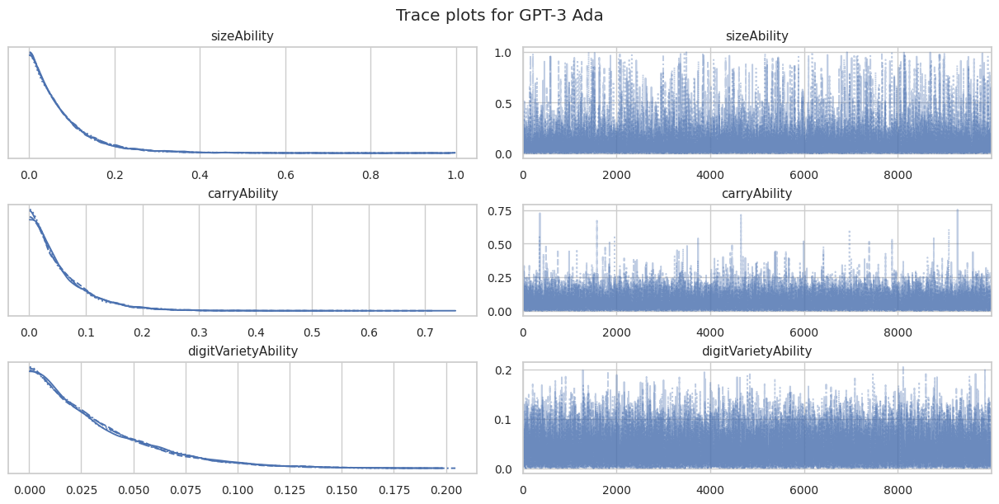

In [56]:
abilities = ['sizeAbility','carryAbility','digitVarietyAbility']
traces = {}
traces['GPT-3.5-turbo'] = trace
traces['GPT-3 Ada'] = trace_ada

for llm in ['GPT-3.5-turbo','GPT-3 Ada']:
  tr = traces[llm]
  axes = az.plot_trace(data=tr['posterior'][abilities])
  fig = axes.ravel()[0].figure
  fig.suptitle(f"Trace plots for {llm}")
  plt.rcParams['figure.constrained_layout.use'] = True
  filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/trace_plots_{llm}.png"
  fig.savefig(filename, dpi=300, bbox_inches='tight')
  plt.show()

<ipython-input-66-46ceb409d368>:10: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust layout to prevent overlap


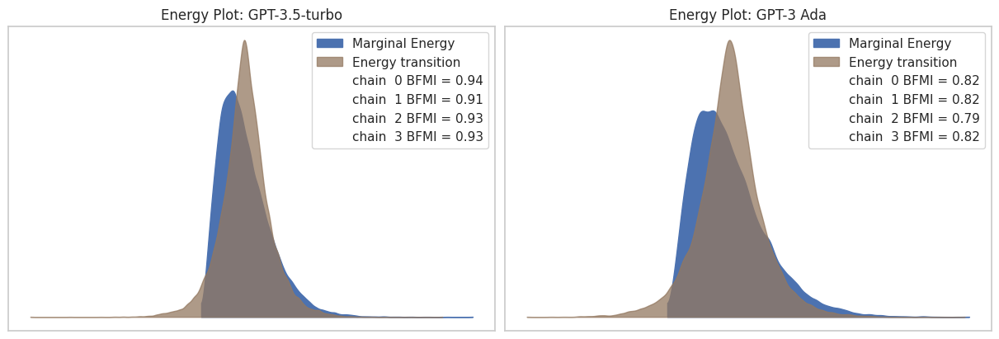

In [ ]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))  # 1 row, 2 columns

# Plot energy for the first trace
az.plot_energy(data=traces['GPT-3.5-turbo'], ax=axs[0])
axs[0].set_title('Energy Plot: GPT-3.5-turbo')

az.plot_energy(data=traces['GPT-3 Ada'], ax=axs[1])
axs[1].set_title('Energy Plot: GPT-3 Ada')

plt.tight_layout()  # Adjust layout to prevent overlap

filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/energy_plots_3_5_ada.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')

plt.show()

BFMI stands for Bayesian Fraction of Missing Information and measures the mismatch between two distributions. Empirically, BFMI values below 0.3 have been shown to be problematic. (see Chapter 6.1 [here](https://arxiv.org/pdf/1701.02434.pdf)).

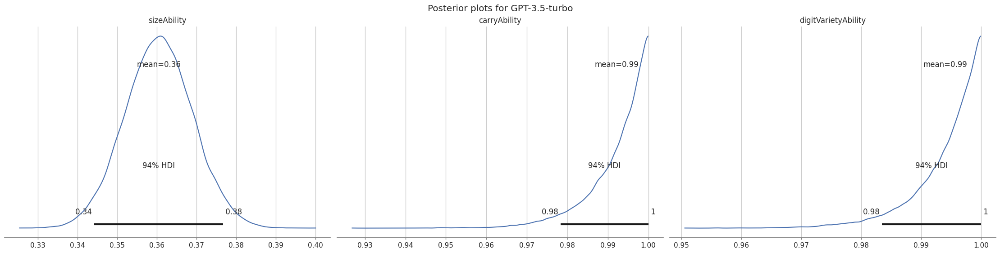

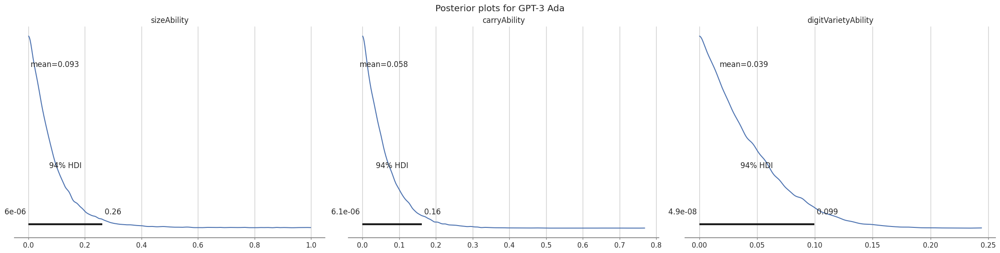

In [ ]:
for llm in ['GPT-3.5-turbo','GPT-3 Ada']:
  tr = traces[llm]
  axes = az.plot_posterior(data=tr['posterior'][abilities])
  fig = axes.ravel()[0].figure
  fig.suptitle(f"Posterior plots for {llm}")
  filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/posterior_plots_{llm}.png"
  fig.savefig(filename, dpi=300, bbox_inches='tight')
  plt.show()


In [ ]:
summary = az.summary(trace['posterior'][abilities],round_to=3)
print('Summary statistics: GPT-3.5-turbo')
summary[['mean','sd','hdi_3%','hdi_97%','ess_bulk','ess_tail','r_hat']]

Summary statistics: GPT-3.5-turbo


,mean,sd,hdi_3%,hdi_97%,ess_bulk,ess_tail,r_hat
sizeAbility,0.361,0.009,0.344,0.377,22956.159,22305.809,1.0
carryAbility,0.992,0.007,0.978,1.000,19785.217,13071.833,1.0
digitVarietyAbility,0.994,0.006,0.983,1.000,17494.655,11998.507,1.0


In [ ]:
summary = az.summary(trace_ada['posterior'][abilities],round_to=3)
print('Summary statistics: GPT-3 Ada')
summary[['mean','sd','hdi_3%','hdi_97%','ess_bulk','ess_tail','r_hat']]

Summary statistics: GPT-3 Ada


,mean,sd,hdi_3%,hdi_97%,ess_bulk,ess_tail,r_hat
sizeAbility,0.093,0.119,0.0,0.262,18410.049,14472.797,1.0
carryAbility,0.058,0.058,0.0,0.162,17052.909,14567.057,1.0
digitVarietyAbility,0.039,0.033,0.0,0.099,16271.271,12893.759,1.0


#### Use the meaasurmet layout to predict performance of LLMs on training data

Here we calculate performance scores of each measurement layout on the training set.

In [ ]:
for llm in ['GPT-3.5-turbo','GPT-3 Ada']:
  print(f'\n{llm}')
  model_initialize = setupSumModel(test_dict[llm])

  predictions = predict(model_initialize, traces[llm], test_dict[llm])

  modelBrierScore = brier_score_loss(test_dict[llm]["success"], predictions)
  average_success_on_train_score = brier_score_loss(test_dict[llm]["success"],np.mean(train_dict[llm]["success"]) * np.ones_like(test_dict[llm]["success"]))
  roc_auc = roc_auc_score(test_dict[llm]["success"], predictions)

  print(f'Brier Score: {modelBrierScore:.3f}, '
          f'Average success on train Brier score: {average_success_on_train_score:.3f}, '
          f'AUROC: {roc_auc:.3f}')


GPT-3.5-turbo


Brier Score: 0.117, Average success on train Brier score: 0.235, AUROC: 0.911

GPT-3 Ada


Brier Score: 0.002, Average success on train Brier score: 0.003, AUROC: 0.990


### Build a measurment layout for each LLM


GPT-3 Ada


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/arviz/utils.py:184: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  numba_fn = numba.jit(**self.kwargs)(self.function)


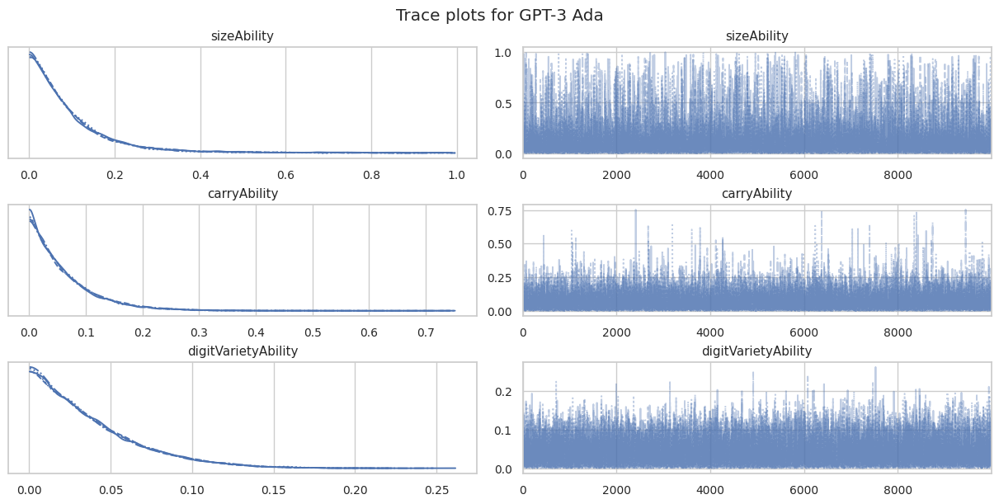

/usr/local/lib/python3.10/dist-packages/arviz/utils.py:184: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  numba_fn = numba.jit(**self.kwargs)(self.function)


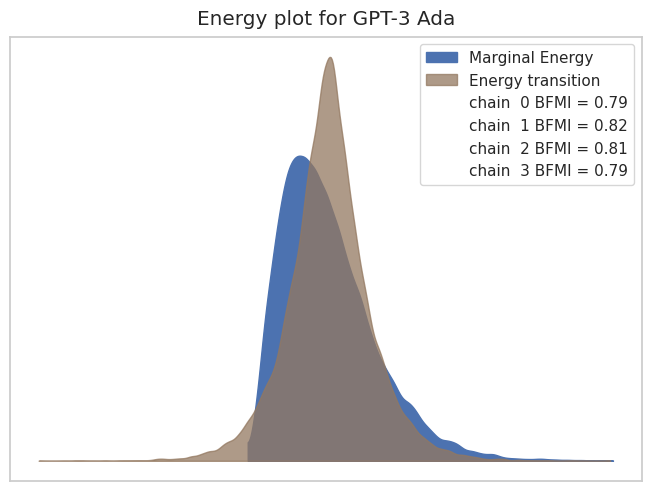

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.112  0.142     0.0    0.335  15947.664  13647.912    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.062  0.063     0.0    0.172  17314.838  12229.962    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.037  0.032     0.0    0.096  14887.575  12581.714   

                     r_hat  
digitVarietyAbility    1.0  


{'BrierScore': 0.0031353598494318203, 'Calibration': 0.00023486105729865448, 'Refinement': 0.0030210501966227155, 'AUROC': 0.9711246200607903, 'AP score': 0.07125000000000001}

GPT-3 Babbage


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

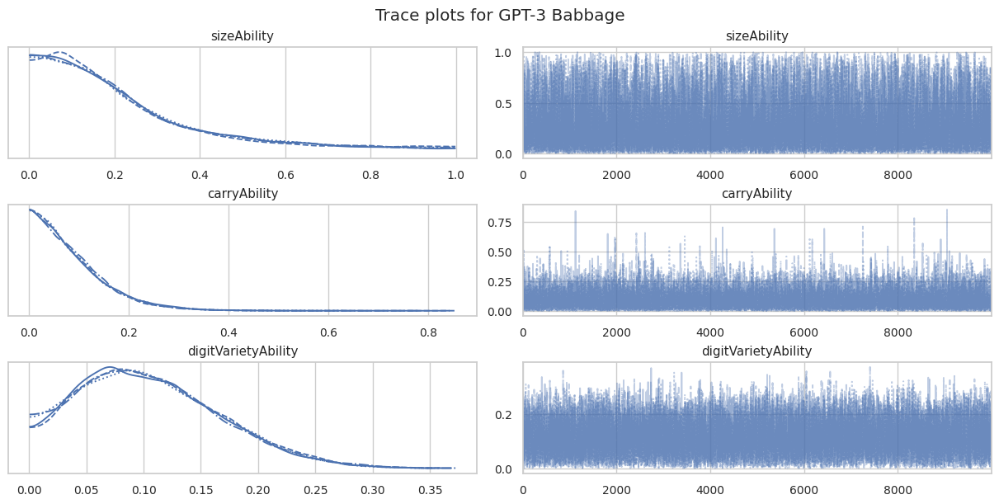

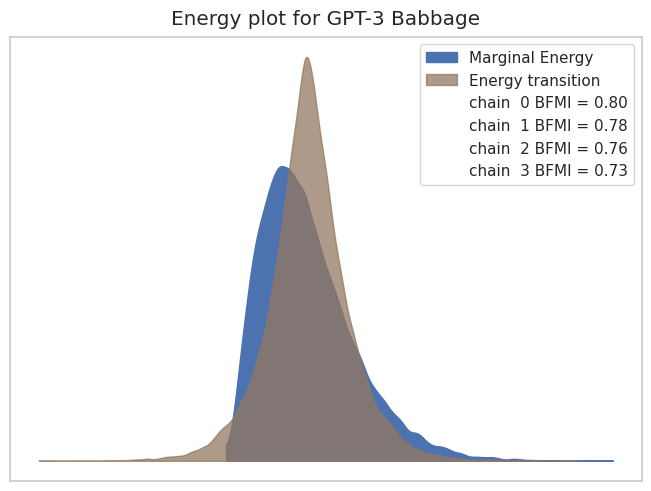

              mean     sd  hdi_3%  hdi_97%  ess_bulk   ess_tail  r_hat
sizeAbility  0.243  0.222     0.0    0.709  13623.89  14121.887    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.085  0.073     0.0    0.213  13543.988  10165.721    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.106  0.061     0.0    0.211  12443.023  10333.832   

                     r_hat  
digitVarietyAbility    1.0  


{'BrierScore': 0.0027705434782197, 'Calibration': 0.000497483406990435, 'Refinement': 0.0022703854620392486, 'AUROC': 0.9832826747720365, 'AP score': 0.2934782608695652}

GPT-3 Curie


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

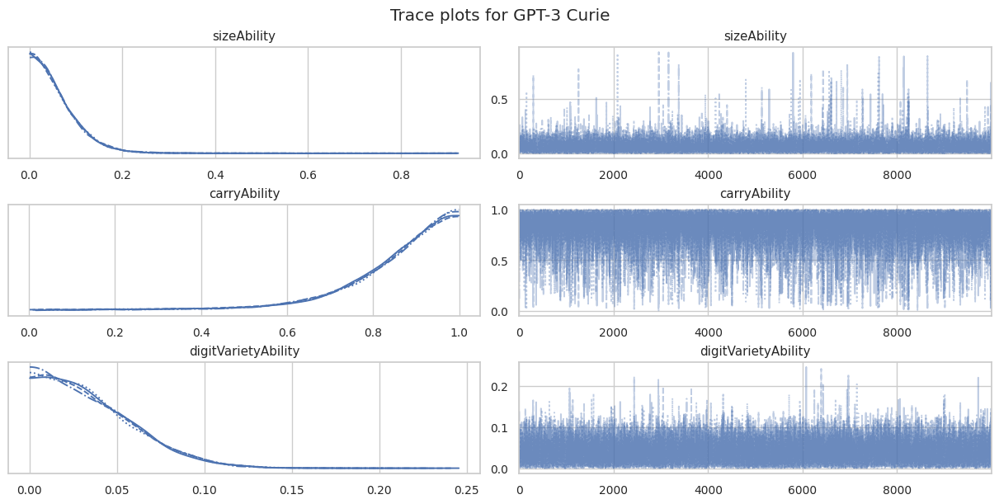

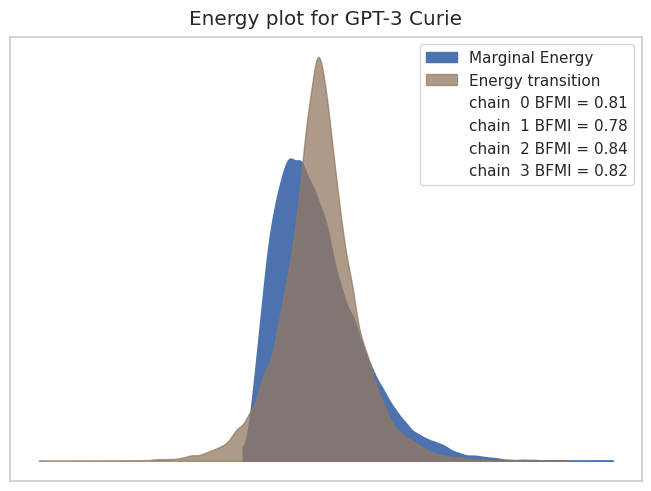

             mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.06  0.057     0.0    0.147  12067.735  10409.733    1.0
               mean     sd  hdi_3%  hdi_97%  ess_bulk   ess_tail  r_hat
carryAbility  0.843  0.157   0.576      1.0   16434.1  12125.648    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.036  0.027     0.0    0.084  12464.858  10123.904   

                     r_hat  
digitVarietyAbility    1.0  


{'BrierScore': 0.013265867901515155, 'Calibration': 6.014432257673826e-05, 'Refinement': 0.014454501220343571, 'AUROC': 0.9653846153846154, 'AP score': 0.2820618389510869}

GPT-3 Davinci


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

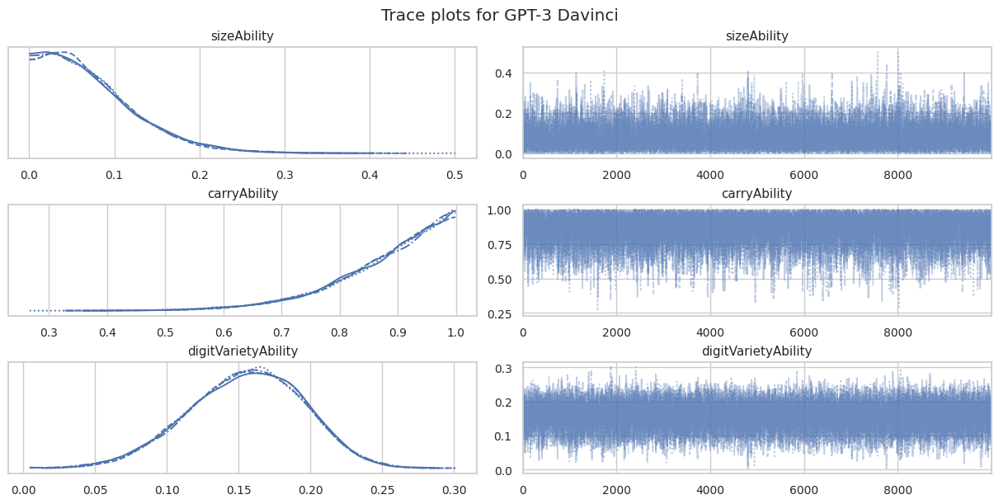

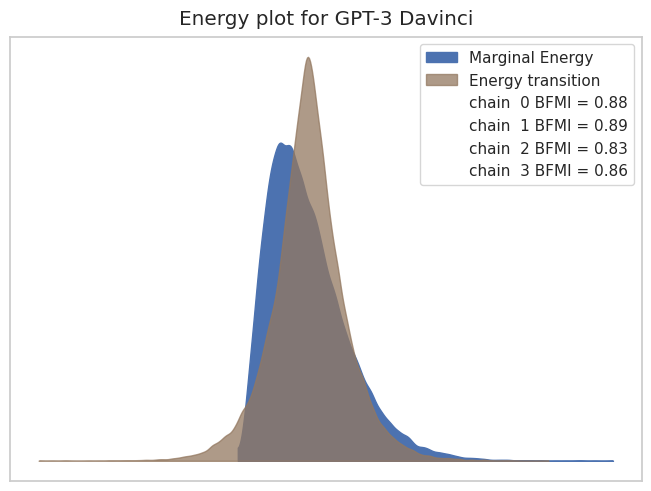

              mean     sd  hdi_3%  hdi_97%  ess_bulk   ess_tail  r_hat
sizeAbility  0.074  0.056     0.0    0.173   12055.6  11186.697    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.883  0.098   0.705      1.0  13451.625  11293.579    1.0
                      mean    sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
digitVarietyAbility  0.155  0.04    0.08    0.227  13493.404  12102.647    1.0


{'BrierScore': 0.014820645535037888, 'Calibration': 0.0031269763567662798, 'Refinement': 0.011924533799533801, 'AUROC': 0.9512936753648827, 'AP score': 0.6334303194073824}

text-davinci-001


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

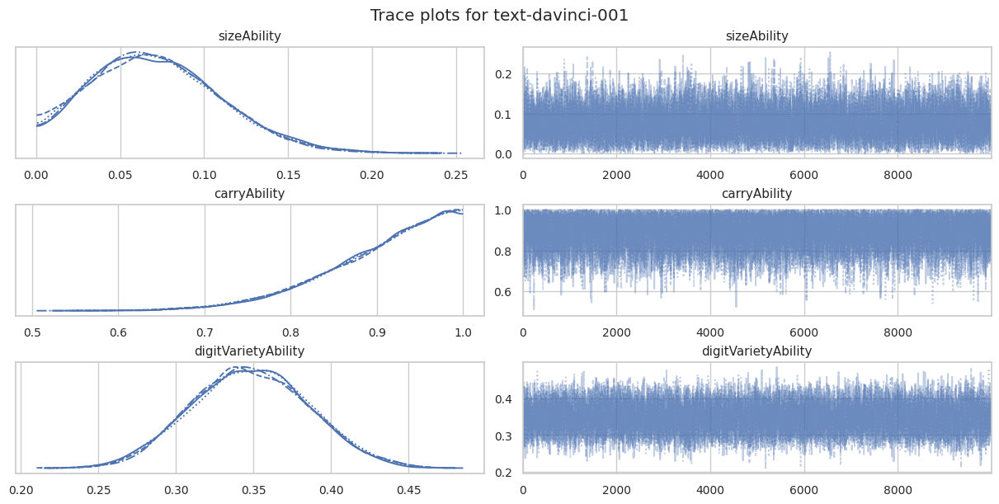

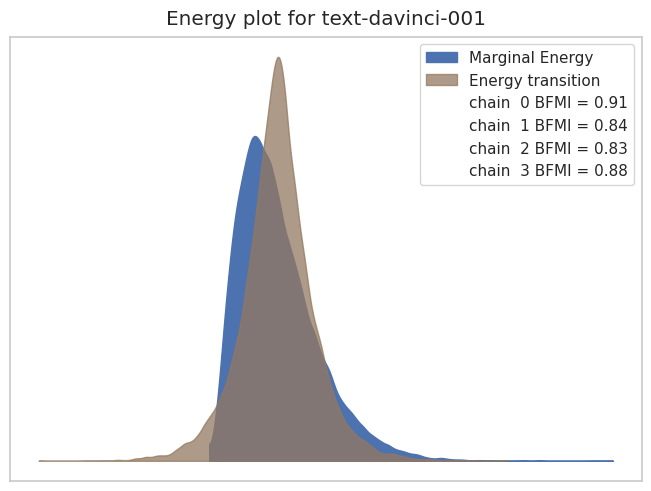

              mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
sizeAbility  0.072  0.038   0.001    0.137  9207.677  8831.978    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
carryAbility  0.907  0.072   0.776      1.0  12767.635  10355.26    1.0
                      mean     sd  hdi_3%  hdi_97%  ess_bulk   ess_tail  r_hat
digitVarietyAbility  0.348  0.038   0.276    0.417  9603.032  13422.536    1.0


{'BrierScore': 0.03600521688068181, 'Calibration': 0.0023672164301231304, 'Refinement': 0.03457608384262796, 'AUROC': 0.919626890918757, 'AP score': 0.5248530814730772}

text-davinci-002


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

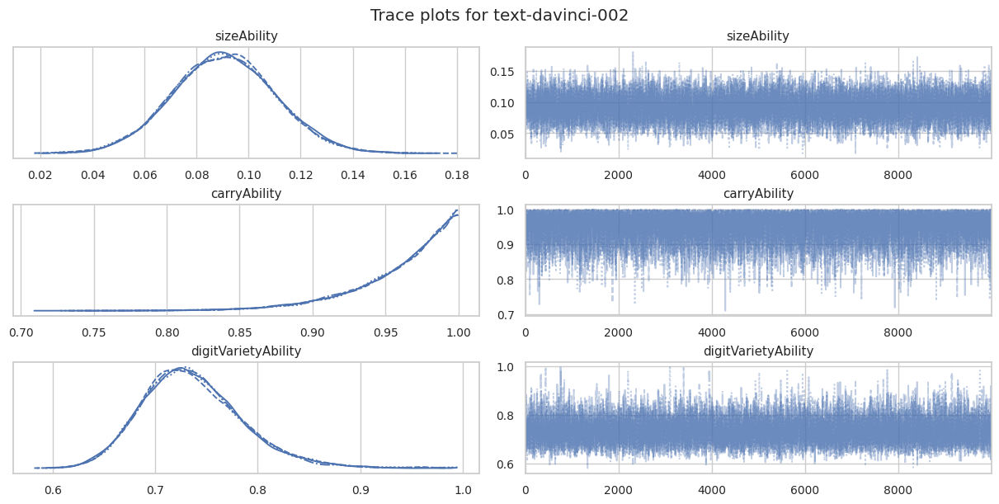

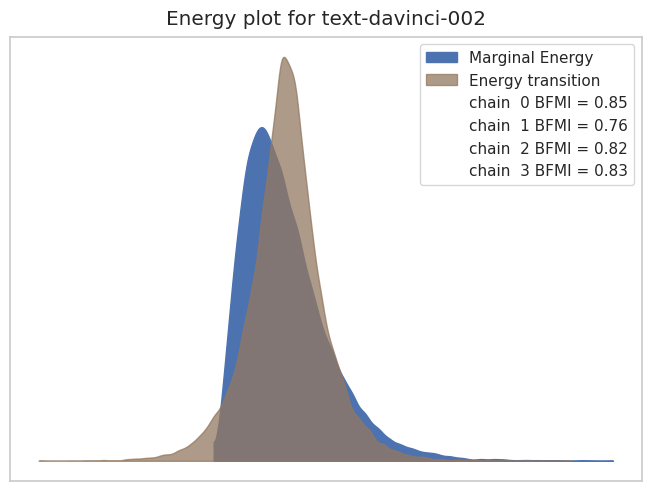

              mean    sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
sizeAbility  0.091  0.02   0.053    0.127  9819.594  9701.773    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
carryAbility  0.961  0.035   0.897      1.0  12363.121  9549.371    1.0
                      mean    sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.736  0.05   0.647     0.83  9675.911  8919.527    1.0


{'BrierScore': 0.06196332321969695, 'Calibration': 0.014545852871370758, 'Refinement': 0.04794188316055749, 'AUROC': 0.9642250295508275, 'AP score': 0.841760153066048}

text-davinci-003


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

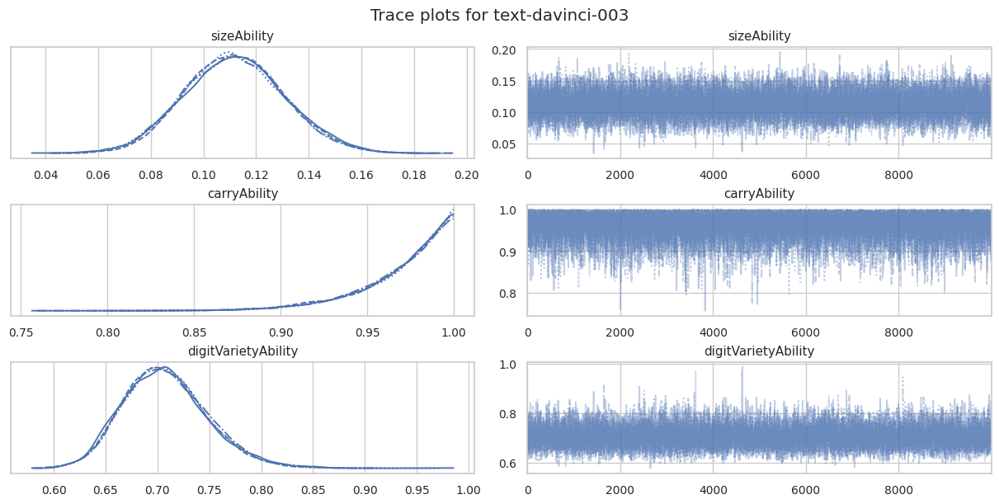

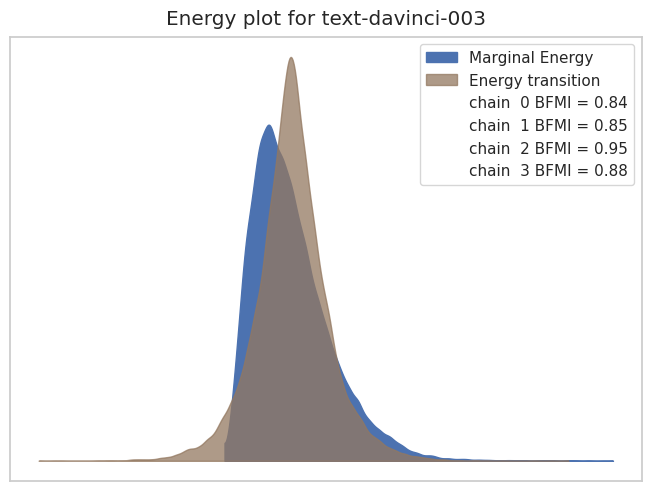

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.112  0.019   0.076    0.148  10940.866  12531.203  1.001
              mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
carryAbility  0.97  0.027    0.92      1.0  14302.54  10624.17    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.708  0.041   0.634    0.784  11039.557  11186.508   

                     r_hat  
digitVarietyAbility  1.001  


{'BrierScore': 0.06155702830776514, 'Calibration': 0.007104136950709278, 'Refinement': 0.055886115216090985, 'AUROC': 0.9345806101355161, 'AP score': 0.7410573324642835}

GPT-4-0314


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

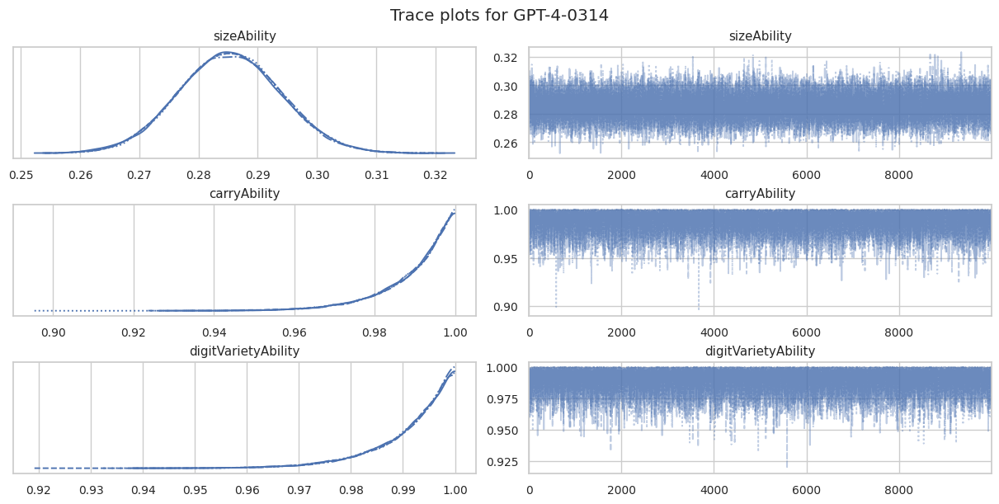

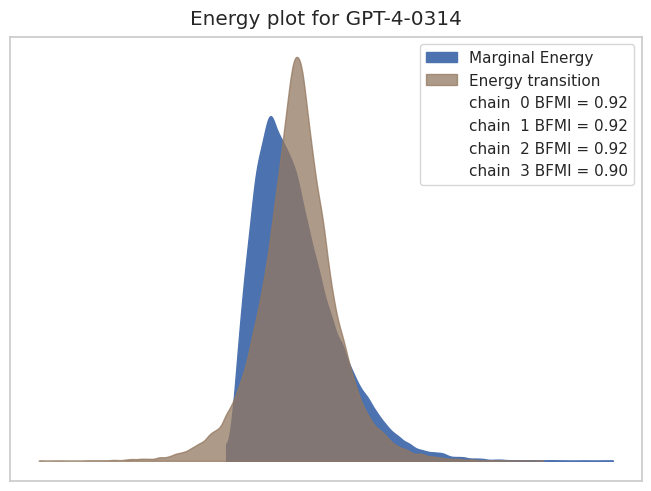

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.285  0.009   0.269    0.301  23667.415  21057.464    1.0
              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.99  0.009   0.973      1.0  16964.006  12814.772    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.992  0.008   0.977      1.0  17316.999  13167.265   

                     r_hat  
digitVarietyAbility    1.0  


{'BrierScore': 0.14853305857007584, 'Calibration': 0.01012678652141121, 'Refinement': 0.138229446097167, 'AUROC': 0.8130520633120123, 'AP score': 0.7427731799108241}

GPT-3.5-turbo


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

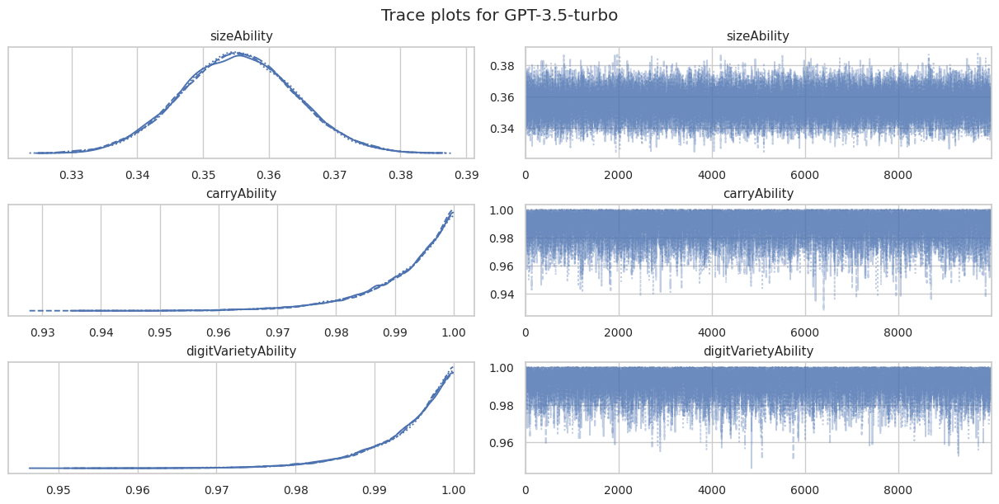

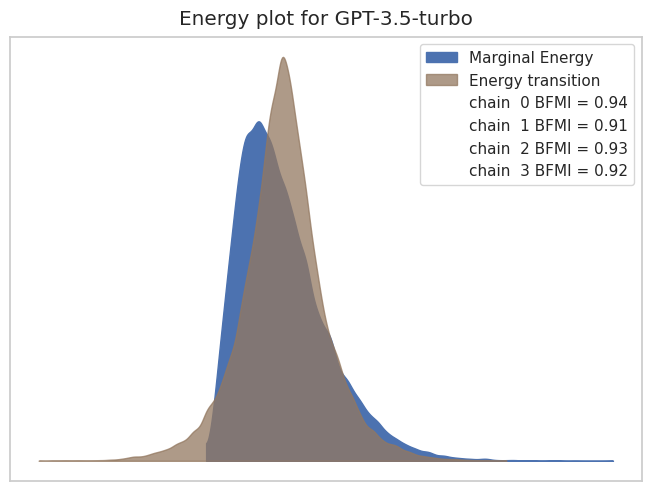

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.355  0.009   0.339    0.372  24346.102  22833.894    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.992  0.008   0.977      1.0  16957.677  12185.843    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.994  0.006   0.984      1.0  18844.659  12957.762   

                     r_hat  
digitVarietyAbility    1.0  


{'BrierScore': 0.13759515971590908, 'Calibration': 0.005073908104286318, 'Refinement': 0.1338545713492736, 'AUROC': 0.8803991330699297, 'AP score': 0.8456316863676412}

GPT-4-0613


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

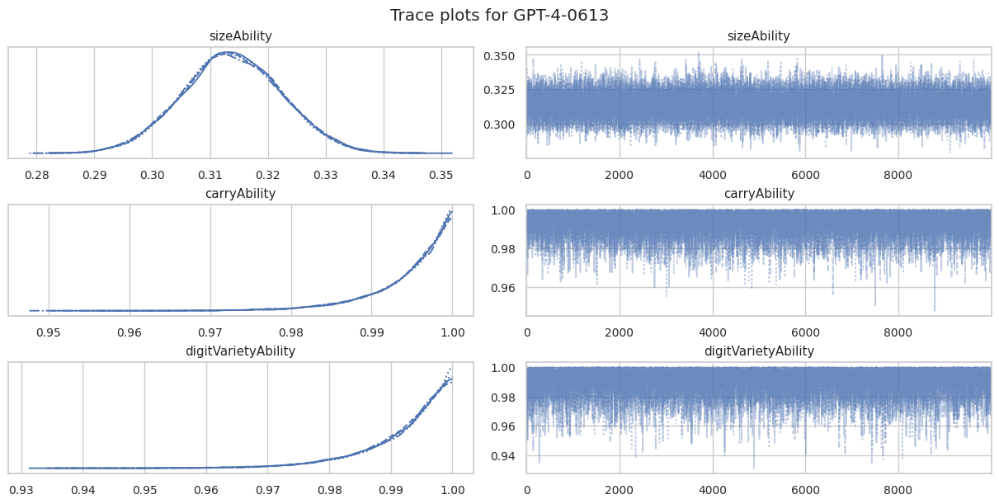

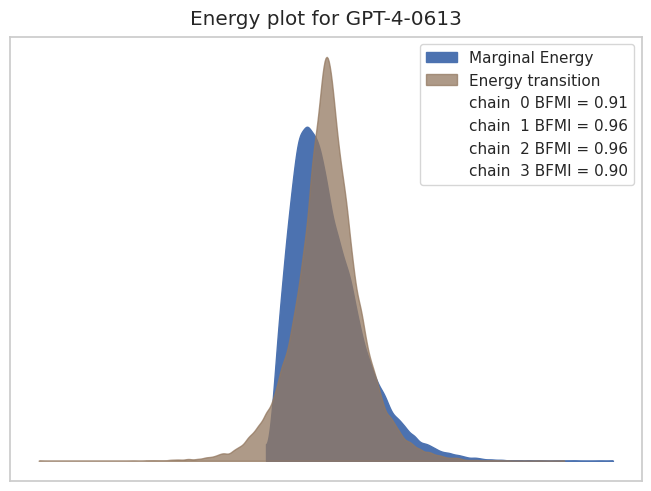

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.314  0.009   0.297     0.33  24670.705  23499.191    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.995  0.005   0.985      1.0  18461.204  13153.547    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.992  0.007   0.979      1.0  17580.396  13479.99    1.0


{'BrierScore': 0.15325772899431828, 'Calibration': 0.0056107052641583815, 'Refinement': 0.1475429817210232, 'AUROC': 0.8233184706386969, 'AP score': 0.7676647723041539}


In [ ]:
scores_dict = {}
metrics_dict = {}
probabilities = {}
list_features = ['harm_mean_scaled','carry_art_mean_ratio_scaled','sum_sd_scaled']
abilities = ['sizeAbility','carryAbility','digitVarietyAbility']
predictive_methods_df_mes_lay = pd.DataFrame()

for llm in llms:
    print(f'\n{llm}')

    m_llm = setupSumModel(train_dict[llm])

    with m_llm:
      llm_trace = pm.sample(nuts_sampler="numpyro", draws = 10000, tune = 2000, target_accept=0.99, chains=4) #pm.sample(10000, target_accept = 0.99, chains = 4)

    #Save the trace
    llm_trace.to_netcdf(f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Traces/trace_addition_data_{llm}.nc")

    # Plot the trace plot on the first subplot
    axes = az.plot_trace(data=llm_trace['posterior'][abilities])
    fig = axes.ravel()[0].figure
    fig.suptitle(f"Trace plots for {llm}")
    plt.rcParams['figure.constrained_layout.use'] = True
    filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/trace_plots_{llm}.png"
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

    axes = az.plot_energy(data=llm_trace)
    fig = axes.figure
    fig.suptitle(f"Energy plot for {llm}")
    filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/energy_plots_{llm}.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

    metrics_dict[llm] = {}

    for ability in abilities:

        summary = az.summary(llm_trace['posterior'][ability], round_to=3)

        metrics_dict[llm][ability] = {
                'mean': summary['mean'][0],
                'hdi_3%': summary['hdi_3%'][0],
                'hdi_97%': summary['hdi_97%'][0],
                'ess_bulk': summary['ess_bulk'][0],
                'ess_tail': summary['ess_tail'][0],
                'r_hat': summary['r_hat'][0],
        }
        print(summary[['mean','sd','hdi_3%','hdi_97%','ess_bulk','ess_tail','r_hat']])

    m_llm = setupSumModel(test_dict[llm])

    predictions = predict(m_llm, llm_trace, test_dict[llm][list_features])

    probabilities[llm] = predictions

    modelBrierScore, modelCalibration, modelRefinement = brierDecomp(predictions, test_dict[llm]['success'])
    roc_auc = roc_auc_score(test_dict[llm]['success'], predictions)


    scores_dict[llm] = {'BrierScore': modelBrierScore, 'Calibration':modelCalibration,'Refinement':modelRefinement,'AUROC':roc_auc}
    print(scores_dict[llm])

    predictive_methods_df_mes_lay = pd.concat([predictive_methods_df_mes_lay, pd.DataFrame({"predictive_method": 'Measurement layout', "llm": llm, "BrierScore": modelBrierScore, "Calibration": modelCalibration, "Refinement": modelRefinement, "AUROC": roc_auc}, index=[0])])


In [ ]:
#save scores
predictive_methods_mes_lay_combined_df = pd.concat([predictive_methods_df,predictive_methods_df_mes_lay])
predictive_methods_mes_lay_combined_df.to_pickle("/content/drive/MyDrive/Colab Notebooks/Addition_data/predictive_methods_mes_lay.pkl")

#### Load taces and plot (in case not done above)


 GPT-3 Ada


/usr/local/lib/python3.10/dist-packages/arviz/utils.py:184: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  numba_fn = numba.jit(**self.kwargs)(self.function)


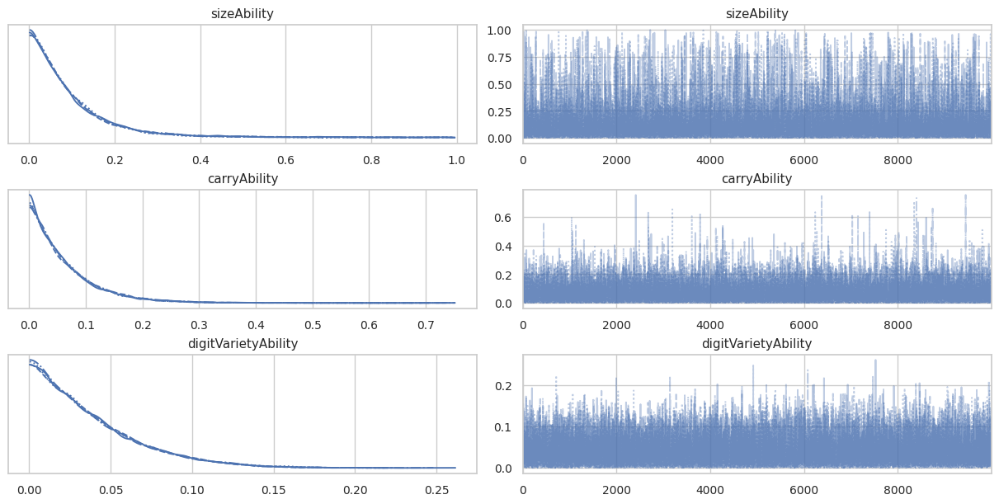

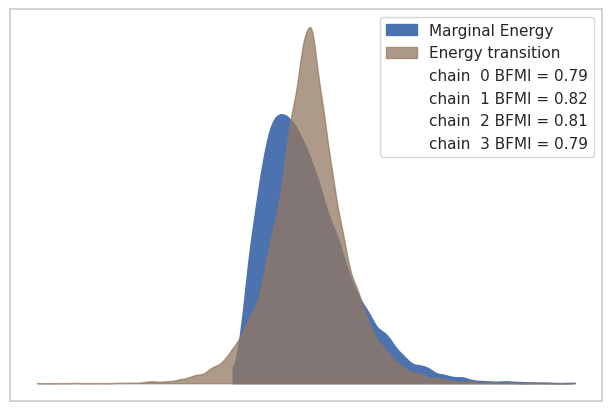


 GPT-3 Babbage


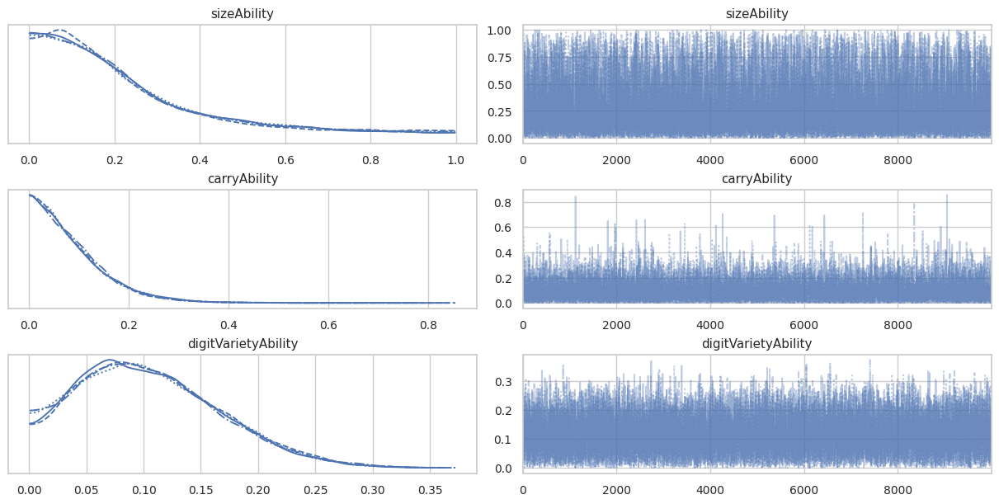

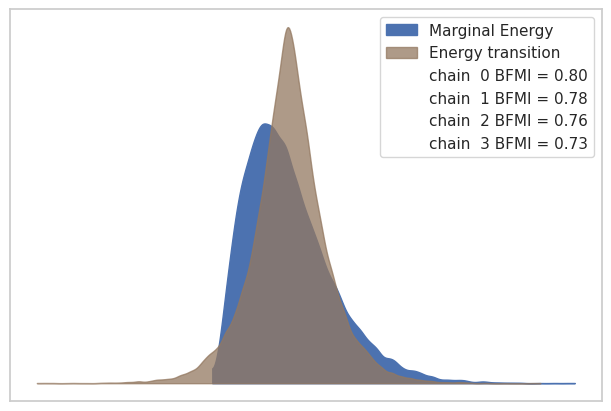


 GPT-3 Curie


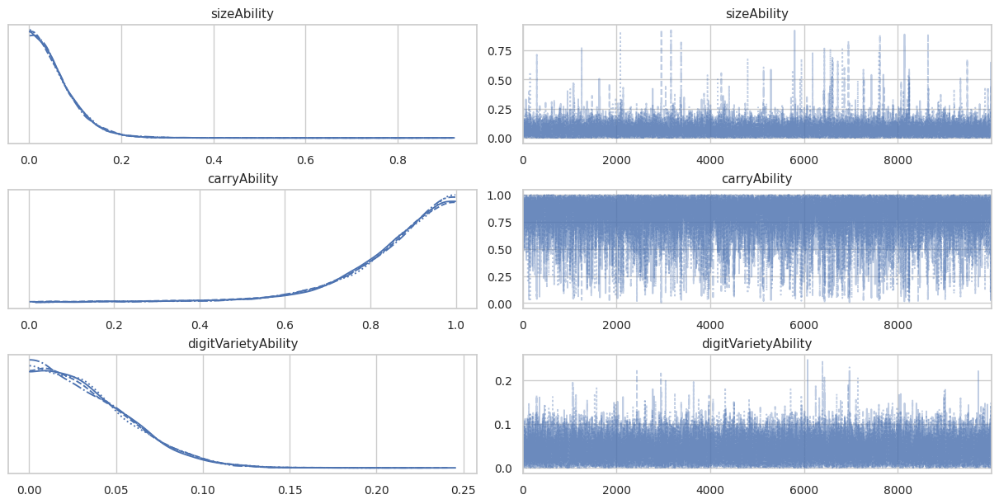

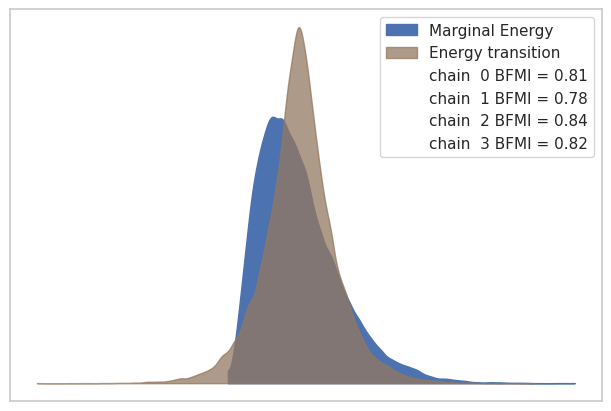


 GPT-3 Davinci


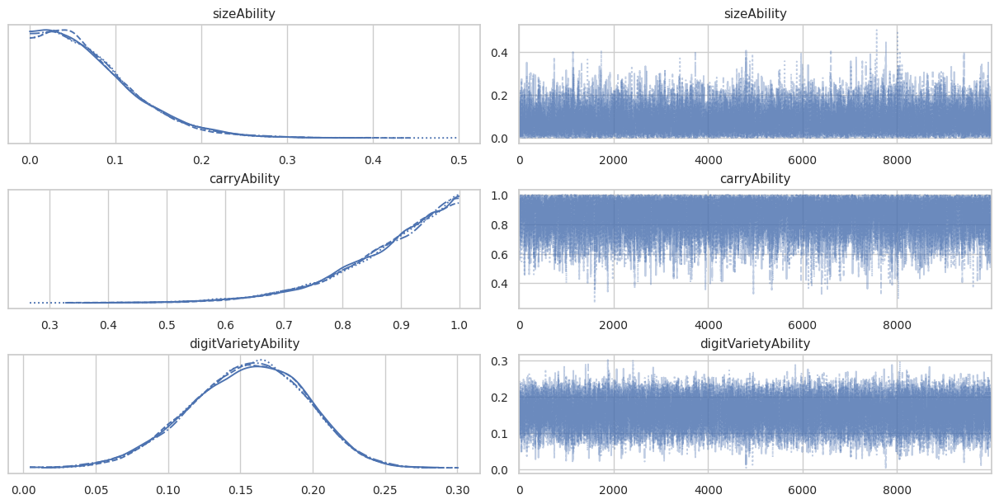

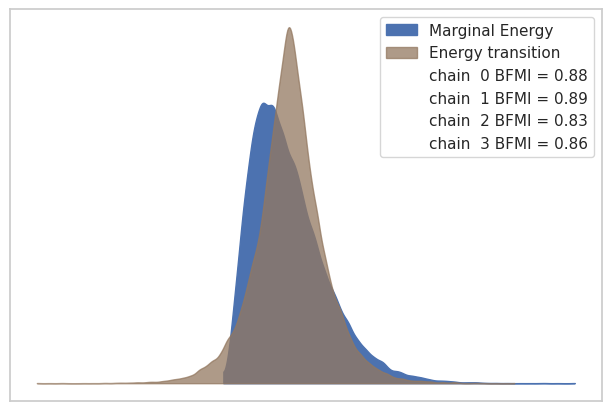


 text-davinci-001


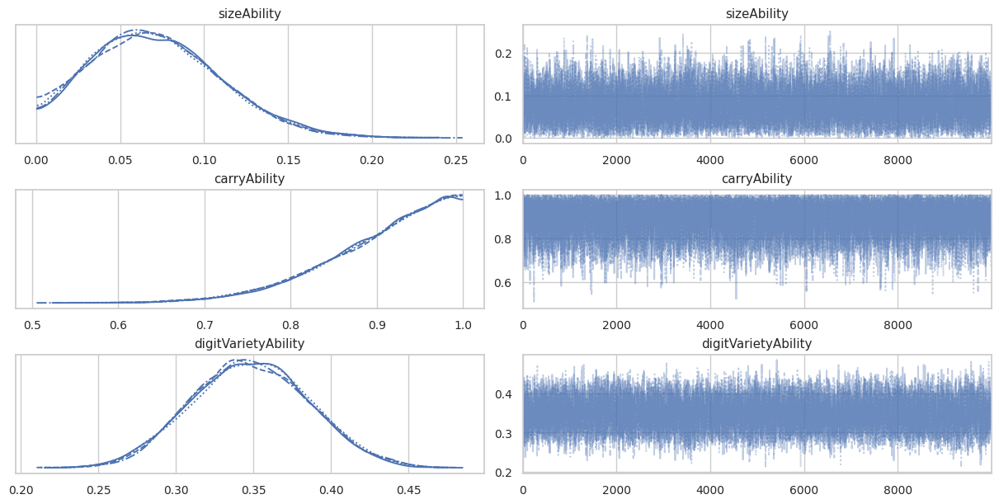

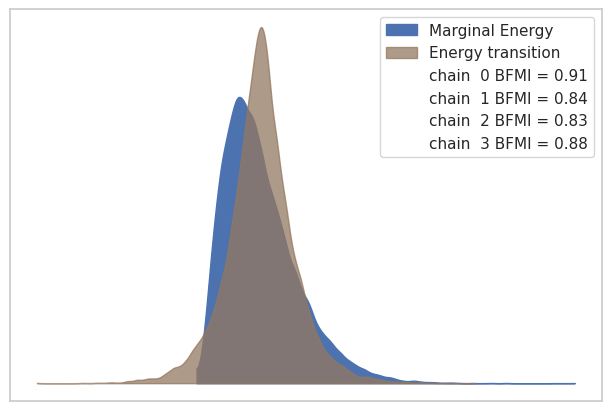


 text-davinci-002


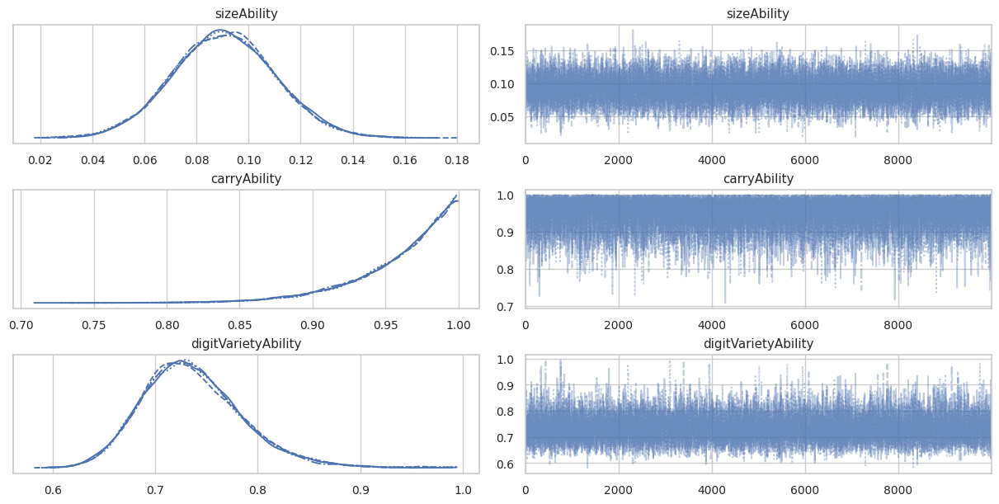

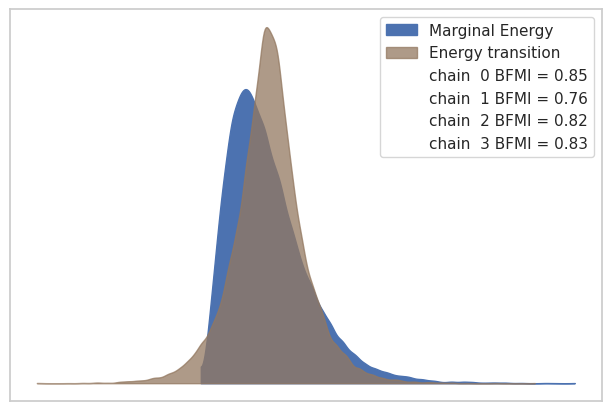


 text-davinci-003


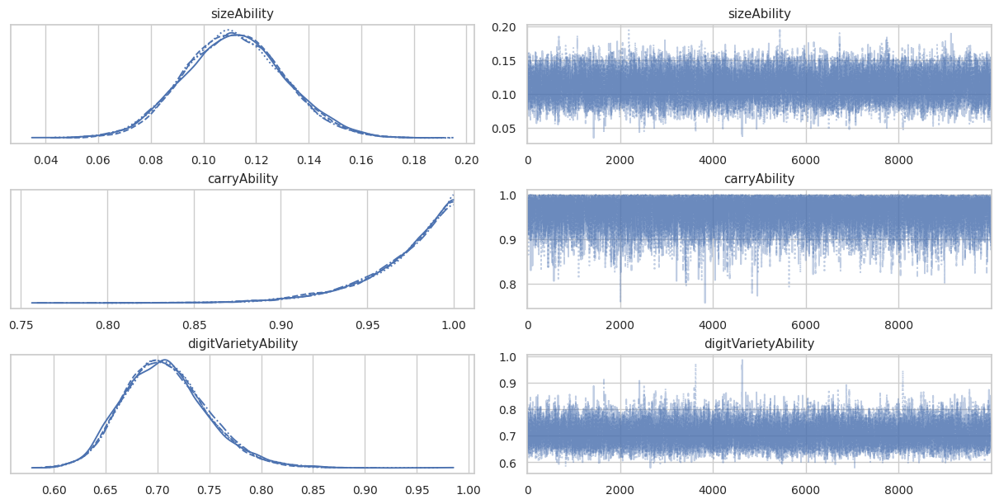

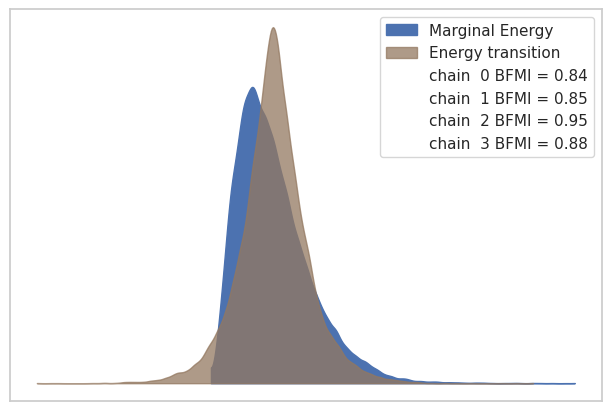


 GPT-4-0314


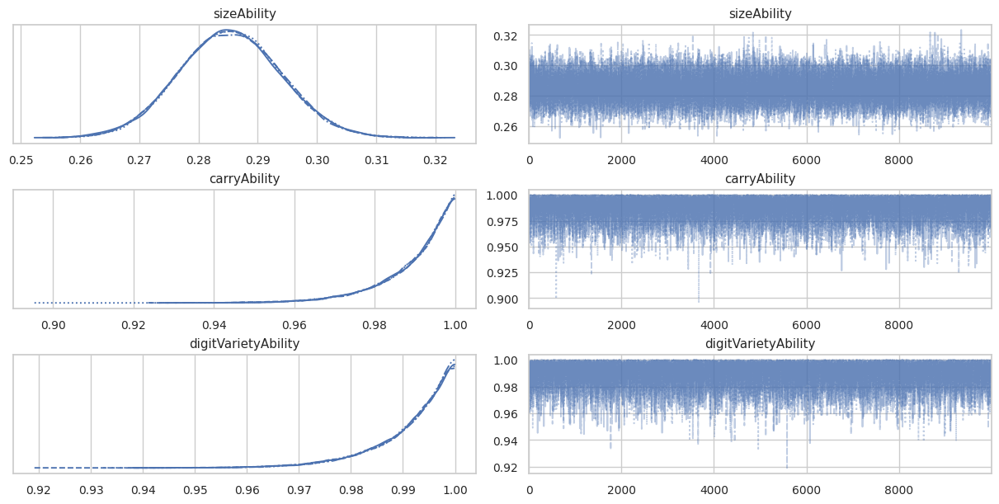

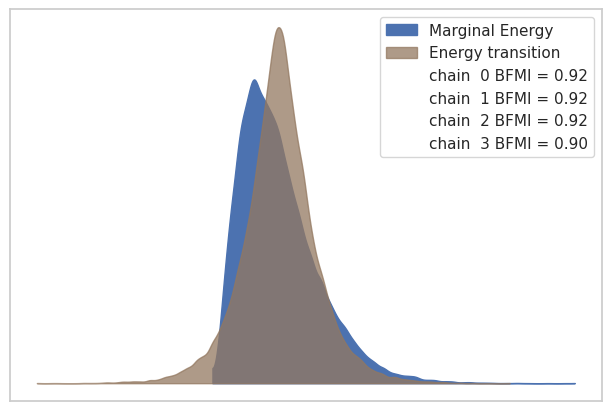


 GPT-3.5-turbo


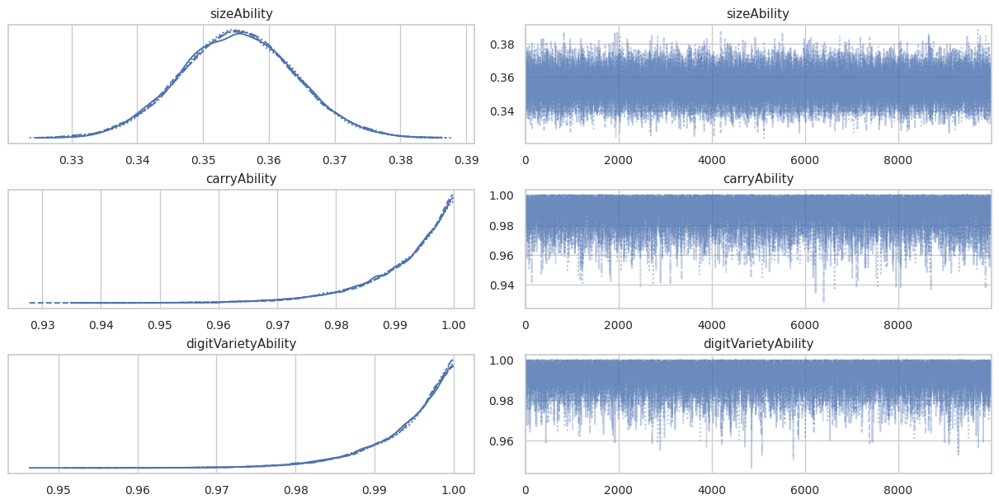

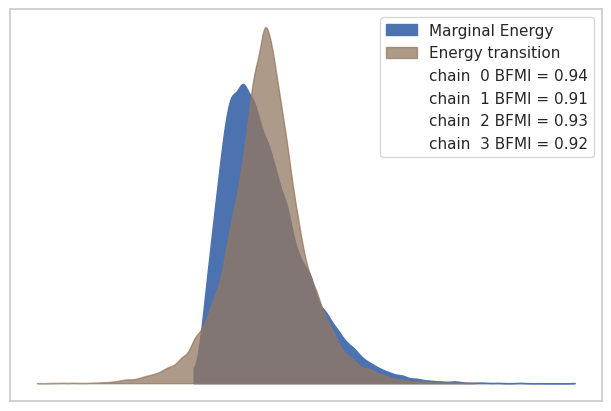


 GPT-4-0613


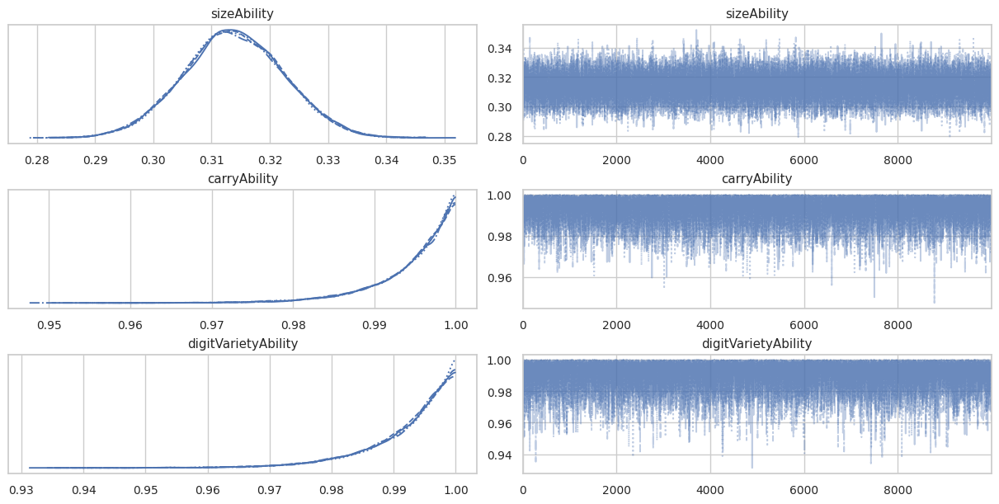

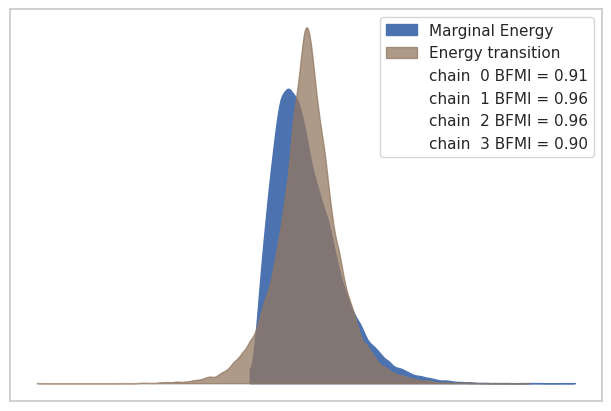

In [57]:
scores_dict = {}
metrics_dict = {}
probabilities = {}
list_features = ['harm_mean_scaled','sum_sd_scaled','carry_art_mean_ratio_scaled']
abilities = ['sizeAbility','carryAbility','digitVarietyAbility']
predictive_methods_df_mes_lay = pd.DataFrame()

for llm in llms:
    print(f'\n {llm}')
    #Load the trace
    with az.rc_context(rc={"data.load": "eager"}):
      llm_trace = az.from_netcdf(f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Traces/trace_addition_data_{llm}.nc")

    # Plot the trace plot on the first subplot
    az.plot_trace(data=llm_trace['posterior'][abilities])
    plt.rcParams['figure.constrained_layout.use'] = True
    fig, ax = plt.subplots(figsize=(6, 4))
    # Plot the energy plot on the second subplot
    az.plot_energy(data=llm_trace, ax=ax)
    plt.show()

    metrics_dict[llm] = {}

    for ability in abilities:

        summary = az.summary(llm_trace['posterior'][ability], round_to=3)

        metrics_dict[llm][ability] = {
                'mean': summary['mean'][0],
                'hdi_3%': summary['hdi_3%'][0],
                'hdi_97%': summary['hdi_97%'][0],
                'ess_bulk': summary['ess_bulk'][0],
                'ess_tail': summary['ess_tail'][0],
                'r_hat': summary['r_hat'][0],
        }

    m_llm = setupSumModel(test_dict[llm])

    predictions = predict(m_llm, llm_trace, test_dict[llm][list_features])

    probabilities[llm] = predictions

    modelBrierScore, modelCalibration, modelRefinement = brierDecomp(predictions, test_dict[llm]['success'])
    roc_auc = roc_auc_score(test_dict[llm]['success'], predictions)
    ap = average_precision_score(test_dict[llm]['success'], predictions)


    scores_dict[llm] = {'BrierScore': modelBrierScore, 'Calibration':modelCalibration,'Refinement':modelRefinement,'AUROC':roc_auc}

    predictive_methods_df_mes_lay = pd.concat([predictive_methods_df_mes_lay, pd.DataFrame({"predictive_method": 'Measurement layout', "llm": llm, "BrierScore": modelBrierScore, "Calibration": modelCalibration, "Refinement": modelRefinement, "AUROC": roc_auc}, index=[0])])

In [81]:
#save scores
predictive_methods_mes_lay_combined_df = pd.concat([predictive_methods_df,predictive_methods_df_mes_lay])
predictive_methods_mes_lay_combined_df.to_pickle("/content/drive/MyDrive/Colab Notebooks/Addition_data/predictive_methods_mes_lay.pkl")

#### Convergence metrics

In [58]:
data_for_df = []
for llm, abilities in metrics_dict.items():
    for ability, metrics in abilities.items():
        row = (llm, ability, metrics.get('ess_bulk'), metrics.get('ess_tail'), metrics.get('r_hat'))
        data_for_df.append(row)

# Creating the DataFrame
df = pd.DataFrame(data_for_df, columns=['LLM', 'Ability', 'ess_bulk', 'ess_tail', 'r_hat'])

# Setting LLM and Ability as the index if desired
df.set_index(['LLM', 'Ability'], inplace=True)

# Display the DataFrame
print(df)

                                       ess_bulk   ess_tail  r_hat
LLM              Ability                                         
GPT-3 Ada        sizeAbility          15947.664  13647.912  1.000
                 carryAbility         17314.838  12229.962  1.000
                 digitVarietyAbility  14887.575  12581.714  1.000
GPT-3 Babbage    sizeAbility          13623.890  14121.887  1.000
                 carryAbility         13543.988  10165.721  1.000
                 digitVarietyAbility  12443.023  10333.832  1.000
GPT-3 Curie      sizeAbility          12067.735  10409.733  1.000
                 carryAbility         16434.100  12125.648  1.000
                 digitVarietyAbility  12464.858  10123.904  1.000
GPT-3 Davinci    sizeAbility          12055.600  11186.697  1.000
                 carryAbility         13451.625  11293.579  1.000
                 digitVarietyAbility  13493.404  12102.647  1.000
text-davinci-001 sizeAbility           9207.677   8831.978  1.000
          

#### Visualise abilities

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
<ipython-input-59-295ea8e3db91>:32: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  g.fig.subplots_adjust(top=0.9)


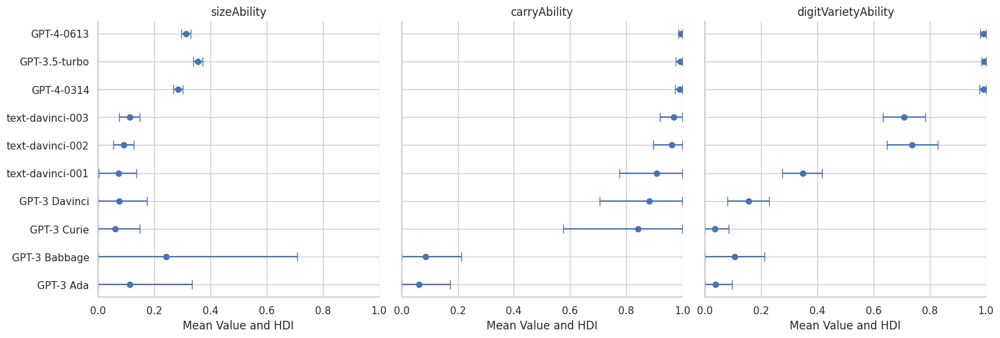

In [59]:
# Prepare the DataFrame from the provided dictionary
rows = []
for model, abilities in metrics_dict.items():
    for ability, stats in abilities.items():
        rows.append({
            'LLM': model,
            'Ability': ability,
            'Mean': stats['mean'],
            'Lower': stats['hdi_3%'],
            'Upper': stats['hdi_97%']
        })
df = pd.DataFrame(rows)

# Define a custom plotting function for use with FacetGrid
def plot_with_errorbars(data, **kwargs):
    # Calculate the error terms as positive and negative deviations from the mean
    errors = [data['Mean'] - data['Lower'], data['Upper'] - data['Mean']]
    y_positions = range(len(data))  # Y positions for each LLM

    # Plotting the mean with error bars on the y-axis
    plt.errorbar(data['Mean'], y_positions, xerr=errors, fmt='o', capsize=5, **kwargs)
    plt.yticks(y_positions, data['LLM'])  # Set LLM names as y-ticks
    #plt.xlim(0, 1)

# Create a FacetGrid to plot a separate subplot for each ability
g = sns.FacetGrid(df, col="Ability", sharey=True, height=5, aspect=1)
g.map_dataframe(plot_with_errorbars)

# Adjusting the FacetGrid
g.set_axis_labels("Mean Value and HDI", "")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
#g.fig.suptitle('Mean Performance with HDI by Ability', fontsize=16)

# Adjust x-axis for each subplot individually
for ax in g.axes.flat:
    ax.set_xlim(0, 1)

filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/trace_plots_mes_layout_abilities.png"
g.savefig(filename, dpi=300, bbox_inches='tight')

plt.show()


In [61]:
! pip install -U kaleido

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 15.9 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.


In [64]:
import plotly.graph_objects as go

categories = ['sizeAbility','carryAbility','digitVarietyAbility']
categories.append(categories[0])
fig = go.Figure()

for llm, abilities in metrics_dict.items():
      mean_abilities = [abilities[cat]['mean'] for cat in categories[:-1]]
      mean_abilities.append(mean_abilities[0])

      fig.add_trace(go.Scatterpolar(
            r=mean_abilities,
            theta=categories,
            #fill='toself',
            name=llm
      ))

fig.update_layout(
      polar=dict(
        radialaxis=dict(
          visible=True,
        )),
      showlegend=True
    )

fig.show()

#fig.write_image("/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/spiderlot.png")

#### Compare predictive performance to common predictive models

In [65]:
scores_mes_lay = pd.DataFrame.from_dict(scores_dict, orient='index').reset_index()
scores_mes_lay.rename(columns={'index': 'llm'}, inplace=True)
scores_mes_lay.sort_values('BrierScore')

,llm,BrierScore,Calibration,Refinement,AUROC
0,GPT-3 Ada,0.004362,0.000106,0.004525,0.977676
1,GPT-3 Babbage,0.006787,0.000443,0.007033,0.977405
2,GPT-3 Curie,0.007613,0.000521,0.007538,0.968909
3,GPT-3 Davinci,0.019029,0.003532,0.015797,0.928652
4,text-davinci-001,0.029618,0.003916,0.025932,0.950513
5,text-davinci-002,0.058652,0.009517,0.048912,0.951736
6,text-davinci-003,0.060283,0.006486,0.054489,0.938836
8,GPT-3.5-turbo,0.125628,0.006186,0.120774,0.900240
7,GPT-4-0314,0.135941,0.007571,0.129704,0.848110
9,GPT-4-0613,0.164640,0.006632,0.158829,0.812916


In [ ]:
#load saved scores if needed
predictive_methods_mes_lay_combined_df = pd.read_pickle("/content/drive/MyDrive/Colab Notebooks/Addition_data/predictive_methods_mes_lay.pkl")
predictive_methods_mes_lay_combined_df

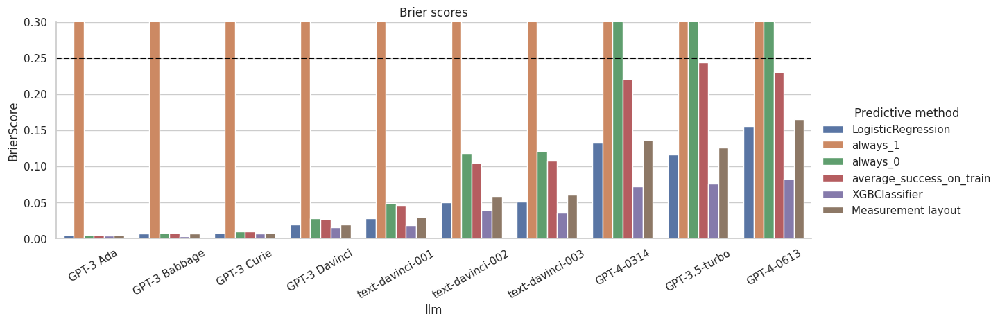

In [9]:
g = sns.catplot(x="llm", y="BrierScore", hue="predictive_method", data=predictive_methods_mes_lay_combined_df, kind="bar", height=4, aspect=3, legend_out=True)
plt.ylim(0, .3)
plt.axhline(y=0.25, color='black', linestyle='--')
plt.title("Brier scores")
plt.xticks(rotation=30)
g._legend.set_title('Predictive method')
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/brier_scores_assessors_mes_layout.png"
plt.savefig(filename, dpi=300, bbox_inches = 'tight')
plt.show()

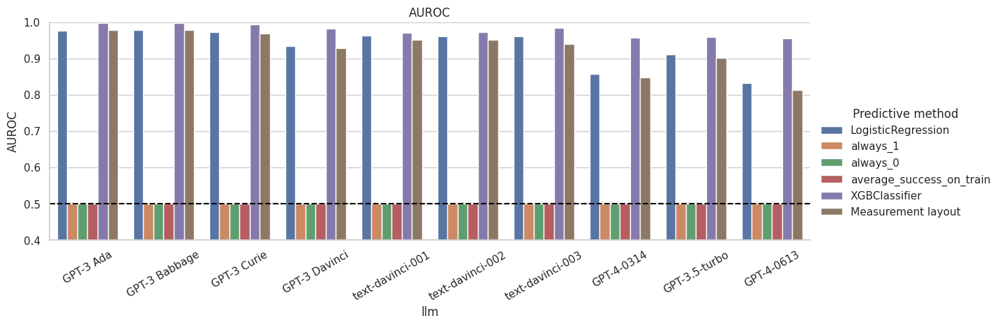

In [10]:
g = sns.catplot(x="llm", y="AUROC", hue="predictive_method", data=predictive_methods_mes_lay_combined_df, kind="bar", height=4, aspect=3,legend_out=True)
plt.ylim(0.4, 1)
plt.axhline(y=0.5, color='black', linestyle='--')
plt.title("AUROC")
plt.xticks(rotation=30)
g._legend.set_title('Predictive method')
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/auroc_scores_assessors_mes_layout.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

### Hierarchical Measurement Layout

In [28]:
import pytensor.tensor as pt

In [29]:
def setupSumModelHierarchical(data):

  m = pm.Model()
  with m:

    #hyper ability
    additionAbility = pm.Uniform("additionAbility", lower=0.0, upper=1.0)
    sampleSize_log = pm.Exponential("sampleSize_log", lam=1.5)
    sampleSize = pm.Deterministic("sampleSize", pt.exp(sampleSize_log))

    # Define abilities and their priors
    sizeAbility = pm.Beta("sizeAbility", alpha = additionAbility * sampleSize, beta = (1.0 - additionAbility) * sampleSize) ##
    carryAbility = pm.Beta("carryAbility", alpha = additionAbility * sampleSize, beta = (1.0 - additionAbility) * sampleSize) #minComplexityAbility_C, maxComplexityAbility_C
    digitVarietyAbility = pm.Beta("digitVarietyAbility", alpha = additionAbility * sampleSize, beta = (1.0 - additionAbility) * sampleSize) #minComplexityAbility_S, maxComplexityAbility_S

    # Define environment variables as MutableData
    digitsMean = pm.MutableData("digitsMean", data['harm_mean_scaled'].values)
    numCarry = pm.MutableData("numCarry", data['carry_scaled'].values)
    sumSD = pm.MutableData("sumSD", data['sum_sd_scaled'].values)

    # Margins
    sizePerformance = pm.Deterministic("sizePerformance", logistic999(margin(sizeAbility,digitsMean), min = 0, max = 1)) #logistic_slope_size k=size_slope if slopes else 1)
    carryPerformance = pm.Deterministic("carryPerformance", logistic999(margin(carryAbility,numCarry), min = 0, max = 1)) #logistic_slope_memory
    digitVarietyPerformance = pm.Deterministic("digitVarietyPerformance", logistic999(margin(digitVarietyAbility,sumSD), min = 0, max = 1)) #logistic_slope_memory

    perfList = [sizePerformance,carryPerformance,digitVarietyPerformance]
    finalPerformance =  np.prod(perfList)

    taskPerformance = pm.Bernoulli("taskPerformance", finalPerformance, observed = data['success'])

  return m

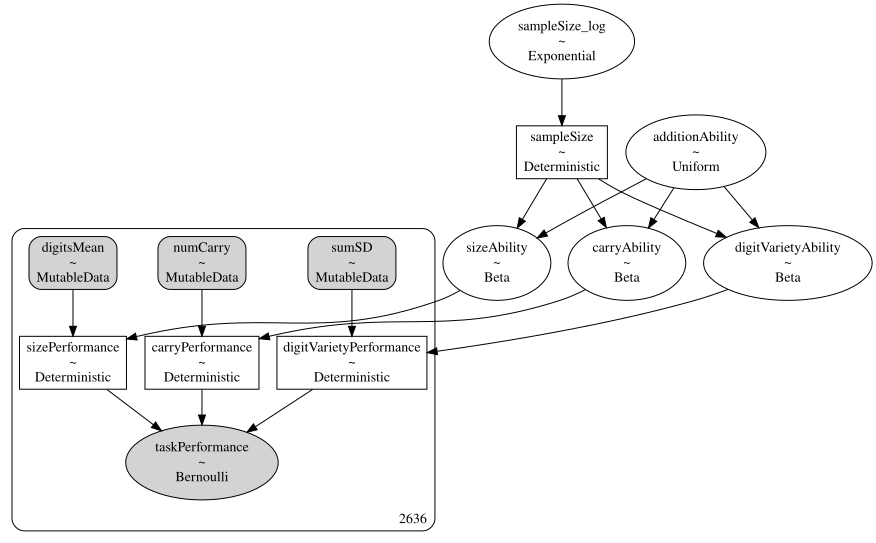

In [ ]:
LLM = 'text-davinci-003'

model_h = setupSumModelHierarchical(train_dict[LLM])
g = pm.model_to_graphviz(model_h)
g.render(filename='/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/mes_layout_h', format='png')
g

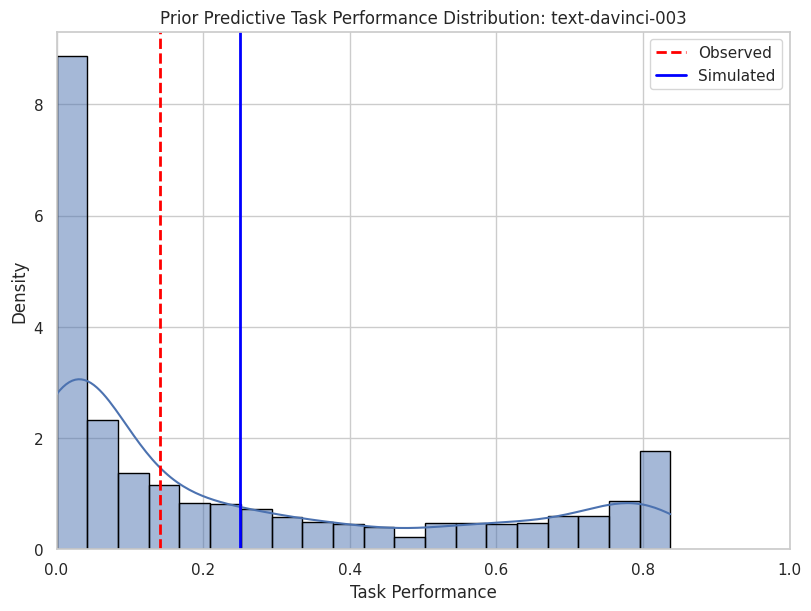

In [ ]:
with model_h:
    prior_predictive_h = pm.sample_prior_predictive(samples=2_000)

process_predictive_data_and_plot_histogram(prior_predictive_h,'prior',save=True)

In [ ]:
with model_h:
  trace_h = pm.sample(nuts_sampler="numpyro",draws = 10000, tune=2000, target_accept=0.99, chains=4)

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

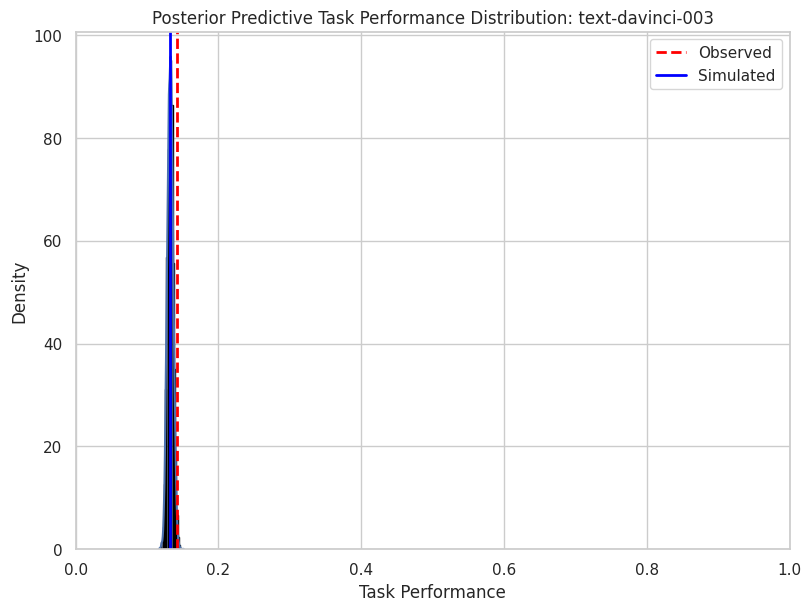

In [ ]:
with model_h:
  posterior_predictive_h = pm.sample_posterior_predictive(trace=trace_h)

process_predictive_data_and_plot_histogram(posterior_predictive_h,'posterior',save=True)

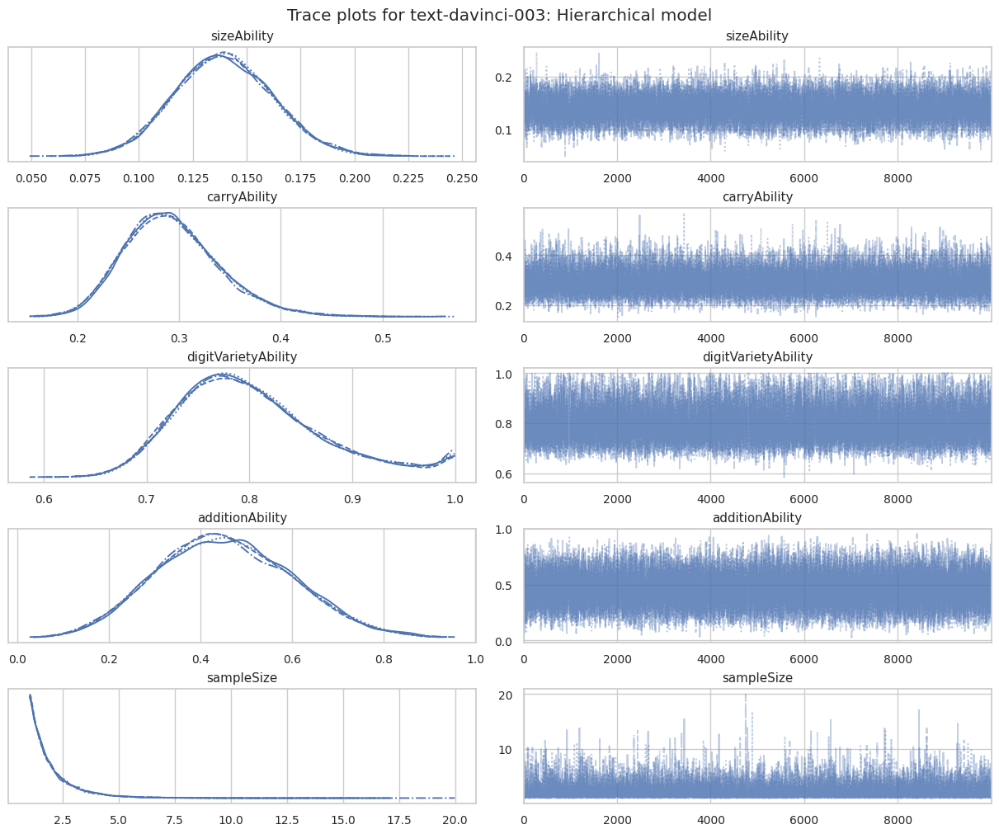

In [ ]:
abilities_h = ['sizeAbility','carryAbility','digitVarietyAbility','additionAbility','sampleSize']


axes = az.plot_trace(data=trace_h['posterior'][abilities_h])
fig = axes.ravel()[0].figure
fig.suptitle(f"Trace plots for {LLM}: Hierarchical model")
plt.rcParams['figure.constrained_layout.use'] = True
filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/trace_plots_h_{LLM}.png"
fig.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

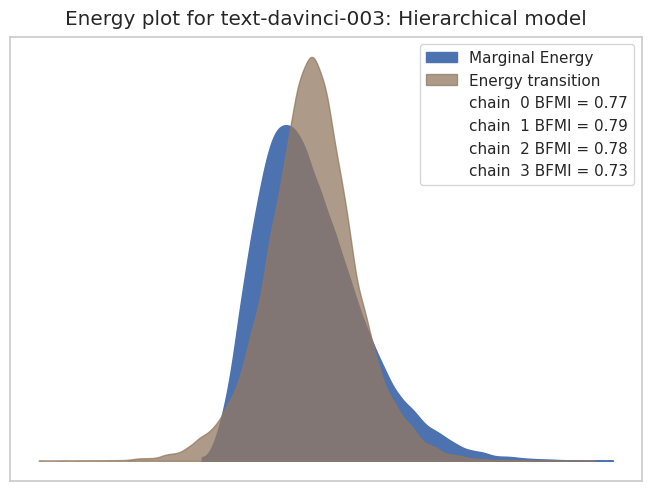

In [ ]:
axes = az.plot_energy(data=trace_h)
fig = axes.figure
fig.suptitle(f"Energy plot for {LLM}: Hierarchical model")
filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/energy_plots_h_{LLM}.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

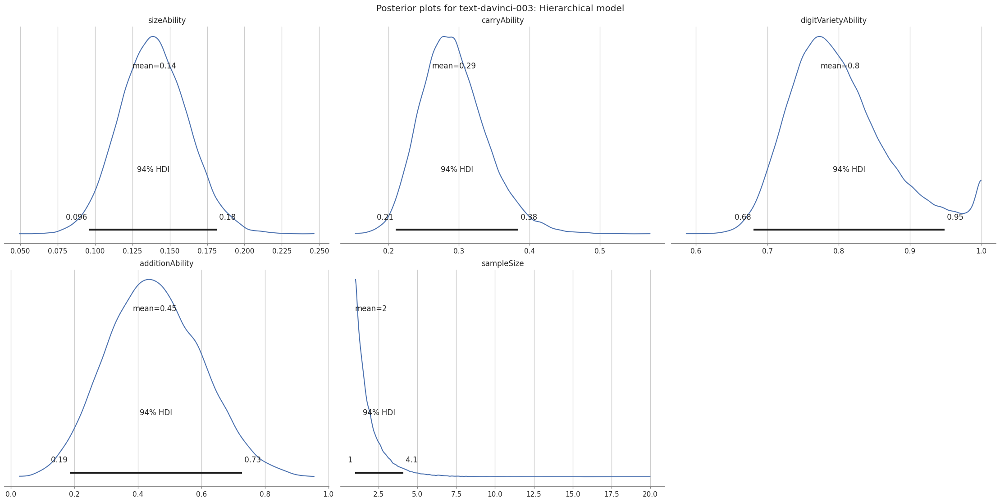

In [ ]:
axes = az.plot_posterior(data=trace_h['posterior'][abilities_h])
fig = axes.ravel()[0].figure
fig.suptitle(f"Posterior plots for {LLM}: Hierarchical model")
filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/posterior_plots_h_{LLM}.png"
fig.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
az.summary(trace_h['posterior'][abilities_h],round_to=3)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sizeAbility,0.140,0.023,0.096,0.181,0.000,0.000,14766.449,16102.168,1.0
carryAbility,0.293,0.047,0.210,0.384,0.000,0.000,17668.663,19270.194,1.0
digitVarietyAbility,0.802,0.070,0.681,0.948,0.001,0.001,10011.929,5100.502,1.0
additionAbility,0.453,0.146,0.185,0.727,0.001,0.001,21559.288,19666.890,1.0
sampleSize,2.028,1.201,1.000,4.085,0.008,0.005,13235.721,10416.813,1.0


#### Hierarchical measurment layouts for each LLM


GPT-3 Ada


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

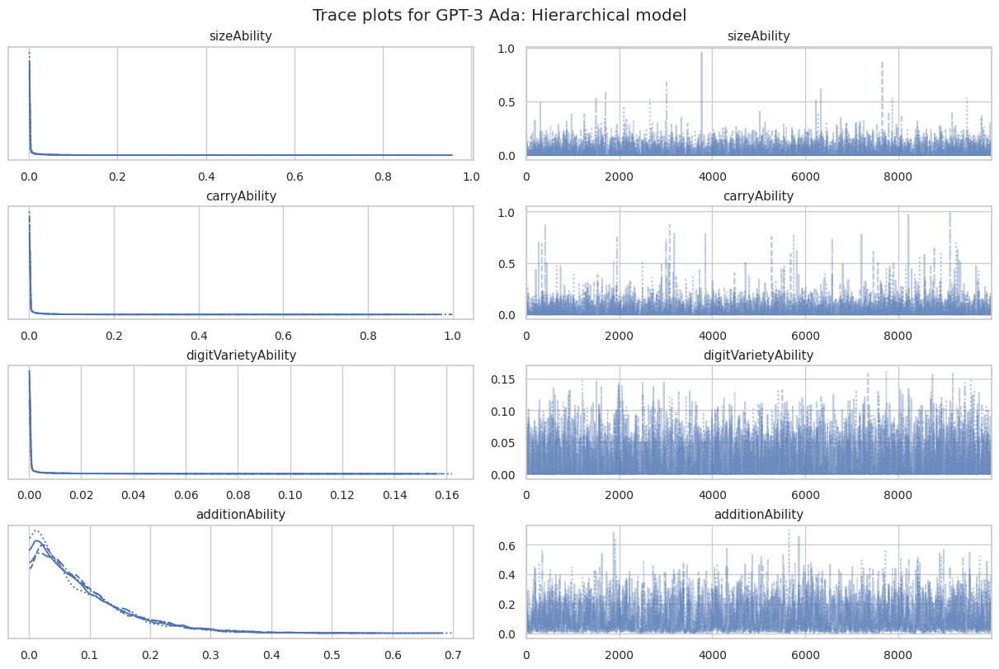

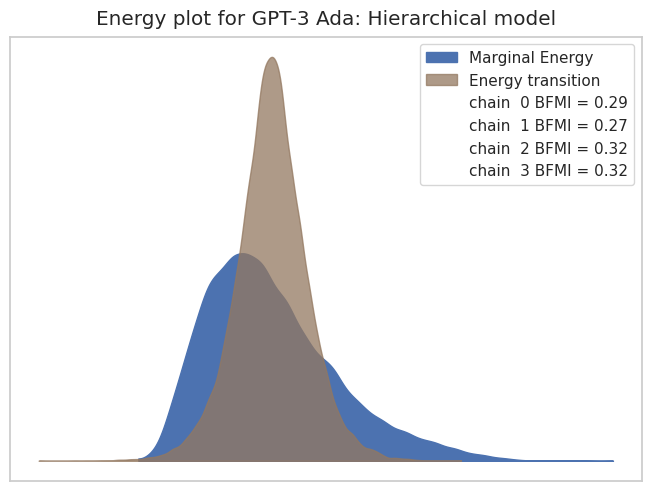

              mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
sizeAbility  0.014  0.034     0.0    0.068  1769.321  1409.093  1.003
               mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
carryAbility  0.015  0.042     0.0    0.073  1777.106  1379.675  1.003
                      mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.007  0.016     0.0    0.038   1638.54   985.123  1.002
                  mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
additionAbility  0.088  0.079     0.0    0.232  1378.849  1245.156  1.003


{'BrierScore': 0.003015330565340912, 'Calibration': 5.6936563077104635e-05, 'Refinement': 0.0030210923827945105, 'AUROC': 0.9726443768996961}

GPT-3 Babbage


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

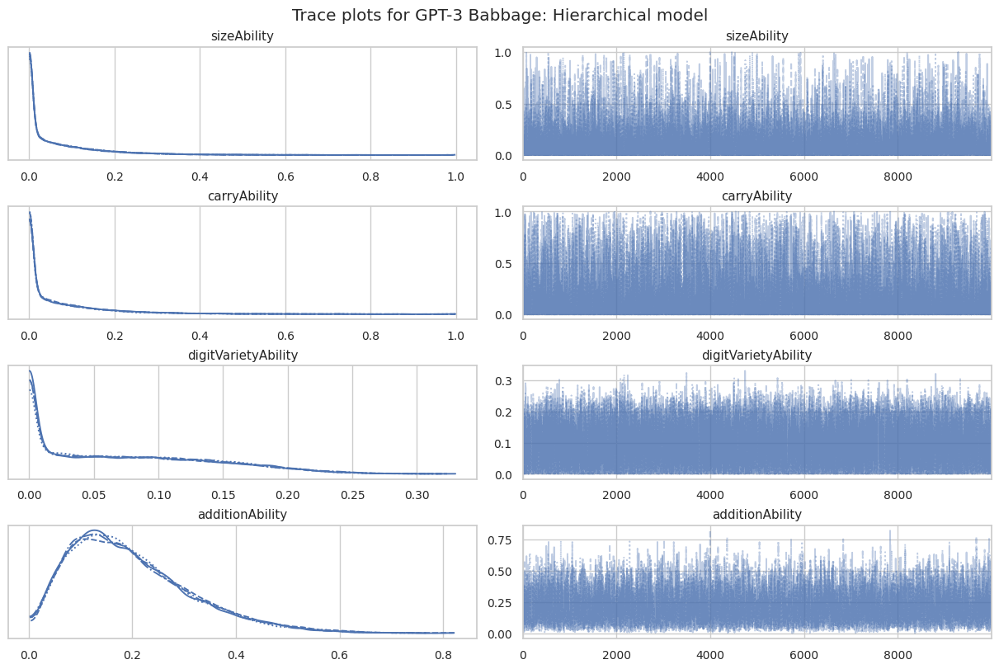

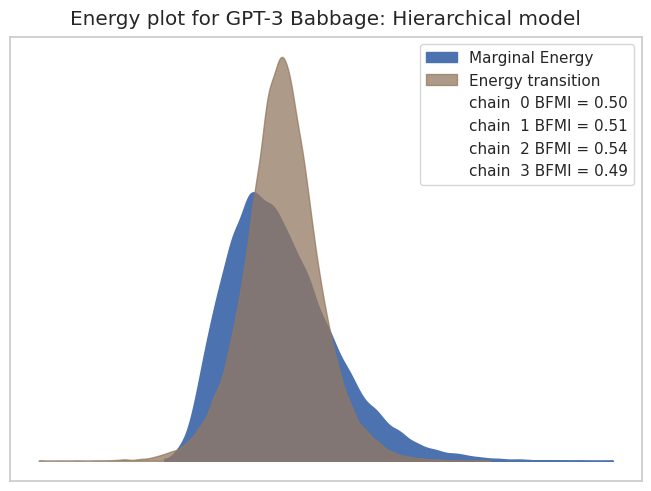

              mean     sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
sizeAbility  0.097  0.137     0.0    0.326  10548.478  5325.059    1.0
               mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
carryAbility  0.123  0.181     0.0    0.477  9671.357   4847.64    1.0
                     mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.08  0.066     0.0    0.193  8802.145    4713.7    1.0
                  mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
additionAbility  0.198  0.118   0.016    0.415  6871.068  6899.548    1.0


{'BrierScore': 0.002639213707386363, 'Calibration': 0.00035708133568683584, 'Refinement': 0.002270406979442202, 'AUROC': 0.9855623100303951}

GPT-3 Curie


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

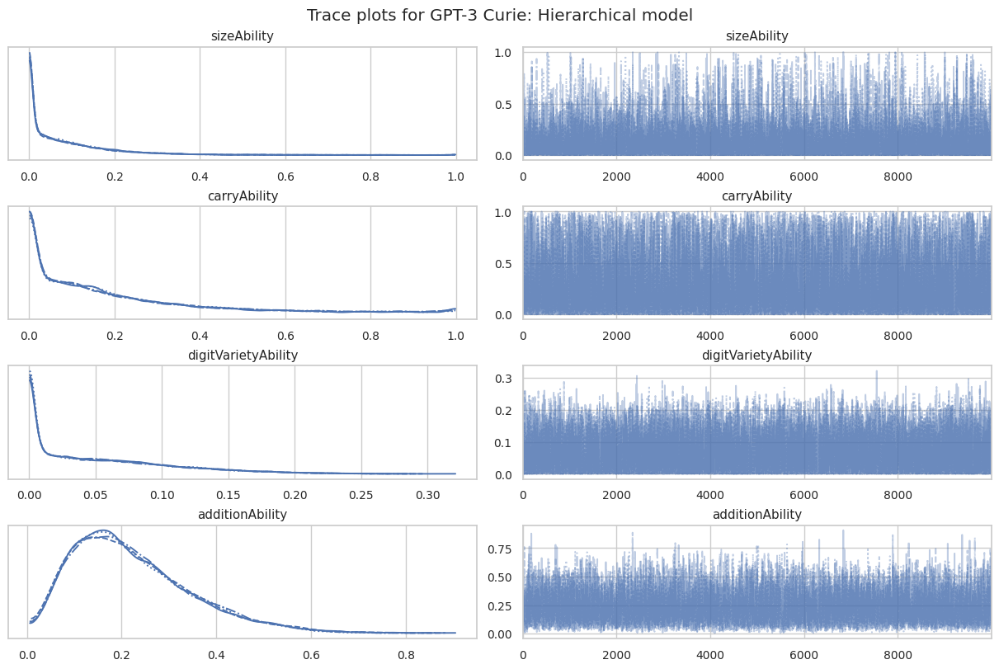

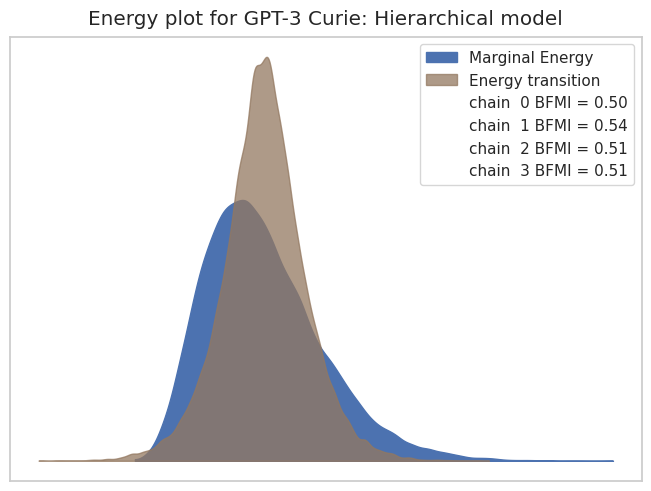

              mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
sizeAbility  0.103  0.136     0.0    0.323  7526.413  3772.308  1.001
              mean     sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
carryAbility  0.23  0.242     0.0    0.756  10577.969  5955.771  1.001
                      mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.055  0.053     0.0    0.154  6997.192  4216.008    1.0
                  mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
additionAbility  0.222  0.126   0.021    0.451  6799.295  8043.331  1.001


{'BrierScore': 0.013649875118371206, 'Calibration': 0.0004916081347752177, 'Refinement': 0.013866879807246778, 'AUROC': 0.9582307692307692}

GPT-3 Davinci


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

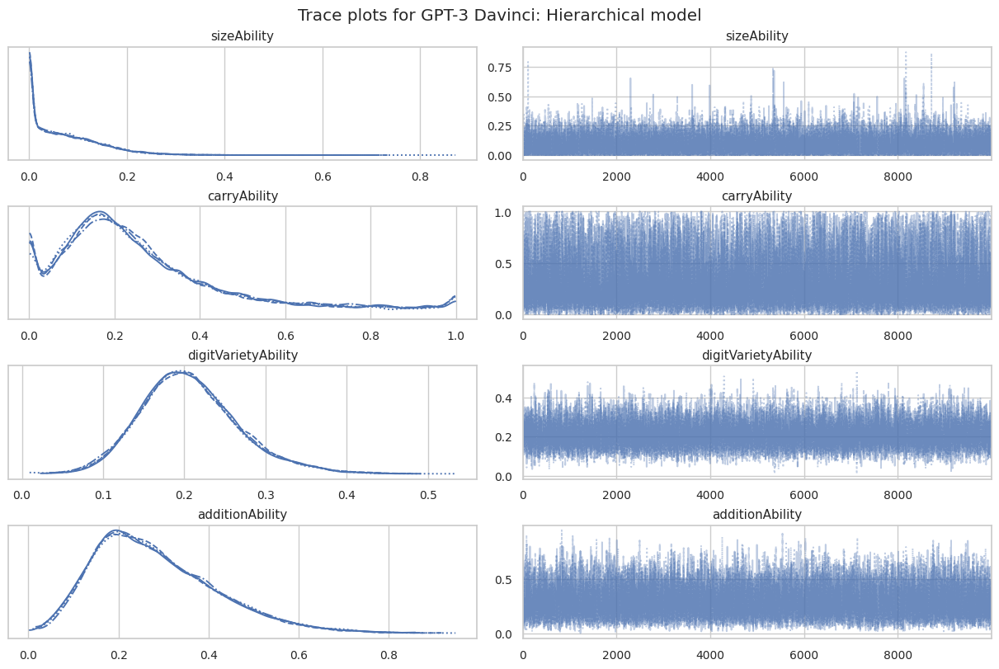

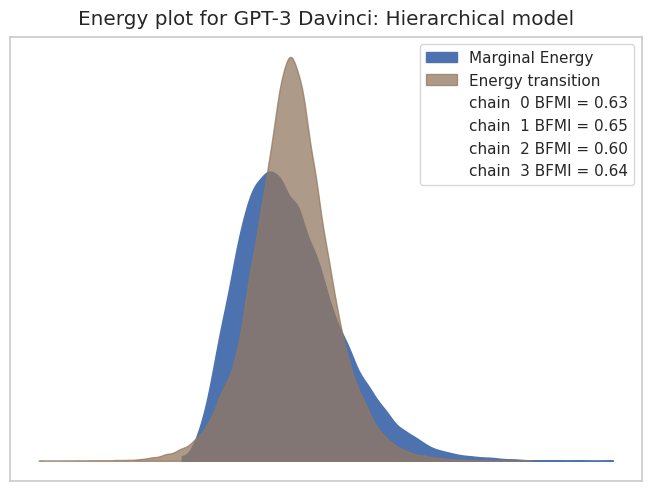

              mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
sizeAbility  0.078  0.072     0.0    0.202  8405.672  5124.387  1.001
               mean    sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
carryAbility  0.284  0.22     0.0    0.749  11739.723  7933.115    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.207  0.061   0.097    0.326  11582.449  12803.537   

                     r_hat  
digitVarietyAbility    1.0  
                  mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
additionAbility  0.282  0.136   0.059    0.538  11213.532  11411.688    1.0


{'BrierScore': 0.015709884664772737, 'Calibration': 0.0036063099243190152, 'Refinement': 0.012160248045415508, 'AUROC': 0.9440513047324194}

text-davinci-001


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

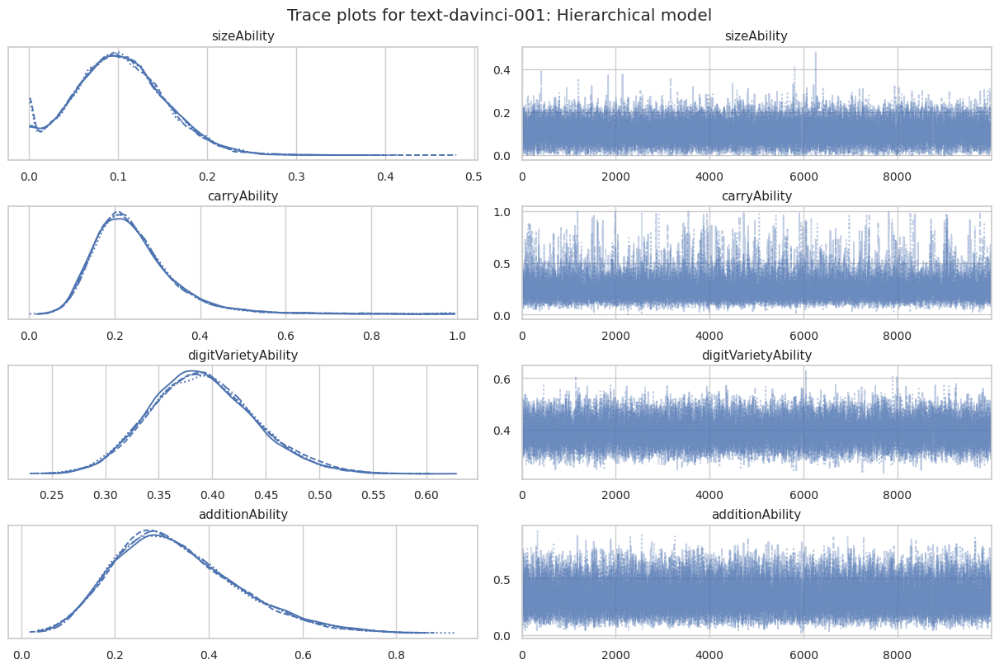

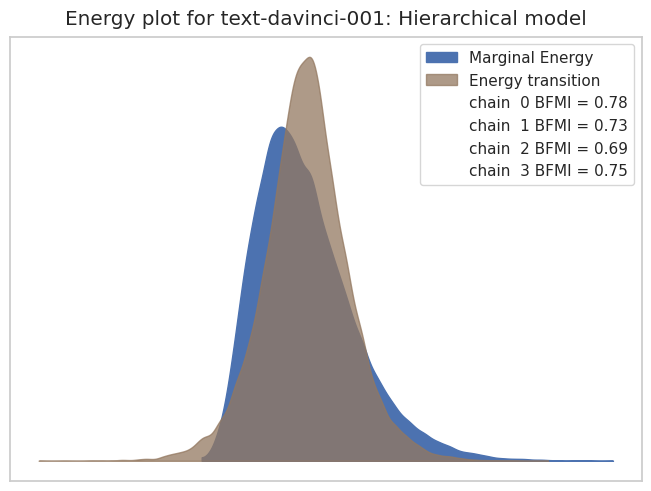

              mean    sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
sizeAbility  0.103  0.05     0.0    0.184  10635.953  5487.557    1.0
              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.25  0.113   0.082    0.439  18159.657  10871.719    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  \
digitVarietyAbility  0.391  0.049   0.301    0.484  14406.311  17397.759   

                     r_hat  
digitVarietyAbility    1.0  
                  mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
additionAbility  0.332  0.131   0.106    0.582  15841.398  13716.551    1.0


{'BrierScore': 0.03900656218181823, 'Calibration': 0.0015914753912032113, 'Refinement': 0.03790737900029344, 'AUROC': 0.9063602532502054}

text-davinci-002


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

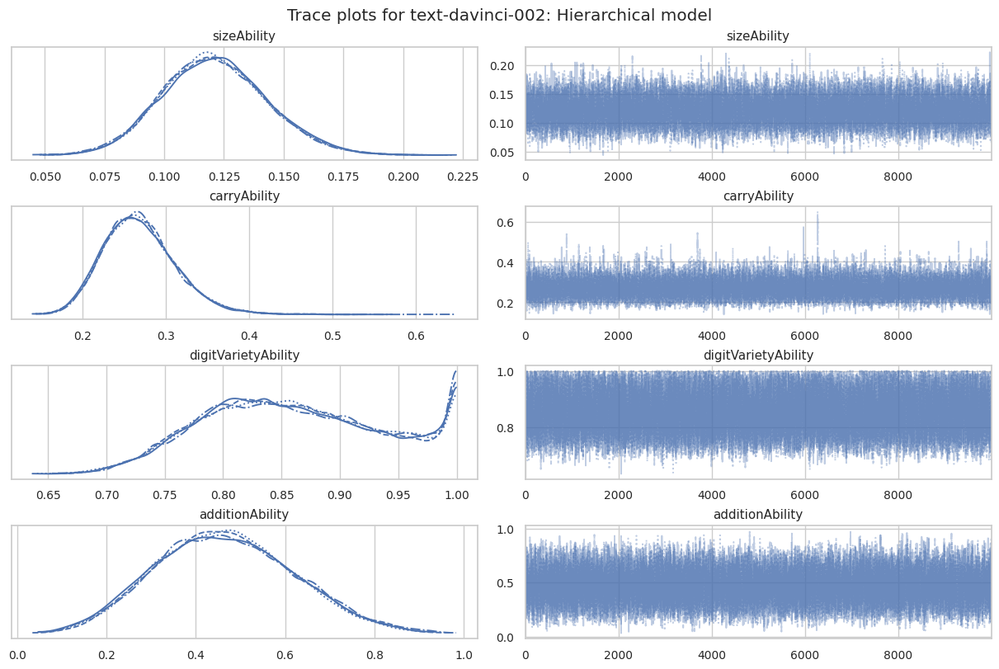

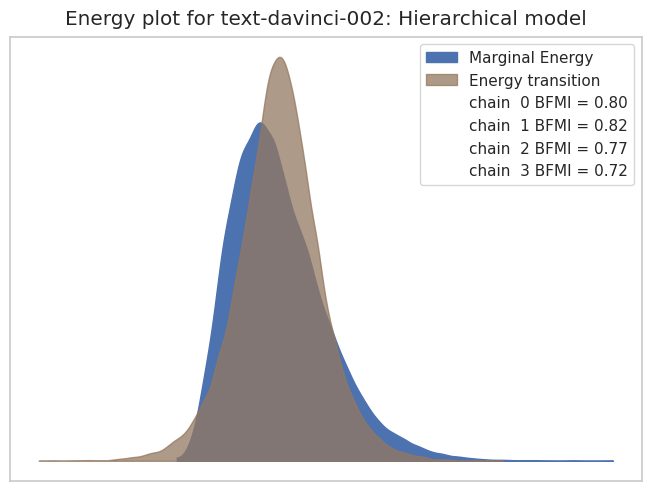

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.121  0.022    0.08    0.163  16212.451  19469.299    1.0
               mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
carryAbility  0.269  0.044    0.19    0.351  16493.962  19631.943    1.0
                      mean     sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.861  0.075   0.749      1.0  10015.217  6438.538    1.0
                  mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
additionAbility  0.466  0.153   0.183    0.749  15314.982  14199.823    1.0


{'BrierScore': 0.07314491073484845, 'Calibration': 0.012763702723568564, 'Refinement': 0.06187414384030214, 'AUROC': 0.9404089095744681}

text-davinci-003


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

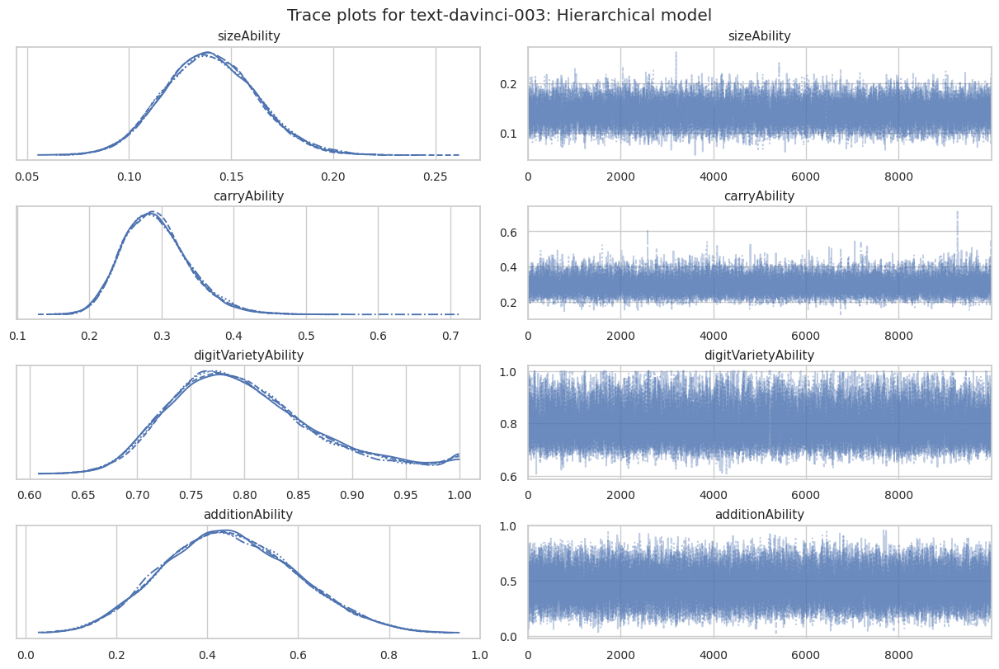

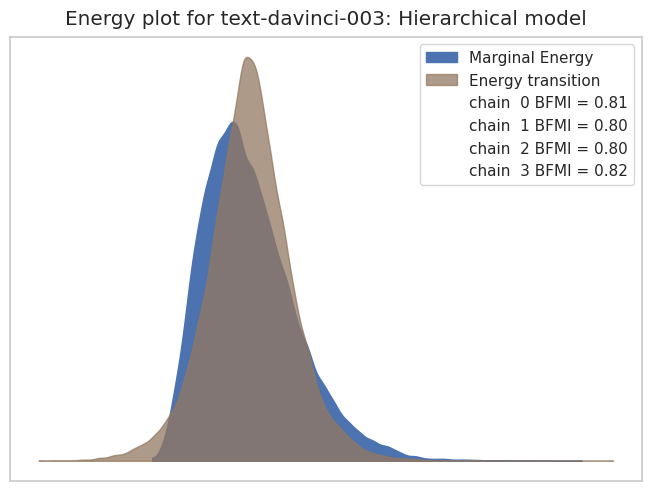

             mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.14  0.023   0.098    0.183  15424.989  16146.228    1.0
               mean     sd  hdi_3%  hdi_97%  ess_bulk   ess_tail  r_hat
carryAbility  0.293  0.047   0.211    0.383  19499.69  19713.544    1.0
                     mean     sd  hdi_3%  hdi_97%   ess_bulk  ess_tail  r_hat
digitVarietyAbility   0.8  0.069   0.683    0.941  11136.617  5667.286  1.001
                  mean     sd  hdi_3%  hdi_97%  ess_bulk   ess_tail  r_hat
additionAbility  0.452  0.144   0.191     0.73  21987.87  18757.505    1.0


{'BrierScore': 0.06780980116571961, 'Calibration': 0.008817147241330993, 'Refinement': 0.05938800639623352, 'AUROC': 0.9099204443423607}

GPT-4-0314


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

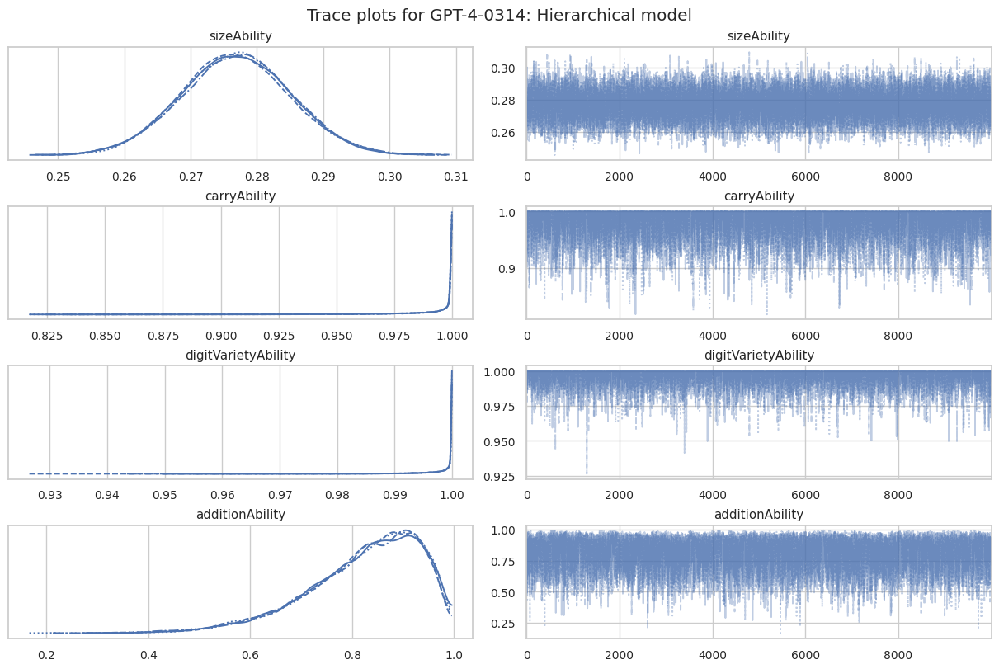

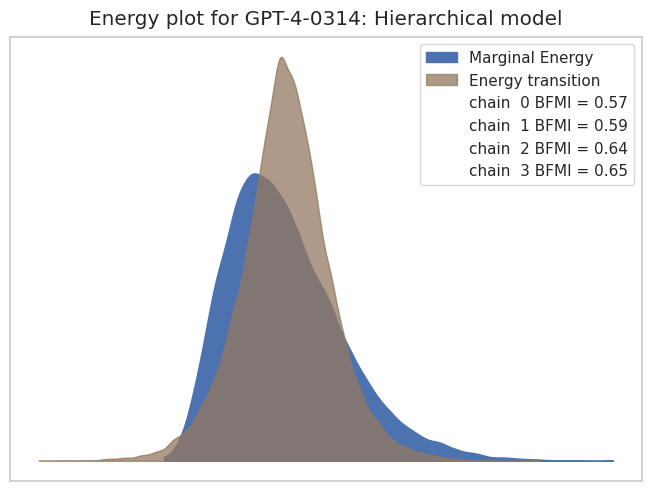

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.277  0.008   0.262    0.293  16762.245  18048.595    1.0
              mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
carryAbility  0.99  0.019   0.956      1.0  5369.927  3198.548    1.0
                      mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.998  0.004    0.99      1.0  4758.284  2734.183    1.0
                  mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
additionAbility  0.822  0.112    0.62     0.99  4294.413    4190.2    1.0


{'BrierScore': 0.14783764402367433, 'Calibration': 0.011155949198316115, 'Refinement': 0.13576277202694717, 'AUROC': 0.8141181166041738}

GPT-3.5-turbo


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

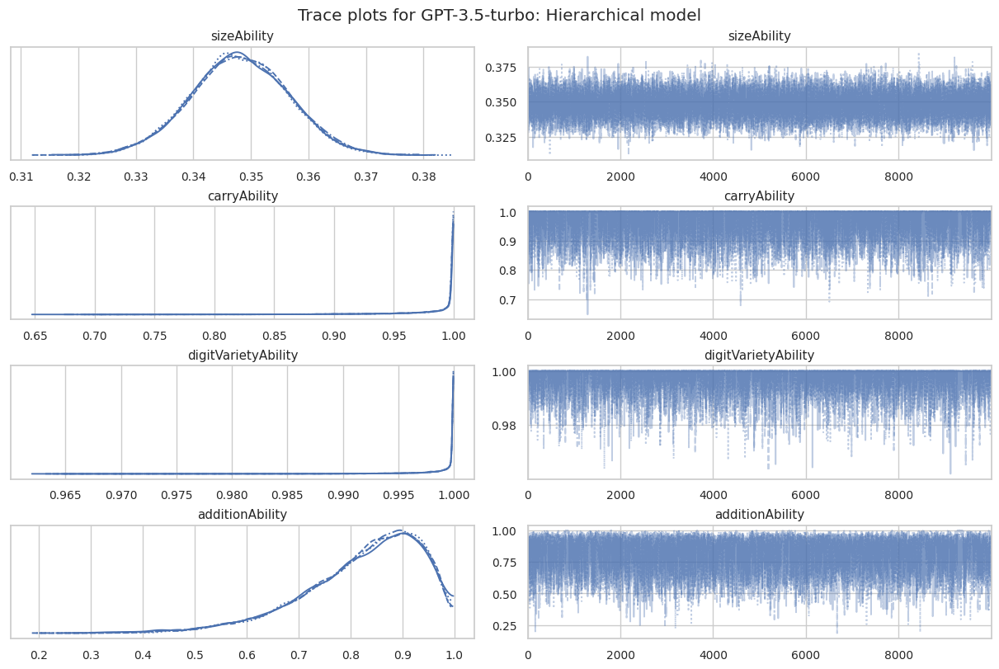

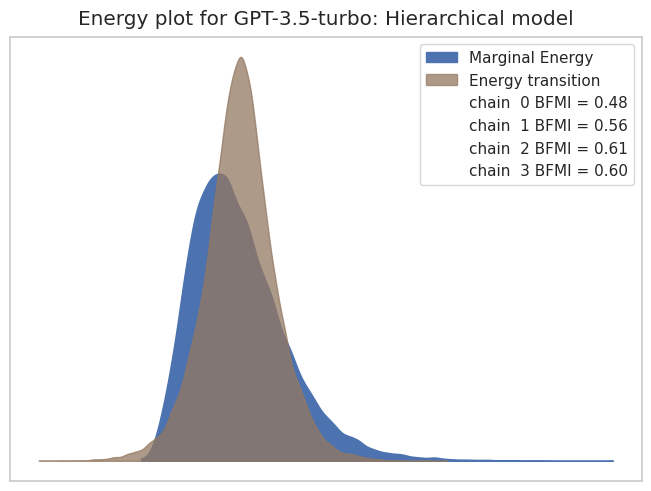

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.348  0.008   0.332    0.364  14778.591  16691.593    1.0
              mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
carryAbility  0.98  0.037   0.907      1.0  3814.328  1906.886    1.0
                      mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.998  0.003   0.993      1.0  4098.984  2058.426    1.0
                  mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
additionAbility  0.824  0.113   0.621    0.997  3288.457  2357.972    1.0


{'BrierScore': 0.13774662865435622, 'Calibration': 0.004177190077101312, 'Refinement': 0.1343925440742986, 'AUROC': 0.8804183129387395}

GPT-4-0613


  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

  0%|          | 0/12000 [00:00<?, ?it/s]

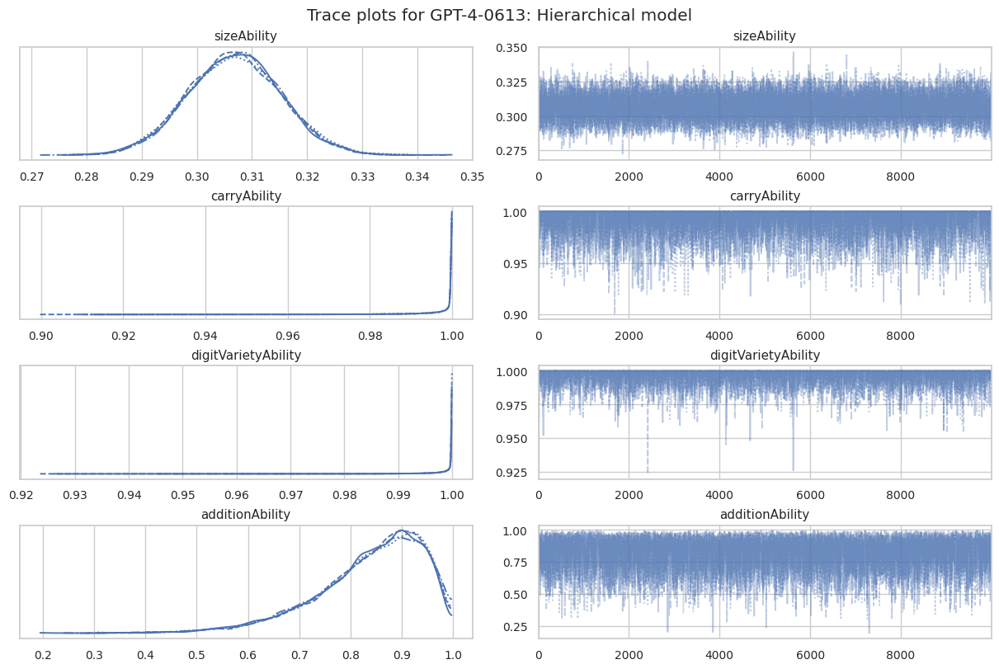

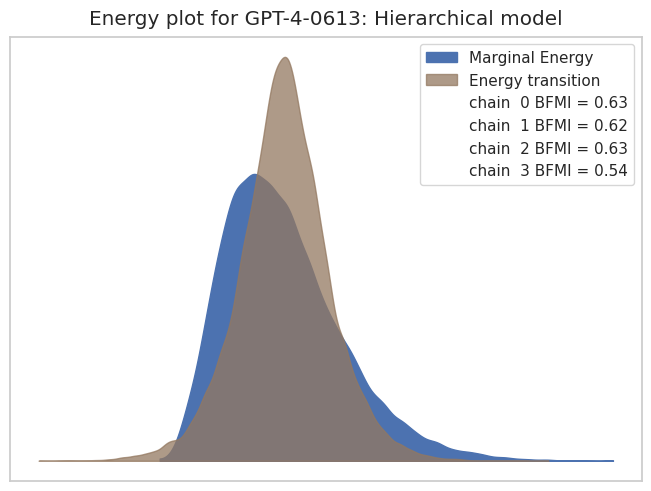

              mean     sd  hdi_3%  hdi_97%   ess_bulk   ess_tail  r_hat
sizeAbility  0.307  0.008    0.29    0.322  15157.327  16810.461  1.001
               mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
carryAbility  0.996  0.008   0.981      1.0  5947.716  3236.361    1.0
                      mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
digitVarietyAbility  0.998  0.004   0.992      1.0  5440.476  3633.602    1.0
                  mean     sd  hdi_3%  hdi_97%  ess_bulk  ess_tail  r_hat
additionAbility  0.837  0.105   0.648    0.993  5138.334  4763.228    1.0


{'BrierScore': 0.15287582649905304, 'Calibration': 0.006818041901751156, 'Refinement': 0.14651698812298836, 'AUROC': 0.8241563675175311}


In [ ]:
scores_dict_h = {}
metrics_dict_h = {}
probabilities_h = {}
list_features = ['harm_mean_scaled','carry_art_mean_ratio_scaled','sum_sd_scaled']
abilities_h = ['sizeAbility','carryAbility','digitVarietyAbility','additionAbility']
predictive_methods_df_mes_lay_h = pd.DataFrame()

for llm in llms:
    print(f'\n{llm}')

    m_llm = setupSumModelHierarchical(train_dict[llm])

    with m_llm:
      llm_trace_h = pm.sample(nuts_sampler="numpyro", draws = 10000, tune = 2000, target_accept=0.99, chains=4) #pm.sample(10000, target_accept = 0.99, chains = 4)

    #Save the trace
    llm_trace_h.to_netcdf(f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Traces/trace_addition_data_h_{llm}.nc")

    # Plot the trace plot on the first subplot
    axes = az.plot_trace(data=llm_trace_h['posterior'][abilities_h])
    fig = axes.ravel()[0].figure
    fig.suptitle(f"Trace plots for {llm}: Hierarchical model")
    plt.rcParams['figure.constrained_layout.use'] = True
    filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/trace_plots_h_{llm}.png"
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

    axes = az.plot_energy(data=llm_trace_h)
    fig = axes.figure
    fig.suptitle(f"Energy plot for {llm}: Hierarchical model")
    filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/energy_plots_h_{llm}.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

    metrics_dict_h[llm] = {}

    for ability in abilities_h:

        summary = az.summary(llm_trace_h['posterior'][ability], round_to=3)

        metrics_dict_h[llm][ability] = {
                'mean': summary['mean'][0],
                'hdi_3%': summary['hdi_3%'][0],
                'hdi_97%': summary['hdi_97%'][0],
                'ess_bulk': summary['ess_bulk'][0],
                'ess_tail': summary['ess_tail'][0],
                'r_hat': summary['r_hat'][0],
        }
        print(summary[['mean','sd','hdi_3%','hdi_97%','ess_bulk','ess_tail','r_hat']])

    m_llm = setupSumModel(test_dict[llm])

    predictions = predict(m_llm, llm_trace_h, test_dict[llm][list_features])

    probabilities_h[llm] = predictions

    modelBrierScore, modelCalibration, modelRefinement = brierDecomp(predictions, test_dict[llm]['success'])
    roc_auc = roc_auc_score(test_dict[llm]['success'], predictions)


    scores_dict_h[llm] = {'BrierScore': modelBrierScore, 'Calibration':modelCalibration,'Refinement':modelRefinement,'AUROC':roc_auc}
    print(scores_dict_h[llm])

    predictive_methods_df_mes_lay_h = pd.concat([predictive_methods_df_mes_lay_h, pd.DataFrame({"predictive_method": 'Measurement layout', "llm": llm, "BrierScore": modelBrierScore, "Calibration": modelCalibration, "Refinement": modelRefinement, "AUROC": roc_auc}, index=[0])])

In [ ]:
#save scores
predictive_methods_mes_lay_h_combined_df = pd.concat([predictive_methods_mes_lay_combined_df,predictive_methods_df_mes_lay_h])
predictive_methods_mes_lay_h_combined_df.to_pickle("/content/drive/MyDrive/Colab Notebooks/Addition_data/predictive_methods_mes_lay_h.pkl")

#### Load traces if needed


 GPT-3 Ada


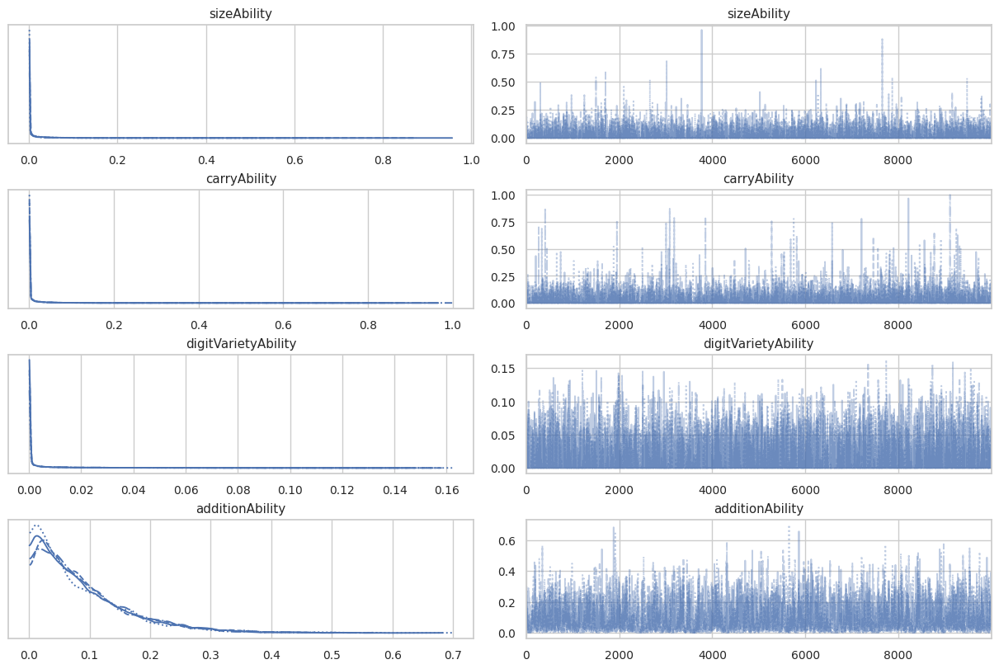

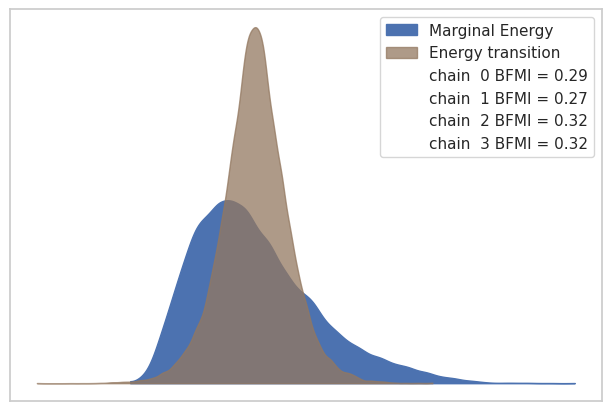


 GPT-3 Babbage


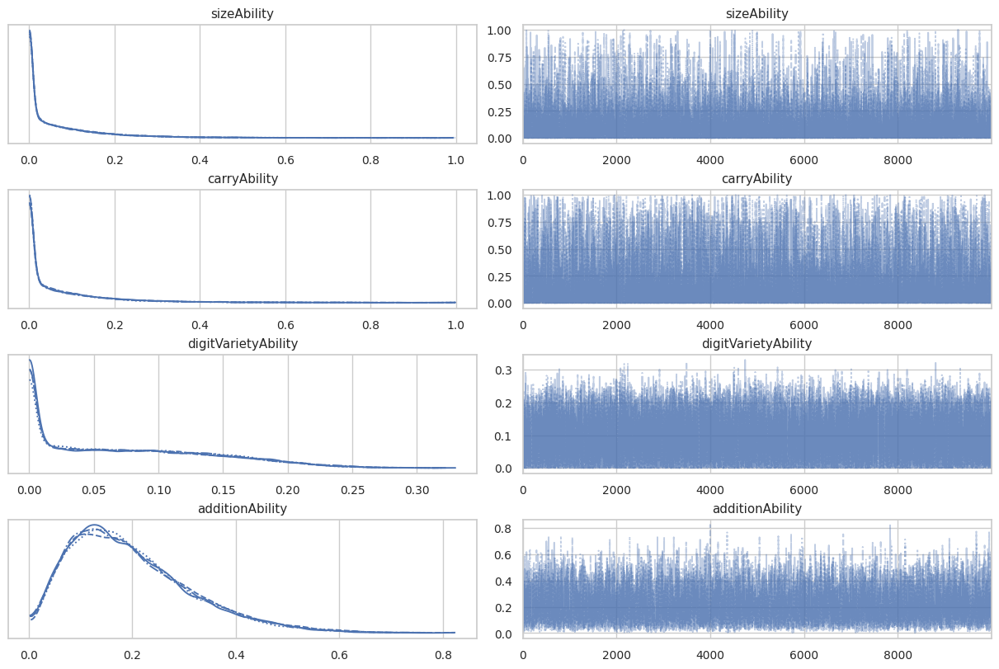

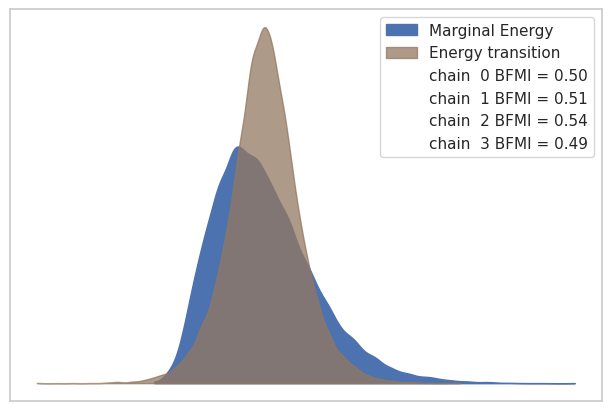


 GPT-3 Curie


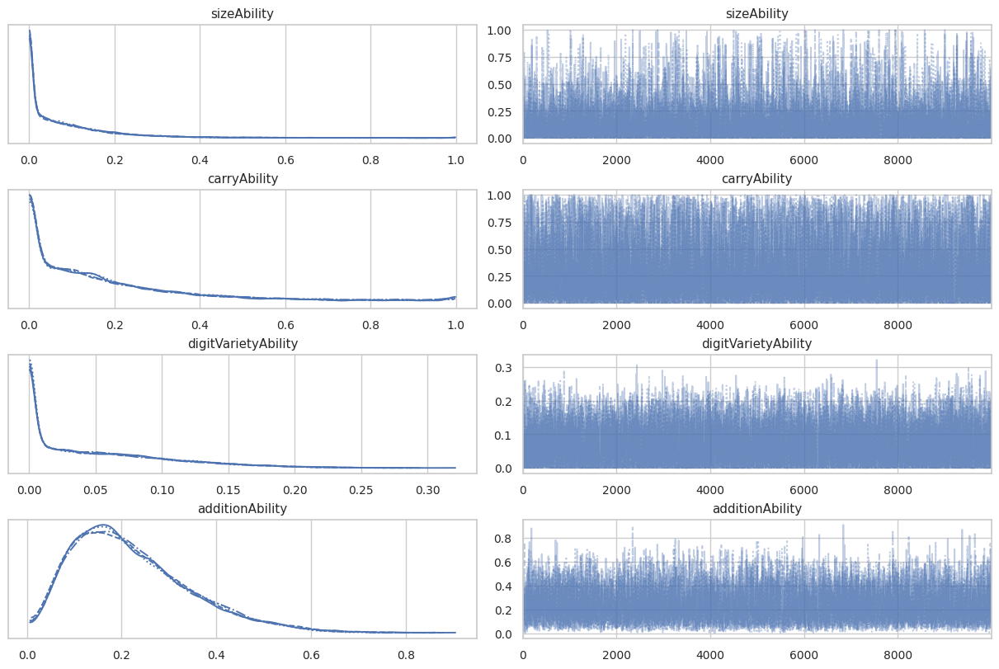

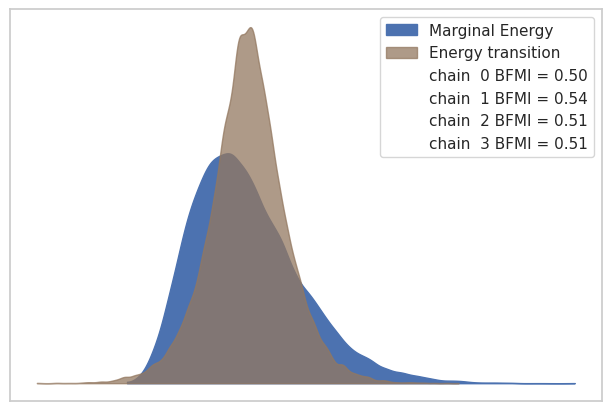


 GPT-3 Davinci


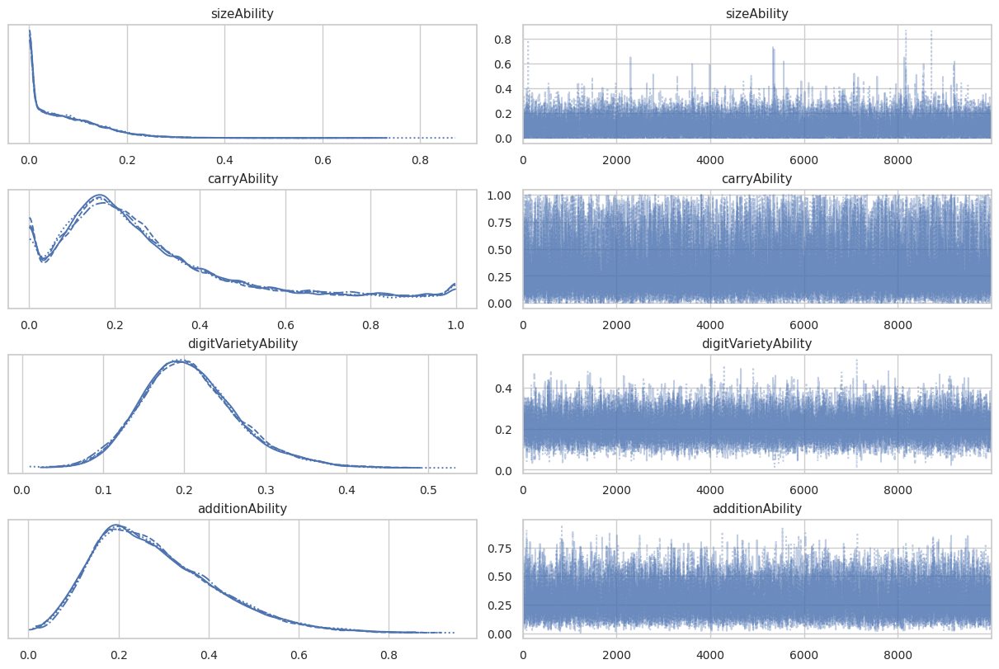

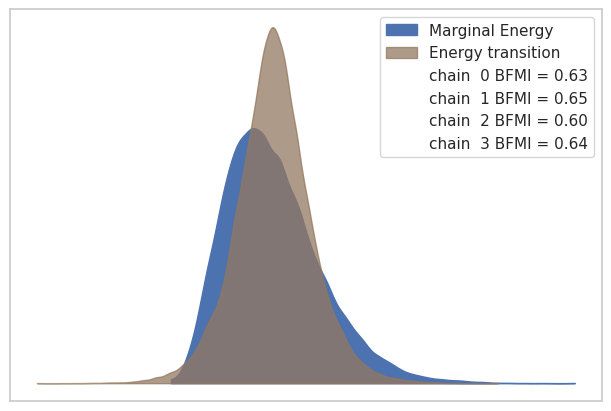


 text-davinci-001


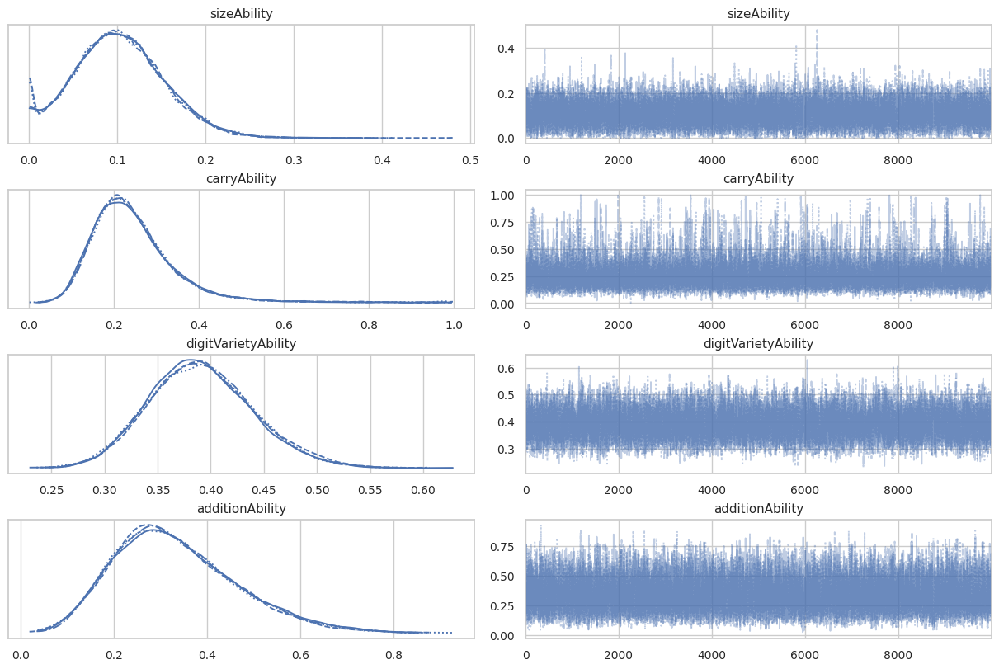

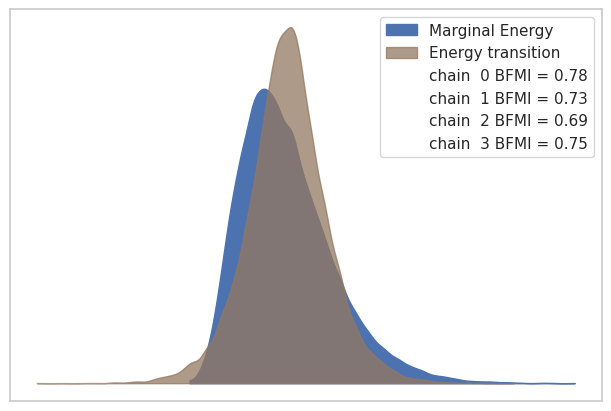


 text-davinci-002


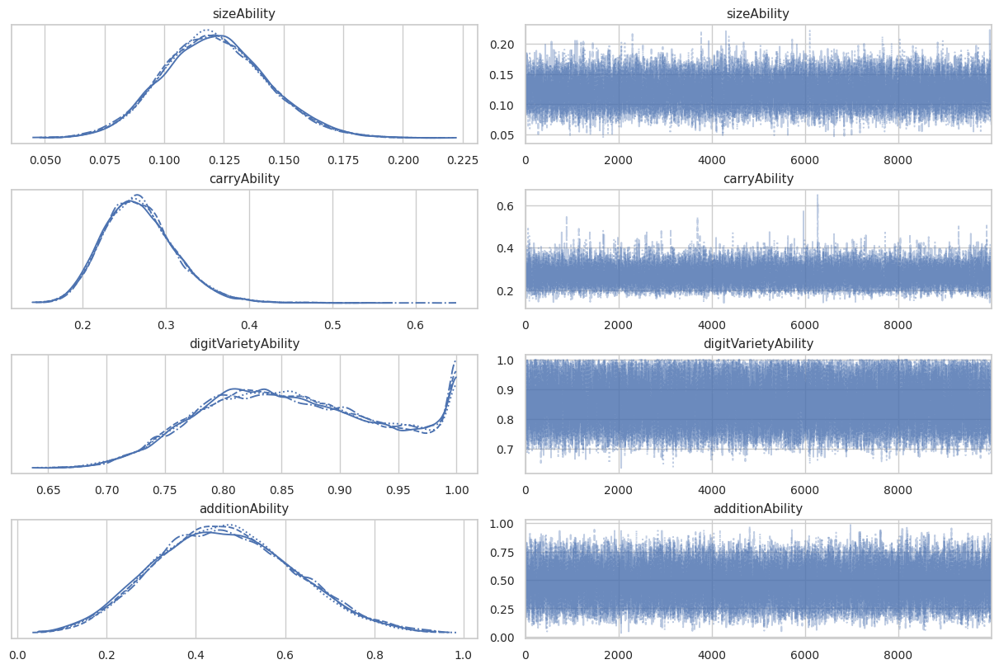

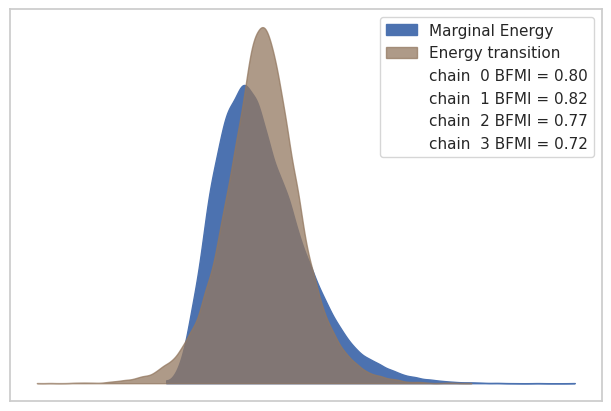


 text-davinci-003


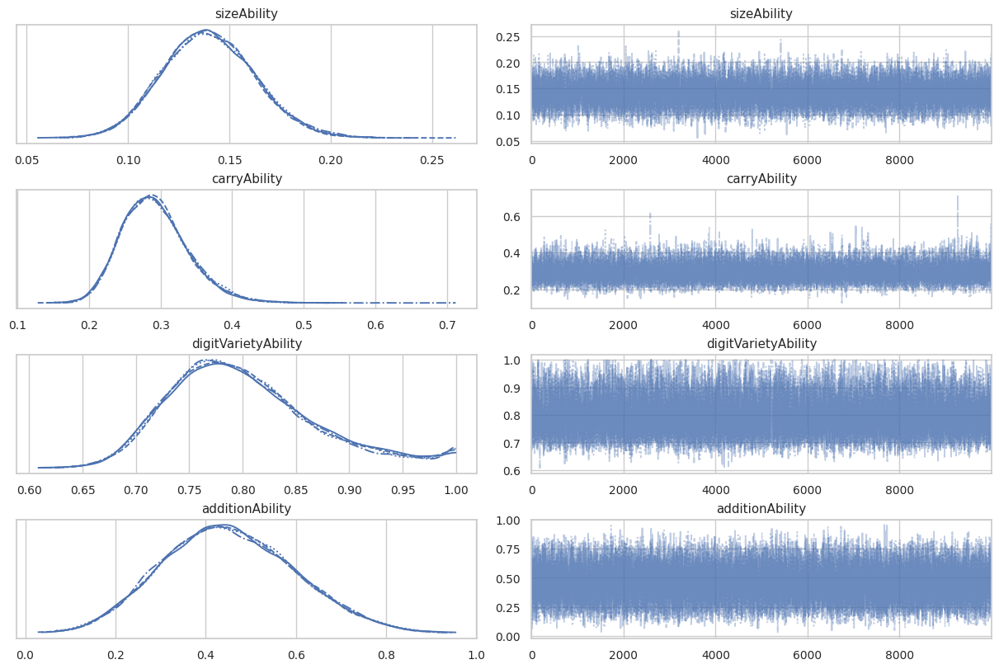

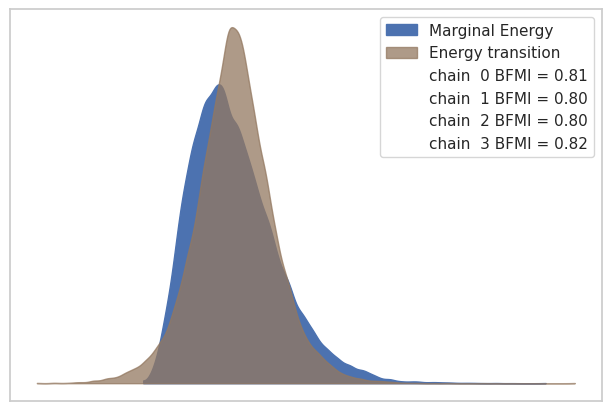


 GPT-4-0314


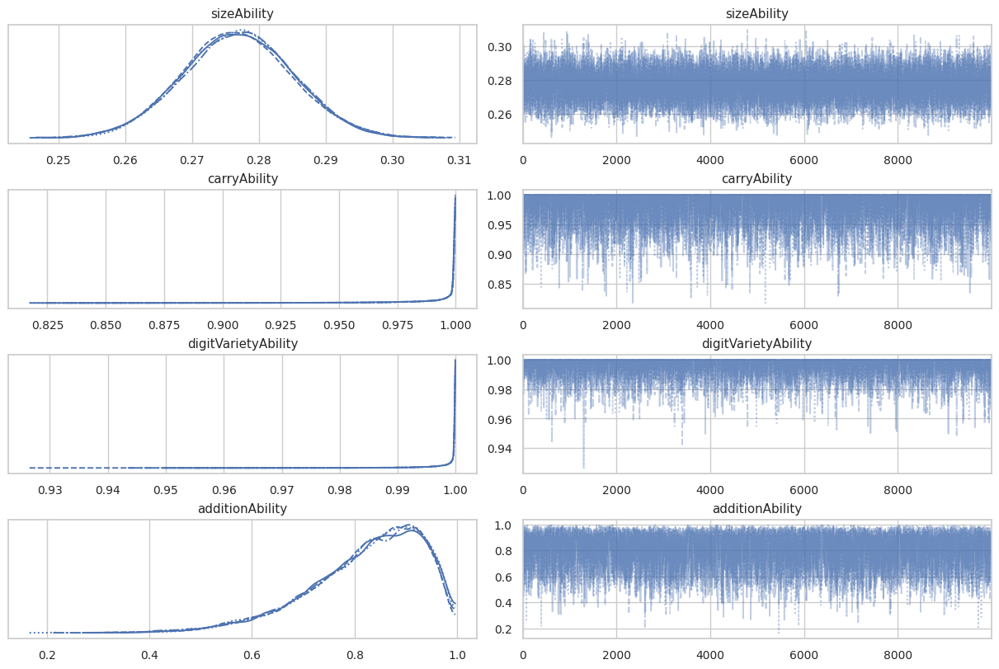

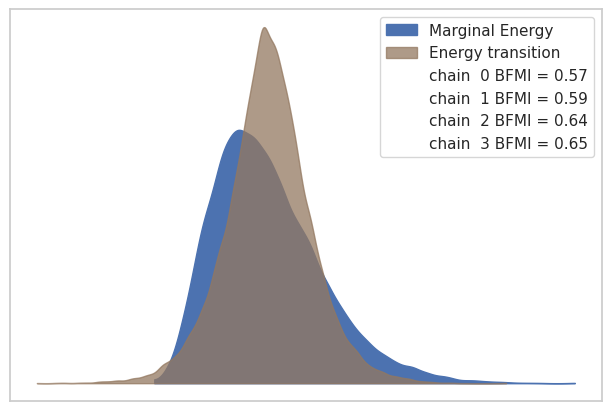


 GPT-3.5-turbo


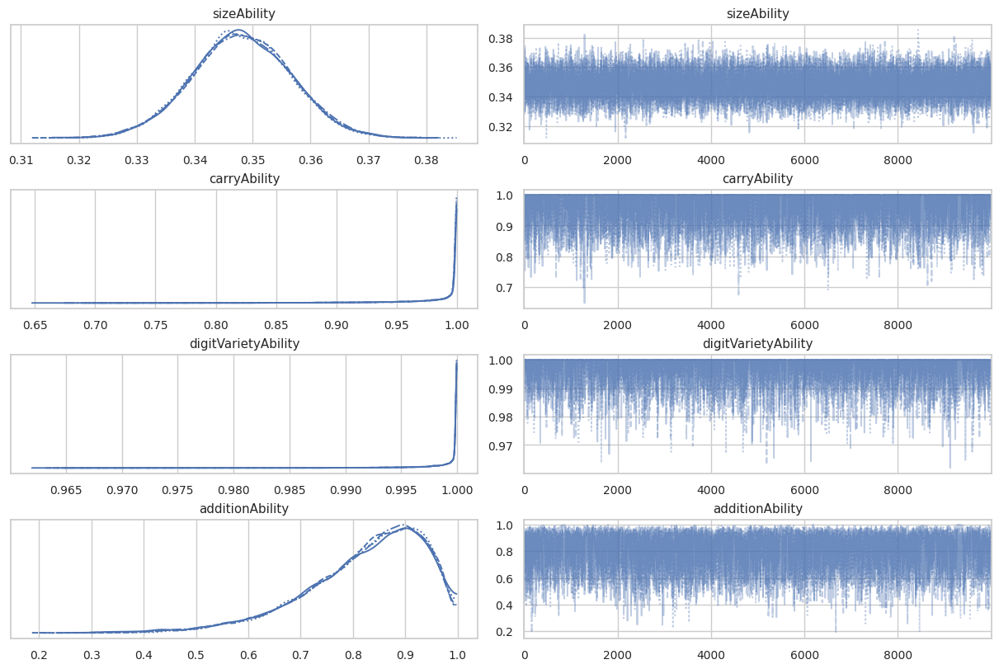

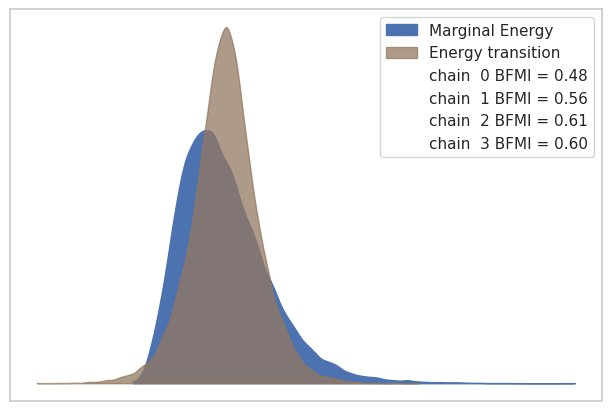


 GPT-4-0613


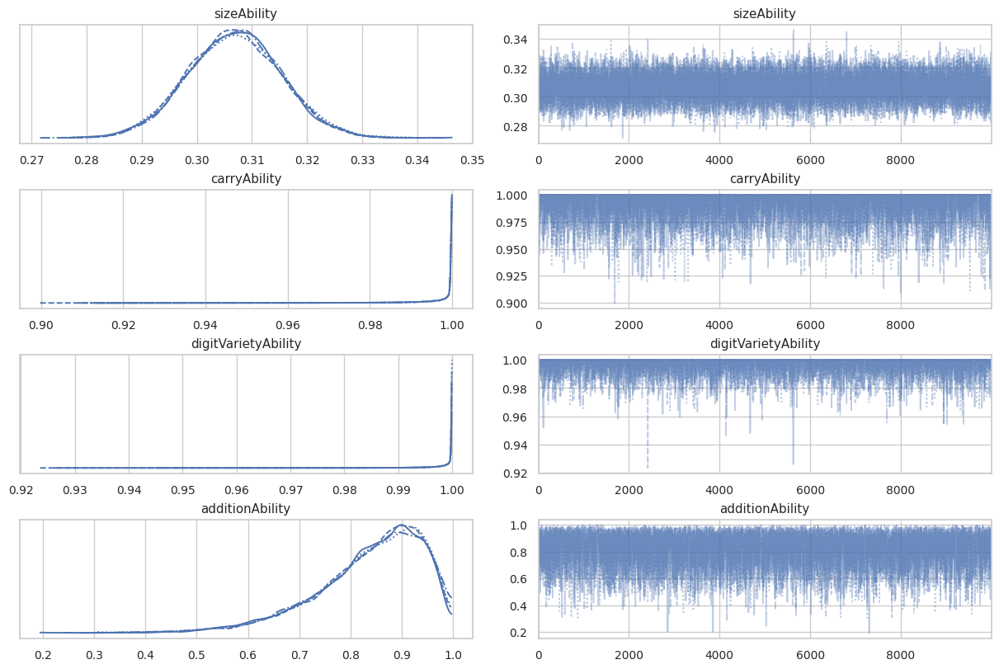

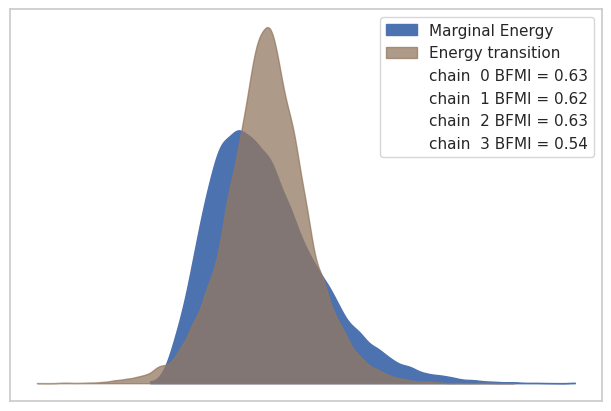

In [30]:
llms = addition_data['llm'].unique()
scores_dict_h = {}
metrics_dict_h = {}
probabilities_h = {}
list_features = ['harm_mean_scaled','sum_sd_scaled','carry_art_mean_ratio_scaled']
abilities_h = ['sizeAbility','carryAbility','digitVarietyAbility','additionAbility']
predictive_methods_df_mes_lay_h = pd.DataFrame()

for llm in llms:
    print(f'\n {llm}')
    #Load the trace
    with az.rc_context(rc={"data.load": "eager"}):
      llm_trace = az.from_netcdf(f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Traces/trace_addition_data_h_{llm}.nc")

    # Plot the trace plot on the first subplot
    az.plot_trace(data=llm_trace['posterior'][abilities_h])
    plt.rcParams['figure.constrained_layout.use'] = True
    fig, ax = plt.subplots(figsize=(6, 4))
    # Plot the energy plot on the second subplot
    az.plot_energy(data=llm_trace, ax=ax)
    plt.show()

    metrics_dict_h[llm] = {}

    for ability in abilities_h:

        summary = az.summary(llm_trace['posterior'][ability], round_to=3)

        metrics_dict_h[llm][ability] = {
                'mean': summary['mean'][0],
                'hdi_3%': summary['hdi_3%'][0],
                'hdi_97%': summary['hdi_97%'][0],
                'ess_bulk': summary['ess_bulk'][0],
                'ess_tail': summary['ess_tail'][0],
                'r_hat': summary['r_hat'][0],
        }

    m_llm = setupSumModelHierarchical(test_dict[llm])

    predictions = predict(m_llm, llm_trace, test_dict[llm][list_features])

    probabilities_h[llm] = predictions

    modelBrierScore, modelCalibration, modelRefinement = brierDecomp(predictions, test_dict[llm]['success'])
    roc_auc = roc_auc_score(test_dict[llm]['success'], predictions)
    ap = average_precision_score(test_dict[llm]['success'], predictions)


    scores_dict_h[llm] = {'BrierScore': modelBrierScore, 'Calibration':modelCalibration,'Refinement':modelRefinement,'AUROC':roc_auc}

    predictive_methods_df_mes_lay_h = pd.concat([predictive_methods_df_mes_lay_h, pd.DataFrame({"predictive_method": 'Measurement layout: hierarchical', "llm": llm, "BrierScore": modelBrierScore, "Calibration": modelCalibration, "Refinement": modelRefinement, "AUROC": roc_auc}, index=[0])])

In [41]:
#save scores
predictive_methods_mes_lay_h_combined_df = pd.concat([predictive_methods_mes_lay_combined_df,predictive_methods_df_mes_lay_h])
predictive_methods_mes_lay_h_combined_df.to_pickle("/content/drive/MyDrive/Colab Notebooks/Addition_data/predictive_methods_mes_lay_h.pkl")

#### Convergence metrics

In [31]:
data_for_df = []
for llm, abilities_h in metrics_dict_h.items():
    for ability, metrics in abilities_h.items():
        row = (llm, ability, metrics.get('ess_bulk'), metrics.get('ess_tail'), metrics.get('r_hat'))
        data_for_df.append(row)

# Creating the DataFrame
df = pd.DataFrame(data_for_df, columns=['LLM', 'Ability', 'ess_bulk', 'ess_tail', 'r_hat'])

# Setting LLM and Ability as the index if desired
df.set_index(['LLM', 'Ability'], inplace=True)

# Display the DataFrame
print(df)

                                       ess_bulk   ess_tail  r_hat
LLM              Ability                                         
GPT-3 Ada        sizeAbility           1769.321   1409.093  1.003
                 carryAbility          1777.106   1379.675  1.003
                 digitVarietyAbility   1638.540    985.123  1.002
                 additionAbility       1378.849   1245.156  1.003
GPT-3 Babbage    sizeAbility          10548.478   5325.059  1.000
                 carryAbility          9671.357   4847.640  1.000
                 digitVarietyAbility   8802.145   4713.700  1.000
                 additionAbility       6871.068   6899.548  1.000
GPT-3 Curie      sizeAbility           7526.413   3772.308  1.001
                 carryAbility         10577.969   5955.771  1.001
                 digitVarietyAbility   6997.192   4216.008  1.000
                 additionAbility       6799.295   8043.331  1.001
GPT-3 Davinci    sizeAbility           8405.672   5124.387  1.001
          

#### Visualise abilities

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
<ipython-input-33-9ef38a44a5a4>:32: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  g.fig.subplots_adjust(top=0.9)


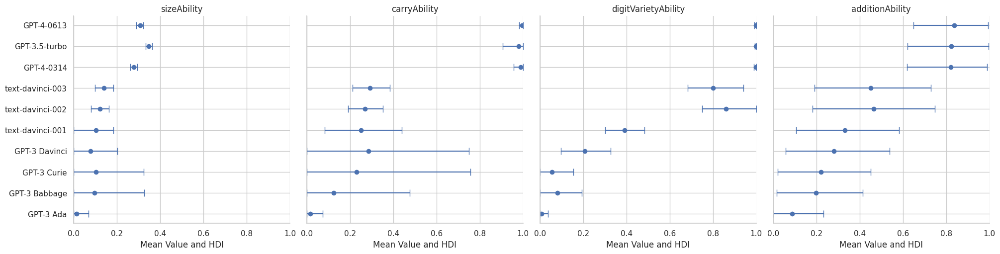

In [33]:
# Prepare the DataFrame from the provided dictionary
rows = []
for model, abilities_h in metrics_dict_h.items():
    for ability, stats in abilities_h.items():
        rows.append({
            'LLM': model,
            'Ability': ability,
            'Mean': stats['mean'],
            'Lower': stats['hdi_3%'],
            'Upper': stats['hdi_97%']
        })
df = pd.DataFrame(rows)

# Define a custom plotting function for use with FacetGrid
def plot_with_errorbars(data, **kwargs):
    # Calculate the error terms as positive and negative deviations from the mean
    errors = [data['Mean'] - data['Lower'], data['Upper'] - data['Mean']]
    y_positions = range(len(data))  # Y positions for each LLM

    # Plotting the mean with error bars on the y-axis
    plt.errorbar(data['Mean'], y_positions, xerr=errors, fmt='o', capsize=5, **kwargs)
    plt.yticks(y_positions, data['LLM'])  # Set LLM names as y-ticks
    #plt.xlim(0, 1)

# Create a FacetGrid to plot a separate subplot for each ability
g = sns.FacetGrid(df, col="Ability", sharey=True, height=5, aspect=1)
g.map_dataframe(plot_with_errorbars)

# Adjusting the FacetGrid
g.set_axis_labels("Mean Value and HDI", "")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
#g.fig.suptitle('Mean Performance with HDI by Ability', fontsize=16)

# Adjust x-axis for each subplot individually
for ax in g.axes.flat:
    ax.set_xlim(0, 1)

filename = f"/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/trace_plots_mes_layout_abilities_h.png"
g.savefig(filename, dpi=300, bbox_inches='tight')

plt.show()

In [ ]:
import plotly.graph_objects as go

categories = ['sizeAbility','carryAbility','digitVarietyAbility','additionAbility']
categories.append(categories[0])
fig = go.Figure()

for llm, abilities_h in metrics_dict_h.items():
      mean_abilities = [abilities_h[cat]['mean'] for cat in categories[:-1]]
      mean_abilities.append(mean_abilities[0])

      fig.add_trace(go.Scatterpolar(
            r=mean_abilities,
            theta=categories,
            #fill='toself',
            name=llm
      ))

fig.update_layout(
      polar=dict(
        radialaxis=dict(
          visible=True,
        )),
      showlegend=True
    )

fig.show()

fig.write_image("/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/spiderlot_h.png")

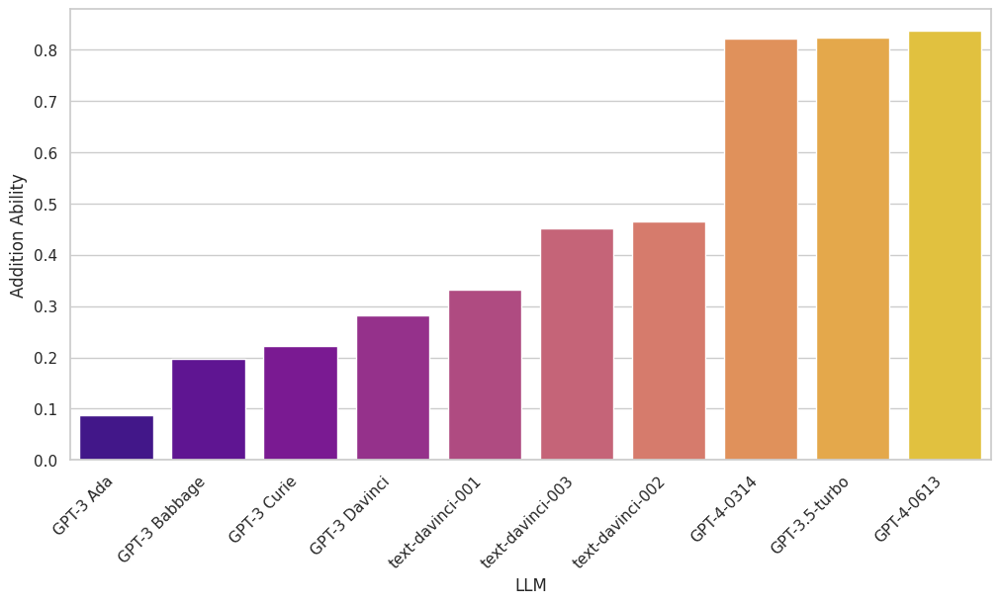

In [39]:
addition_ability = df.loc[df['Ability'] == 'additionAbility', ('LLM', 'Mean')]
addition_ability.rename(columns={'Mean': 'Addition Ability'}, inplace=True)
addition_ability_sorted = addition_ability.sort_values(by='Addition Ability', ascending=True)

plt.figure(figsize=(10,6))
ax = sns.barplot(x='LLM', y='Addition Ability', hue='LLM', data=addition_ability_sorted, palette='plasma', legend=False)
plt.xticks(rotation=45, ha="right")
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/addition_ability_plot.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

#### Compare predictive performance

In [6]:
#read scores if needed
predictive_methods_mes_lay_h_combined_df = pd.read_pickle("/content/drive/MyDrive/Colab Notebooks/Addition_data/predictive_methods_mes_lay_h.pkl")
predictive_methods_mes_lay_h_combined_df

,predictive_method,llm,BrierScore,Calibration,Refinement,AUROC,trained_method
0,LogisticRegression,GPT-3 Ada,0.004450,0.000004,0.004525,0.976662,LogisticRegression()
0,always_1,GPT-3 Ada,0.995455,0.000000,0.000000,0.500000,NaN
0,always_0,GPT-3 Ada,0.004545,0.000021,0.004525,0.500000,NaN
0,average_success_on_train,GPT-3 Ada,0.004528,0.000004,0.004525,0.500000,NaN
0,LogisticRegression,GPT-3 Babbage,0.006902,0.000093,0.007160,0.977252,LogisticRegression()
...,...,...,...,...,...,...,...
0,Measurement layout: hierarchical,text-davinci-002,0.062177,0.015762,0.046987,0.968309,NaN
0,Measurement layout: hierarchical,text-davinci-003,0.059667,0.011351,0.048137,0.961399,NaN
0,Measurement layout: hierarchical,GPT-4-0314,0.141325,0.005457,0.134905,0.849742,NaN
0,Measurement layout: hierarchical,GPT-3.5-turbo,0.134187,0.007795,0.127285,0.890549,NaN


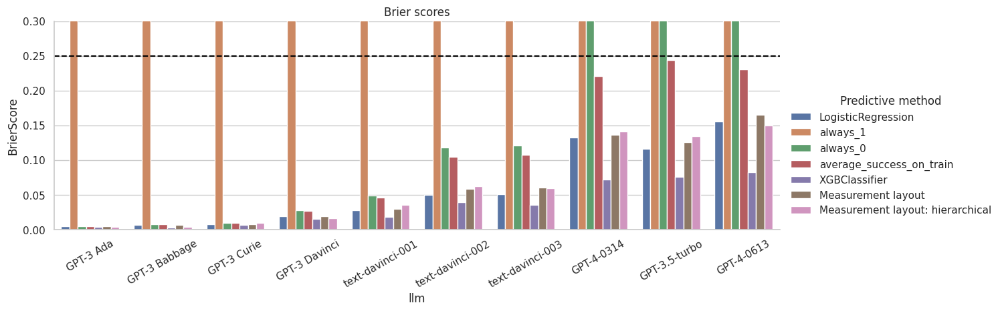

In [9]:
g = sns.catplot(x="llm", y="BrierScore", hue="predictive_method", data=predictive_methods_mes_lay_h_combined_df, kind="bar", height=4, aspect=3, legend_out=True)
plt.ylim(0, .3)
plt.axhline(y=0.25, color='black', linestyle='--')
plt.title("Brier scores")
plt.xticks(rotation=30)
g._legend.set_title('Predictive method')
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/brier_scores_assessors_mes_layout_h.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()

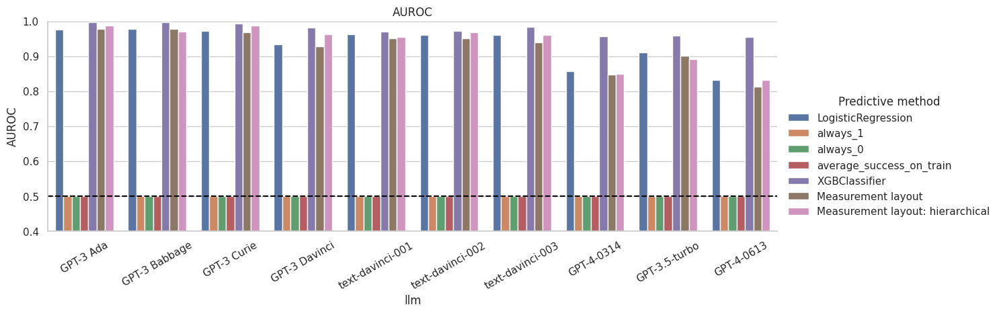

In [10]:
g = sns.catplot(x="llm", y="AUROC", hue="predictive_method", data=predictive_methods_mes_lay_h_combined_df, kind="bar", height=4, aspect=3,legend_out=True)
plt.ylim(0.4, 1)
plt.axhline(y=0.5, color='black', linestyle='--')
plt.title("AUROC")
plt.xticks(rotation=30)
g._legend.set_title('Predictive method')
filename = "/content/drive/MyDrive/Colab Notebooks/Addition_data/Plots/auroc_scores_assessors_mes_layout_h.png"
plt.savefig(filename, dpi=300, bbox_inches='tight')
plt.show()